In [1]:
!pip install scipy numpy matplotlib pandas sklearn

In [6]:

import pandas as pd
import numpy as np

In [7]:
# If the data is in .csv
mydata = pd.read_csv('/Users/anastasia/Dropbox/regression_so_samples_unique_ch_samples.csv')

In [4]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power_Fz-Cz,theta_power_Fz-Cz,alpha_power_Fz-Cz,beta_power_Fz-Cz,gamma_power_Fz-Cz,...,FC_LocalSimple_mean3_stderr_C4-M1,Entropy_Rate_CTW_C4-M1,Entropy_Rate_LZ_C4-M1,Aperiodic_component_C4-M1,"Monophasic_vertices_count,_C4-M1","Biphasic_vertices_count,_C4-M1","Sleep_spindles_count,_C4-M1","K_complex_count,_C4-M1",O-information,S-information
0,30.0,2,83,0,0,NaN,NaN,NaN,NaN,NaN,...,0.673599,0.632355,0.633995,1.320024,0.0,0.0,4.0,0.0,NaN,NaN
1,29.9,2,83,0,0,-5.271966,-5.894889,-5.960351,-6.085068,-7.059593,...,0.649219,0.666660,0.668451,1.172194,0.0,0.0,1.0,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,NaN,NaN,NaN,NaN,NaN,...,0.575386,0.611342,0.668451,1.441560,0.0,0.0,1.0,0.0,NaN,NaN
3,29.7,2,83,0,0,NaN,NaN,NaN,NaN,NaN,...,0.656781,0.633507,0.620213,1.361414,0.0,0.0,2.0,0.0,NaN,NaN
4,29.6,2,83,0,0,NaN,NaN,NaN,NaN,NaN,...,0.540575,0.571598,0.544409,1.346107,0.0,0.0,2.0,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175295,0.5,6811,79,1,1,NaN,NaN,NaN,NaN,NaN,...,0.265478,0.375247,0.296324,1.800981,0.0,0.0,1.0,0.0,NaN,NaN
175296,0.4,6811,79,1,1,NaN,NaN,NaN,NaN,NaN,...,0.386201,0.462920,0.427258,1.891022,0.0,0.0,0.0,0.0,-0.000735,0.254520
175297,0.3,6811,79,1,1,NaN,NaN,NaN,NaN,NaN,...,0.350036,0.369948,0.337671,1.897230,0.0,0.0,1.0,0.0,NaN,NaN
175298,0.2,6811,79,1,1,NaN,NaN,NaN,NaN,NaN,...,0.327602,0.452241,0.365236,1.785772,0.0,0.0,2.0,0.0,NaN,NaN


In [8]:
# Search for missing values
mydata.isnull().sum()



Label                                  0
Sbj_ID                                 0
Age                                    0
ifCleanOnset                           0
SleepStage                             0
                                   ...  
Biphasic_vertices_count,_C4-M1    126691
Sleep_spindles_count,_C4-M1       126691
K_complex_count,_C4-M1            126691
O-information                     137816
S-information                     137816
Length: 202, dtype: int64

In [9]:
# Delete the rows with the missing values

mydata = mydata.dropna()

mydata.isnull().sum()

Label                             0
Sbj_ID                            0
Age                               0
ifCleanOnset                      0
SleepStage                        0
                                 ..
Biphasic_vertices_count,_C4-M1    0
Sleep_spindles_count,_C4-M1       0
K_complex_count,_C4-M1            0
O-information                     0
S-information                     0
Length: 202, dtype: int64

In [10]:
# Find infinity values

mydata[mydata == np.inf].sum()


Label                             0.0
Sbj_ID                            0.0
Age                               0.0
ifCleanOnset                      0.0
SleepStage                        0.0
                                 ... 
Biphasic_vertices_count,_C4-M1    0.0
Sleep_spindles_count,_C4-M1       0.0
K_complex_count,_C4-M1            0.0
O-information                     0.0
S-information                     0.0
Length: 202, dtype: float64

In [8]:
# Find correlation between variables

mydata.corr()


,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power_Fz-Cz,theta_power_Fz-Cz,alpha_power_Fz-Cz,beta_power_Fz-Cz,gamma_power_Fz-Cz,...,FC_LocalSimple_mean3_stderr_C4-M1,Entropy_Rate_CTW_C4-M1,Entropy_Rate_LZ_C4-M1,Aperiodic_component_C4-M1,"Monophasic_vertices_count,_C4-M1","Biphasic_vertices_count,_C4-M1","Sleep_spindles_count,_C4-M1","K_complex_count,_C4-M1",O-information,S-information
Label,1.000000,0.072222,-0.067953,-0.066774,-0.293510,-0.037824,-0.049071,-0.045082,0.078903,0.196476,...,0.206538,0.213947,0.209560,-0.205610,NaN,NaN,0.077498,NaN,-0.006725,-0.074403
Sbj_ID,0.072222,1.000000,0.016569,-0.029529,-0.023684,-0.021107,0.001298,-0.025825,0.020649,0.030356,...,0.039762,0.031624,0.033763,-0.035623,NaN,NaN,0.006660,NaN,-0.015387,-0.029930
Age,-0.067953,0.016569,1.000000,-0.006953,0.025823,-0.092924,0.011470,0.082644,0.061422,-0.018385,...,0.021059,0.013399,0.019907,-0.009096,NaN,NaN,-0.038425,NaN,0.034538,-0.023743
ifCleanOnset,-0.066774,-0.029529,-0.006953,1.000000,-0.107864,-0.005312,0.062122,0.042631,0.070932,0.095390,...,0.059786,0.041903,0.043177,-0.035413,NaN,NaN,-0.002268,NaN,-0.013236,-0.092654
SleepStage,-0.293510,-0.023684,0.025823,-0.107864,1.000000,0.195257,0.069597,-0.083323,-0.168411,-0.197832,...,-0.236861,-0.232842,-0.227436,0.264367,NaN,NaN,-0.076497,NaN,0.025529,0.069643
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"Biphasic_vertices_count,_C4-M1",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"Sleep_spindles_count,_C4-M1",0.077498,0.006660,-0.038425,-0.002268,-0.076497,-0.050917,-0.137221,0.055328,0.162046,0.036639,...,0.134878,0.117955,0.109709,-0.099954,NaN,NaN,1.000000,NaN,0.032485,-0.041917
"K_complex_count,_C4-M1",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
O-information,-0.006725,-0.015387,0.034538,-0.013236,0.025529,-0.003818,-0.062921,-0.056951,-0.037752,-0.054902,...,-0.033105,-0.037943,-0.040263,0.014421,NaN,NaN,0.032485,NaN,1.000000,0.171085


In [9]:
# Find the most correlated variables

mydata.corr().unstack().sort_values().drop_duplicates()

CO_HistogramAMI_even_2_5_C4-M1     SB_MotifThree_quantile_hh_C4-M1              -0.959955
                                   Entropy_Rate_LZ_C4-M1                        -0.958465
FC_LocalSimple_mean3_stderr_C4-M1  CO_HistogramAMI_even_2_5_C4-M1               -0.956164
MD_hrv_classic_pnn40_C4-M1         CO_Embed2_Dist_tau_d_expfit_meandiff_C4-M1   -0.951443
FC_LocalSimple_mean3_stderr_Fz-Cz  CO_HistogramAMI_even_2_5_Fz-Cz               -0.945694
                                                                                   ...   
Phase_amplitude_coupling_TG_Fz-Cz  Phase_amplitude_coupling_DB_Fz-Cz             0.976441
Phase_amplitude_coupling_TG_Cz-Oz  Phase_amplitude_coupling_DB_Cz-Oz             0.979202
Phase_amplitude_coupling_TG_C4-M1  Phase_amplitude_coupling_DB_C4-M1             0.988844
Label                              Label                                         1.000000
                                   Monophasic_vertices_count,_Fz-Cz                   NaN
Length: 18

In [10]:
# Find the most correlated variables with the target variable (Label) but exclude the results that have NaN values and the results that are equal to 1

mydata.corr()['Label'].sort_values().dropna().drop_duplicates()

#mydata.corr()['Label'].sort_values()





SleepStage                                   -0.293510
Aperiodic_component_Fz-Cz                    -0.268350
Aperiodic_component_Cz-Oz                    -0.256359
Theta_to_alpha_ratio_C4-M1                   -0.218884
CO_Embed2_Dist_tau_d_expfit_meandiff_Cz-Oz   -0.218626
                                                ...   
Entropy_Rate_CTW_Cz-Oz                        0.223044
SB_MotifThree_quantile_hh_Fz-Cz               0.224318
MD_hrv_classic_pnn40_Cz-Oz                    0.225873
SB_MotifThree_quantile_hh_Cz-Oz               0.237501
Label                                         1.000000
Name: Label, Length: 193, dtype: float64

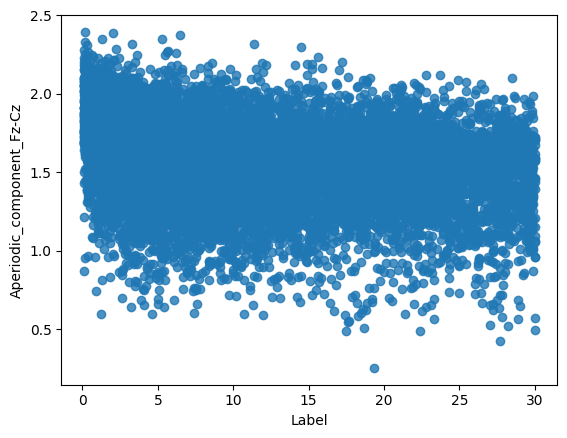

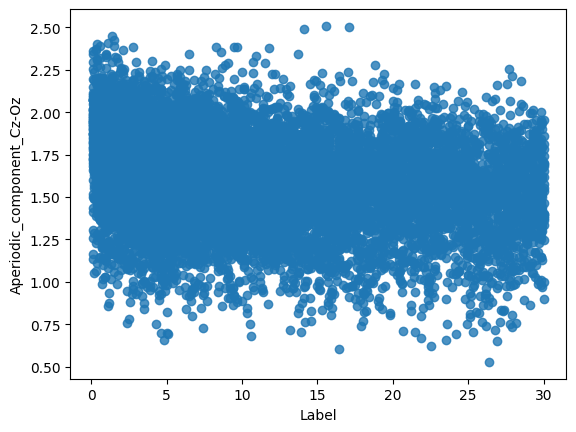

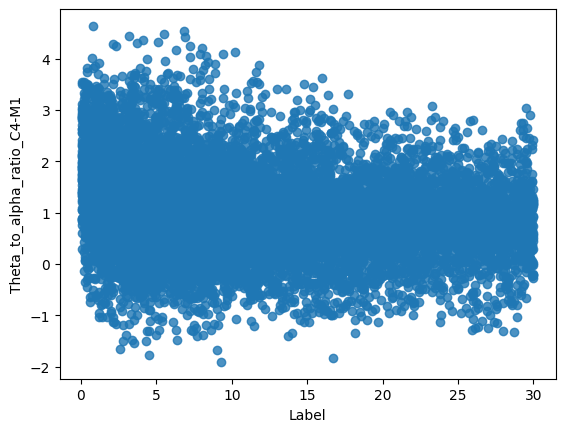

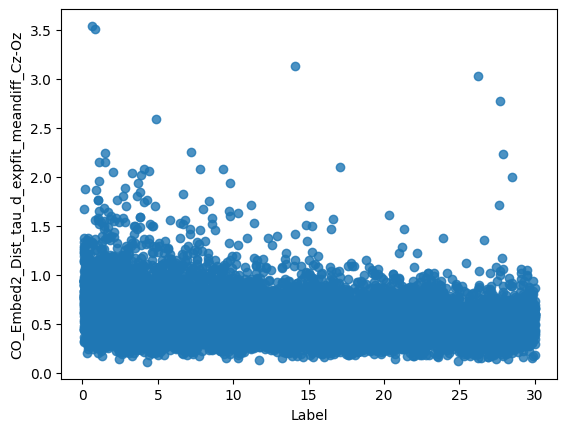

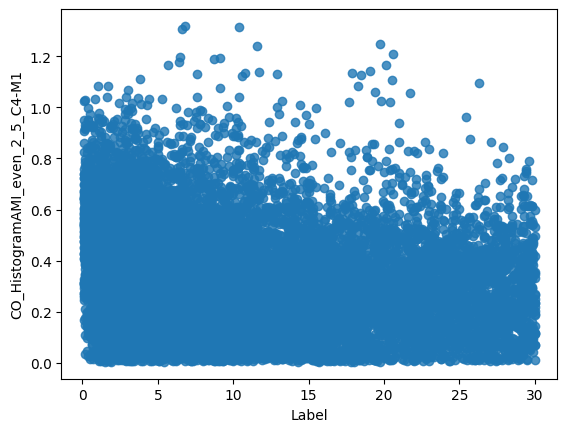

...

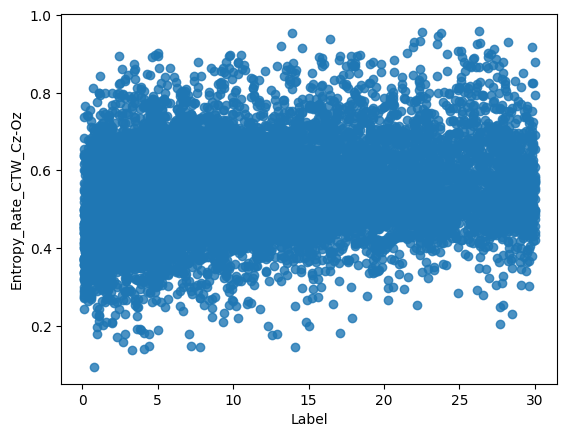

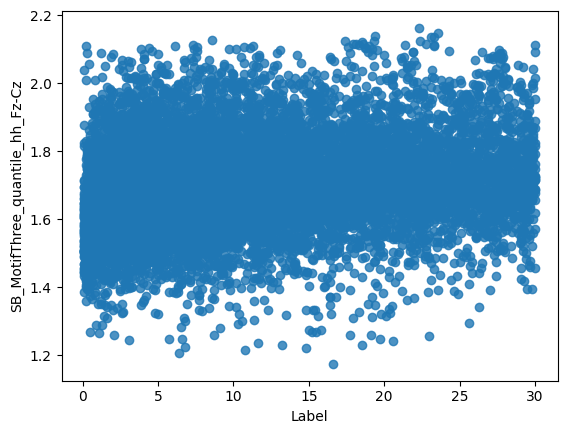

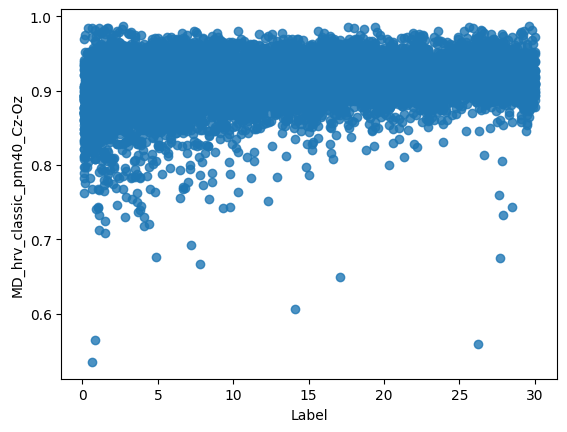

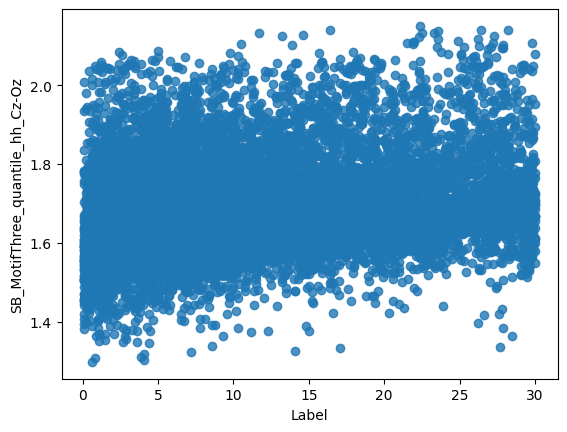

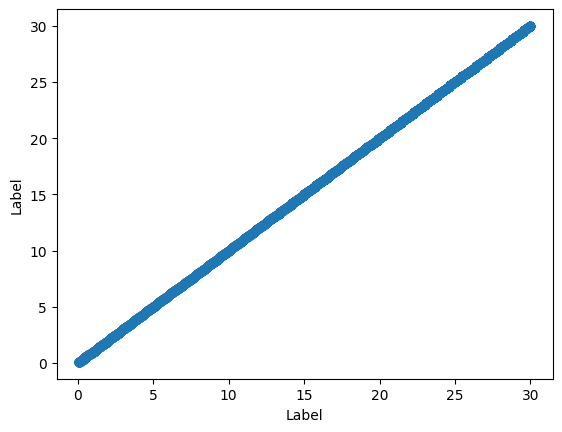

In [11]:
# Make plots the correlation between the Label and most correlated variables for each variable

import matplotlib.pyplot as plt
import seaborn as sns

for i in mydata.corr()['Label'].sort_values().dropna().drop_duplicates().index[1:]:
    sns.regplot(x= "Label", y=i, data=mydata)
    plt.show()

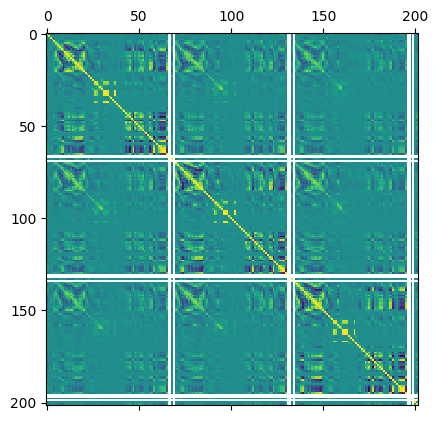

In [12]:
# Plot the correlation of variable with the target variable (Label)

import matplotlib.pyplot as plt

plt.matshow(mydata.corr())
plt.show()





In [13]:
!pip install seaborn

In [14]:
# Plot the correlation of top 20 correlated and anticorrelated variables with the target variable (Label)

import seaborn as sns

corr = mydata.corr()
corr_target = abs(corr["Label"])
relevant_features = corr_target[corr_target>0.15]
relevant_features.sort_values(ascending=False)

top_20 = relevant_features.sort_values(ascending=False).head(20)

top_20



Label                                         1.000000
SleepStage                                    0.293510
Aperiodic_component_Fz-Cz                     0.268350
Aperiodic_component_Cz-Oz                     0.256359
SB_MotifThree_quantile_hh_Cz-Oz               0.237501
MD_hrv_classic_pnn40_Cz-Oz                    0.225873
SB_MotifThree_quantile_hh_Fz-Cz               0.224318
Entropy_Rate_CTW_Cz-Oz                        0.223044
Entropy_Rate_LZ_Cz-Oz                         0.222812
Theta_to_alpha_ratio_C4-M1                    0.218884
CO_Embed2_Dist_tau_d_expfit_meandiff_Cz-Oz    0.218626
CO_HistogramAMI_even_2_5_C4-M1                0.215969
SB_MotifThree_quantile_hh_C4-M1               0.215206
Entropy_Rate_CTW_C4-M1                        0.213947
Entropy_Rate_LZ_C4-M1                         0.209560
CO_HistogramAMI_even_2_5_Cz-Oz                0.209049
Entropy_Rate_CTW_Fz-Cz                        0.208044
FC_LocalSimple_mean3_stderr_C4-M1             0.206538
Alpha_to_g

Sbj ID:  2


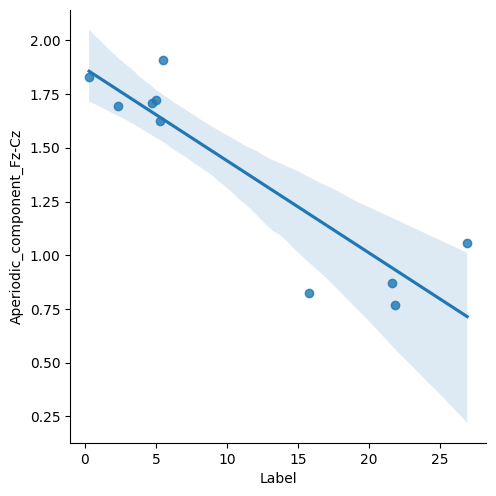

Sbj ID:  6


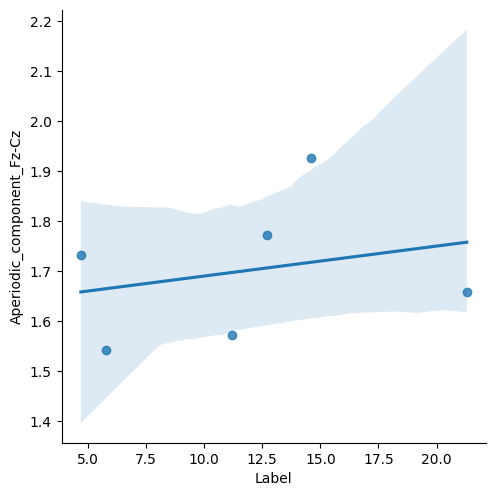

Sbj ID:  10


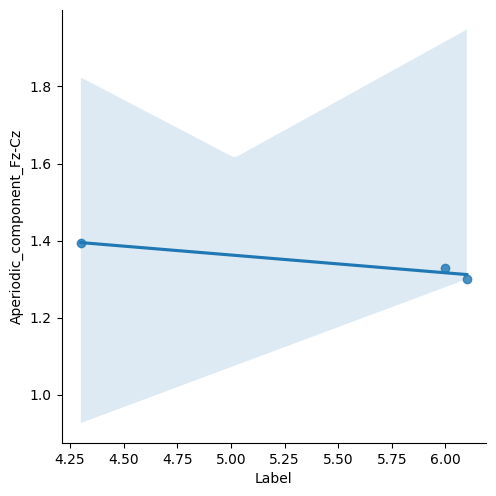

Sbj ID:  12


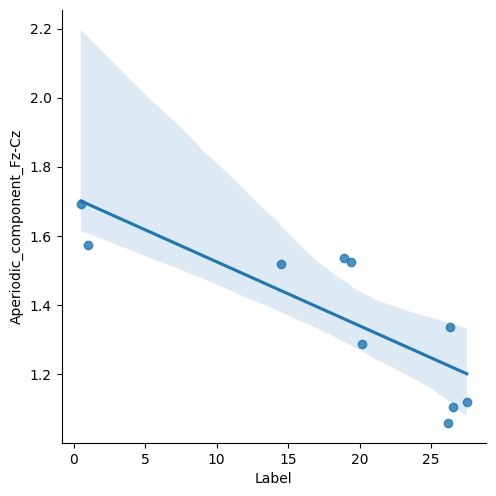

Sbj ID:  35


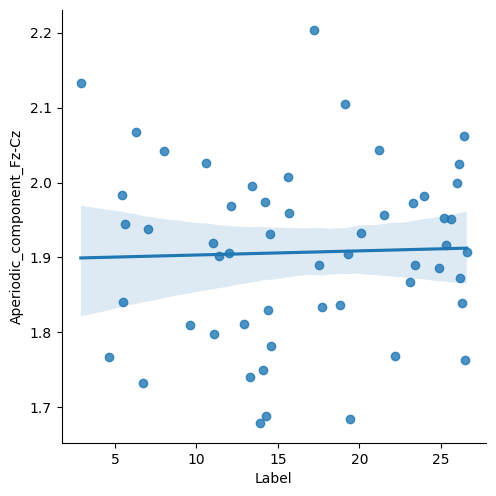

Sbj ID:  54


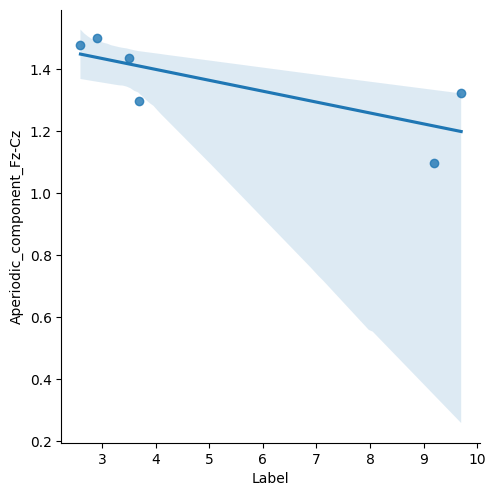

Sbj ID:  56


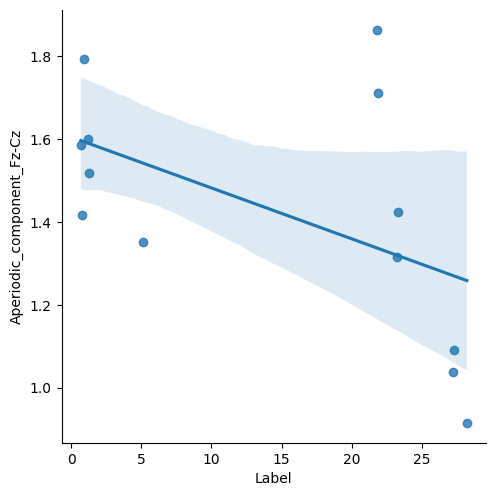

Sbj ID:  77


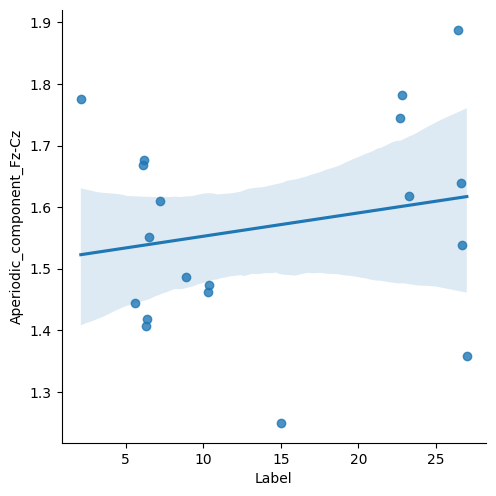

Sbj ID:  99


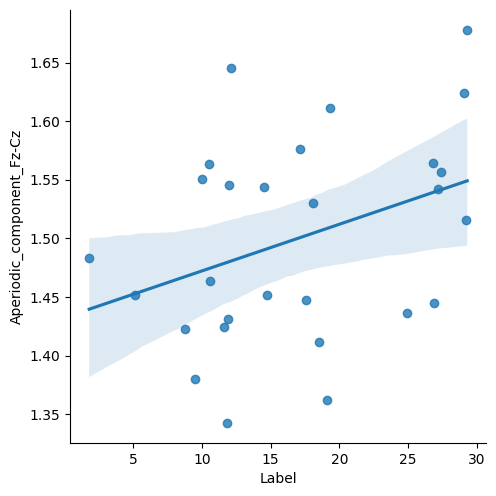

In [16]:
# For first 10 unique subject (Sbj_ID) show how each feature is changing with decreasing time to sleep onset (Label) for feature Aperiodic_component

import seaborn as sns
import matplotlib.pyplot as plt
counter = 0

for i in mydata['Sbj_ID'].unique():
    counter = counter + 1
    if counter < 10:
        print('Sbj ID: ', i)
        sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=['Aperiodic_component_Fz-Cz'], height=5, aspect=1, kind='reg')
        plt.show()
    else:
        continue

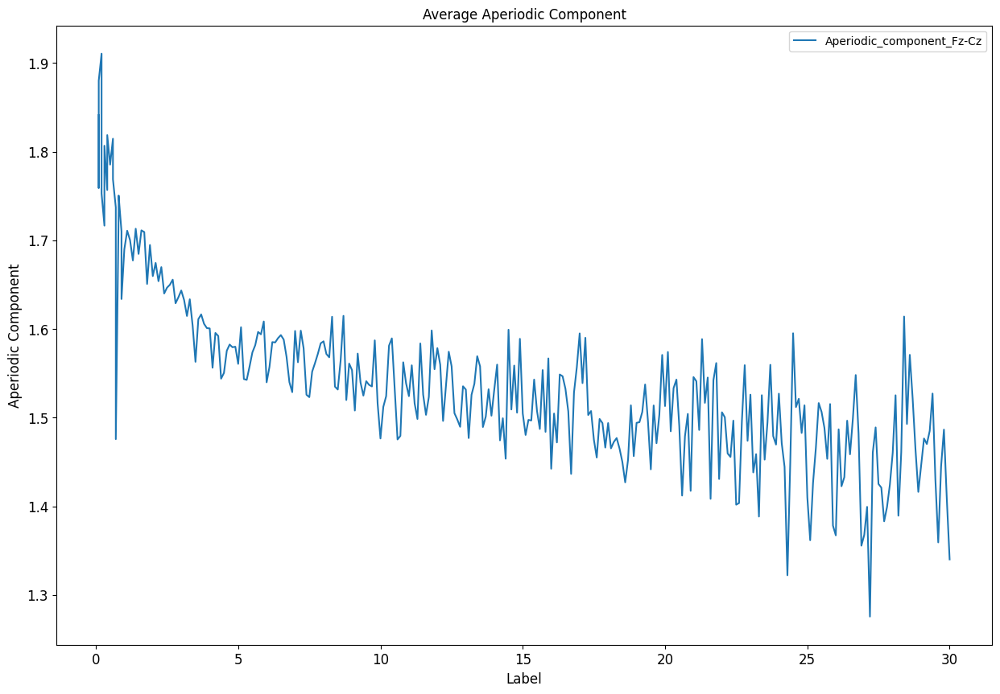

In [17]:
# Plot the how aperiodic component changes with decreasing time to sleep onset (Label), calculate the average for each timepoint (Label) and plot the average

average = mydata.groupby('Label')['Aperiodic_component_Fz-Cz'].mean()

plot = average.plot(title='Average Aperiodic Component', figsize=(15, 10), legend=True, fontsize=12)
plot.set_xlabel('Label', fontsize=12)
plot.set_ylabel('Aperiodic Component', fontsize=12)

plt.show()


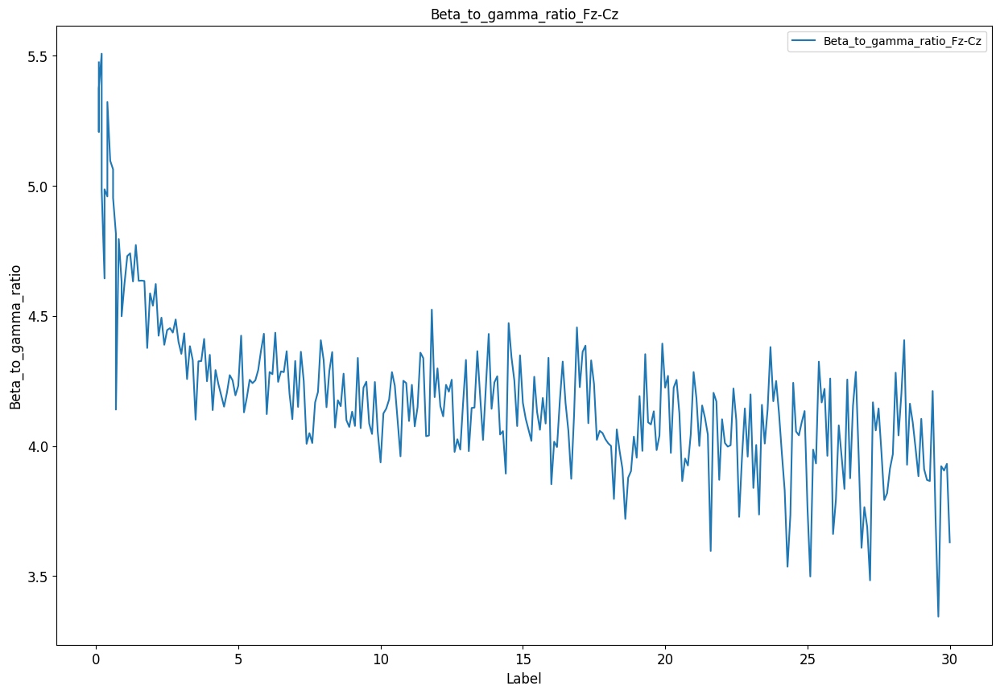

In [18]:
#Repeat the average plot for gamma power

average = mydata.groupby('Label')['Beta_to_gamma_ratio_Fz-Cz'].mean()

plot = average.plot(title='Beta_to_gamma_ratio_Fz-Cz', figsize=(15, 10), legend=True, fontsize=12)

plot.set_xlabel('Label', fontsize=12)

plot.set_ylabel('Beta_to_gamma_ratio', fontsize=12)

plt.show()



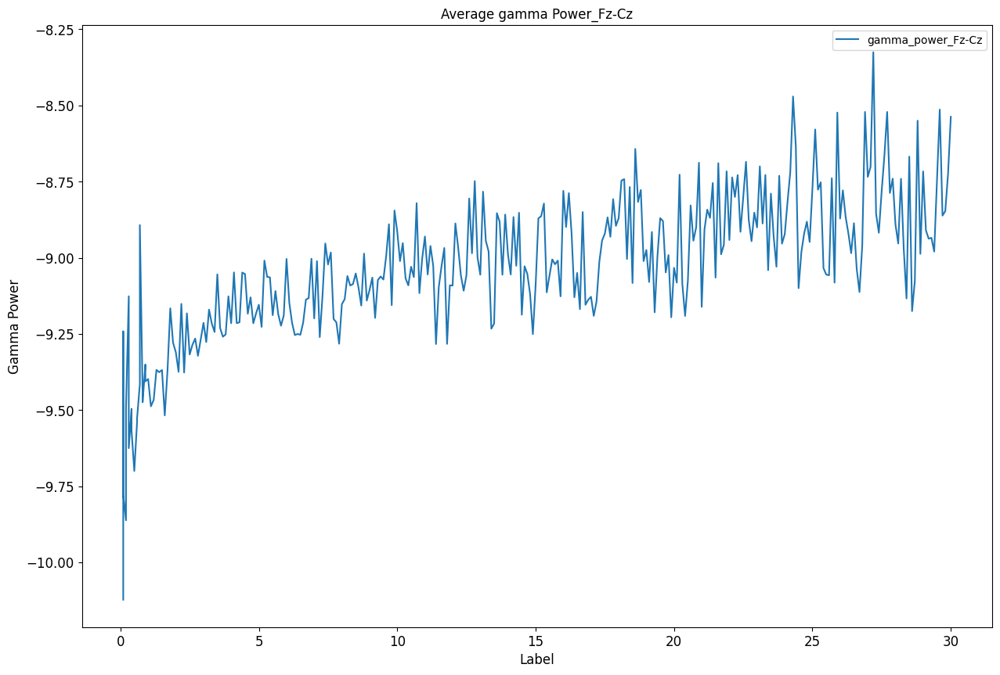

In [19]:
# Repeat the average plot for gamma power

average = mydata.groupby('Label')['gamma_power_Fz-Cz'].mean()

plot = average.plot(title='Average gamma Power_Fz-Cz', figsize=(15, 10), legend=True, fontsize=12)

plot.set_xlabel('Label', fontsize=12)

plot.set_ylabel('Gamma Power', fontsize=12)

plt.show()

Sbj ID:  2


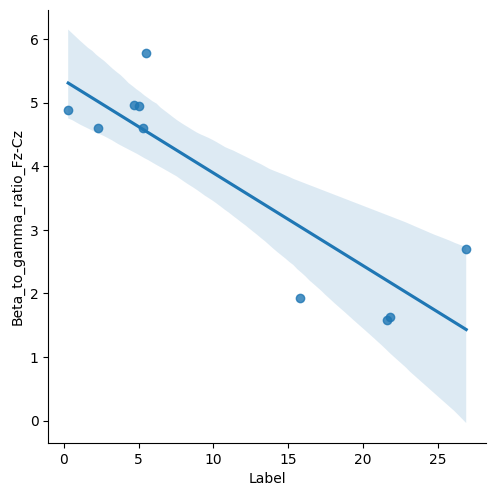

Sbj ID:  6


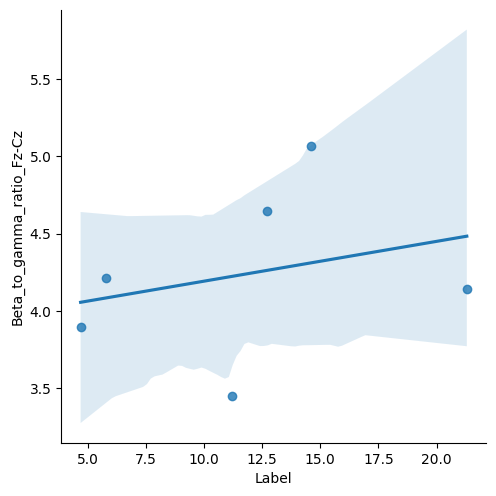

Sbj ID:  10


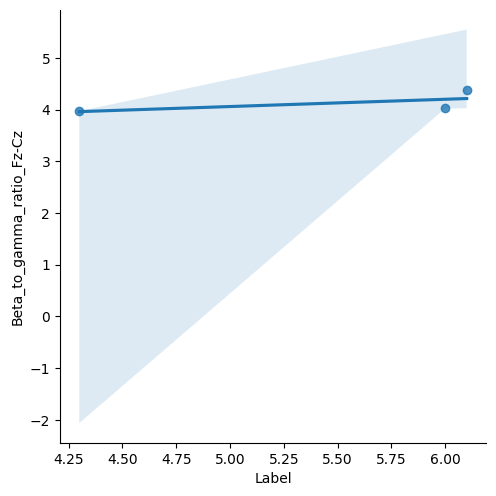

Sbj ID:  12


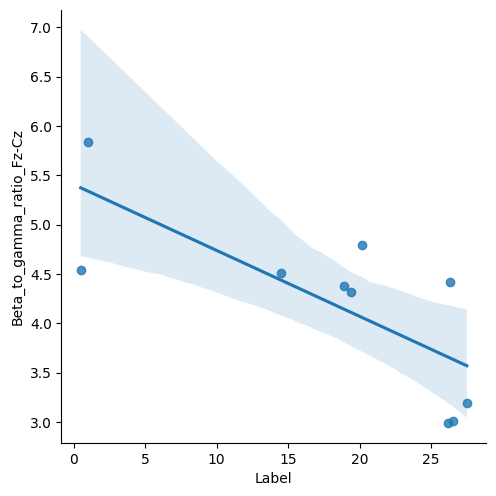

Sbj ID:  35


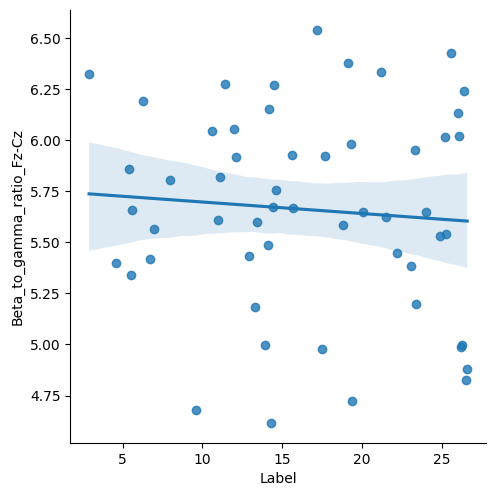

Sbj ID:  54


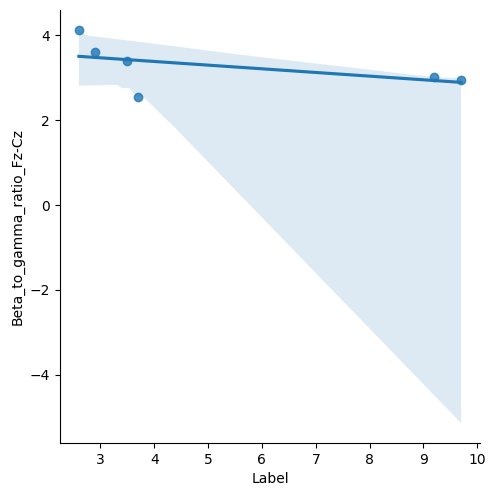

Sbj ID:  56


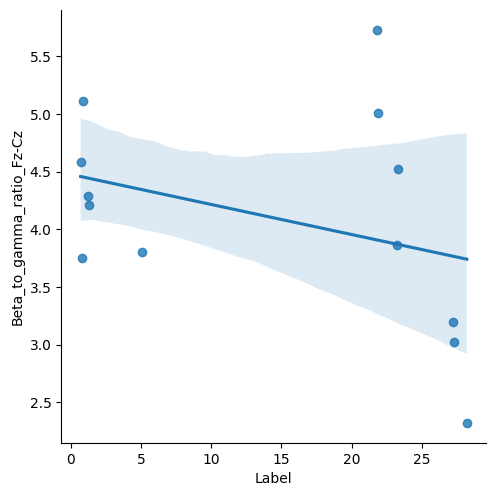

Sbj ID:  77


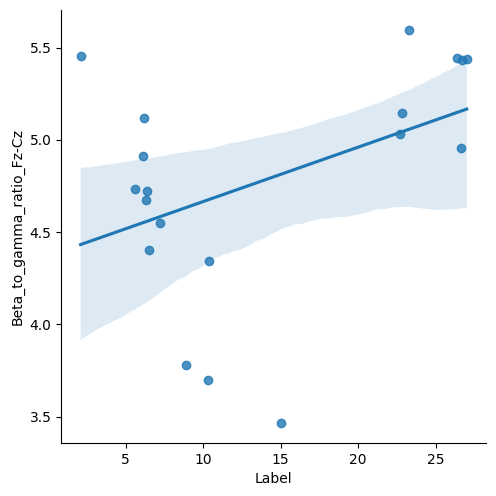

Sbj ID:  99


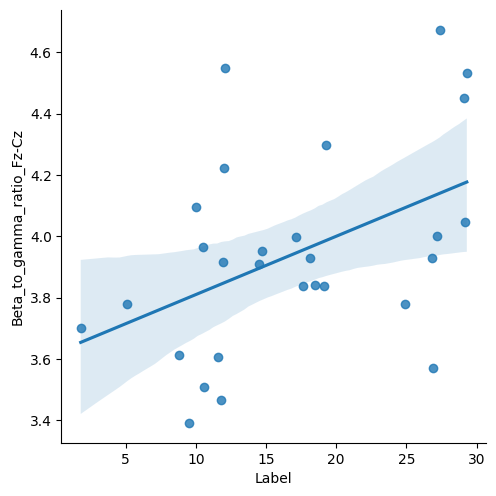

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt

counter = 0
for i in mydata['Sbj_ID'].unique():
    counter = counter + 1
    if counter < 10:
        print('Sbj ID: ', i)
        sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=['Beta_to_gamma_ratio_Fz-Cz'], height=5, aspect=1, kind='reg')
        plt.show()
    else:
        continue

Sbj ID:  2


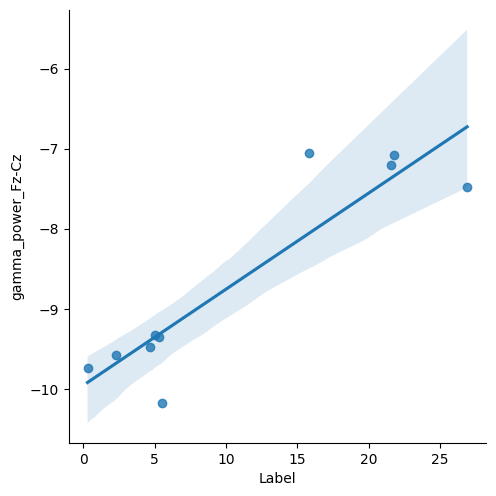

Sbj ID:  6


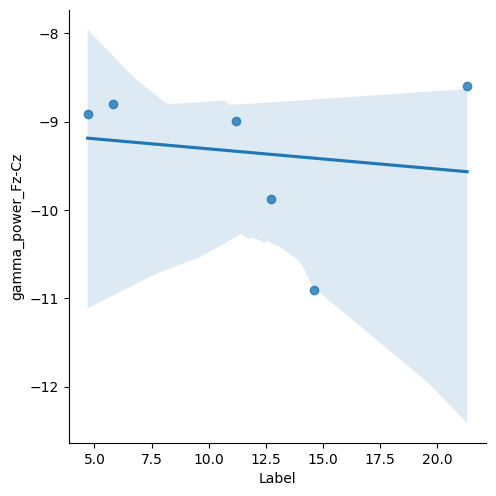

Sbj ID:  10


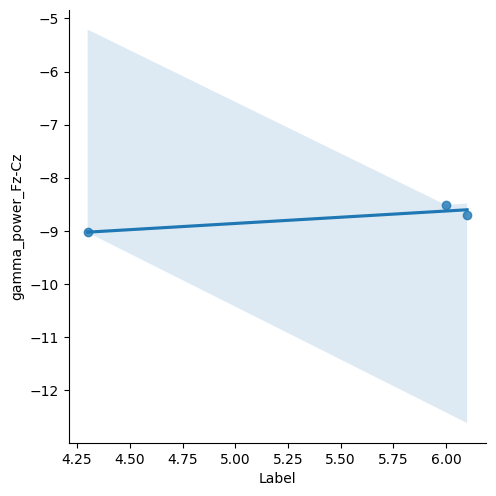

Sbj ID:  12


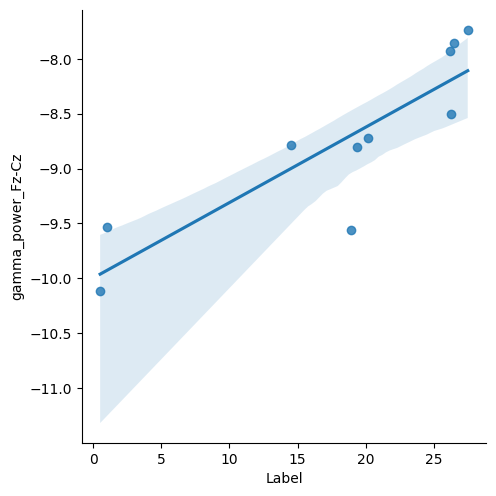

Sbj ID:  35


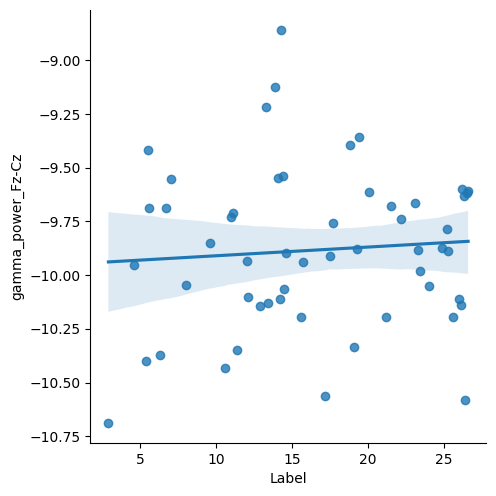

Sbj ID:  54


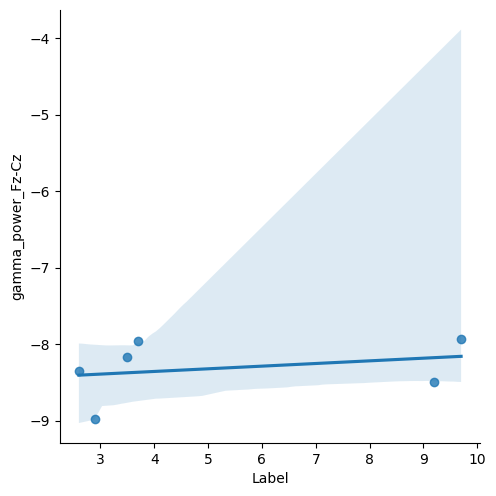

Sbj ID:  56


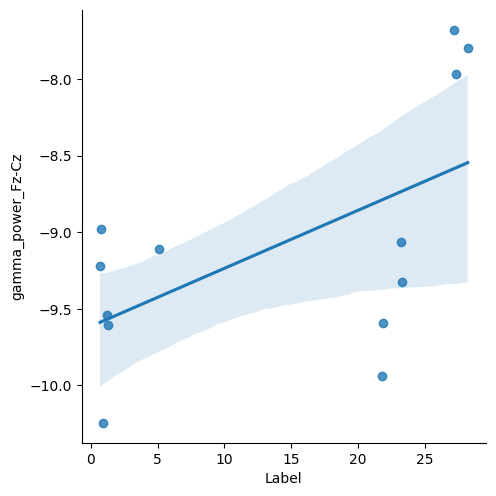

Sbj ID:  77


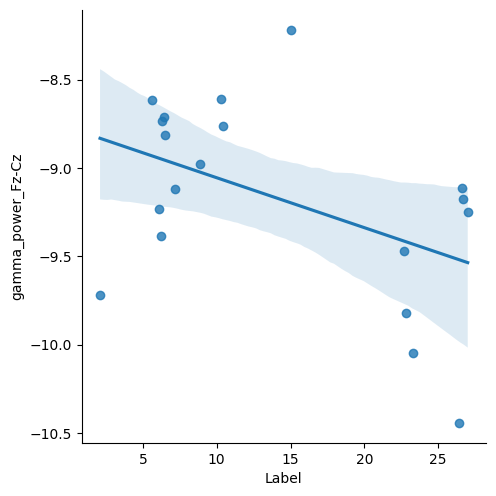

Sbj ID:  99


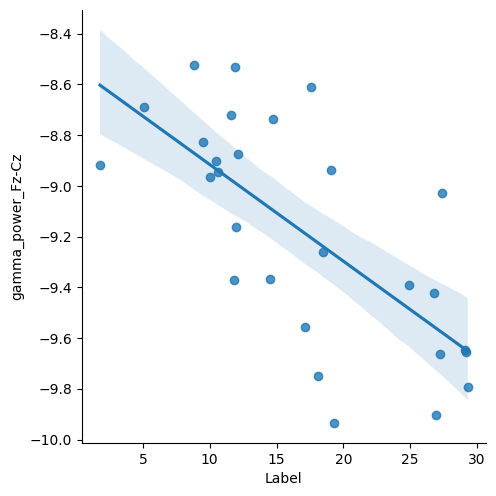

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

counter = 0
for i in mydata['Sbj_ID'].unique():
    counter = counter + 1
    if counter < 10:
        print('Sbj ID: ', i)
        sns.pairplot(mydata[mydata['Sbj_ID'] == i], x_vars=['Label'], y_vars=['gamma_power_Fz-Cz'], height=5, aspect=1, kind='reg')
        plt.show()
    else:
        continue

# Regression from single feature veactor of extracted EEG period 

In [22]:
import pandas as pd
import numpy as np
import sklearn
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict

## Random Forest on the whole dataset

In [33]:
# Create X and y from dataframes to use in scikit-learn (drop Label, DleepStage, Sbj_ID and ifCleanOnset columns)

X = mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y = mydata['Label']

# Split the data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

# Create a random forest Regressor

rf = RandomForestRegressor(n_estimators=300)
 
# Perform cross-validation and get the predictions

predictions_cv = cross_val_predict(rf, X_train, y_train, cv=10)



In [2]:
import matplotlib.pyplot as plt

# Create a function for plotting the sorted feature importances in a long horizontal bar chart and increased font size

def plot_feature_importances(model, X):
    importances = model.feature_importances_
    indices = np.argsort(importances)[::-1]
    names = [X.columns[i] for i in indices]
    fig, ax = plt.subplots(figsize=(16, 60), dpi=80)
    ax.barh(range(X.shape[1]), importances[indices], align='center')
    ax.set_yticks(range(X.shape[1]))
    ax.set_yticklabels(names, fontsize=16)
    ax.set_xlabel('Importance')
    ax.set_ylabel('Feature')
    ax.set_title('Feature importances')
    plt.show()

    return importances, indices, names

# Create a funciton for evaluating the performance of the model on the test data

def evaluate_performance_test(model, X_test, y_test):

    predictions = model.predict(X_test)

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_test - predictions
    plt.scatter(y_test, residuals)
    plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

# Create a function for evaluating the performance of the model on the training data given the predictions it produced

def evaluate_performance_train(model, X_train, y_train, predictions):
    
    errors = abs(y_train - predictions)
    mape = 100 * (errors / y_train)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_train, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_train, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))

    plt.plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=1)
    plt.scatter(y_train, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    residuals = y_train - predictions
    plt.scatter(y_train, residuals)
    plt.plot([y_train.min(), y_train.max()], [0, 0], 'k--', lw=1)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Residuals')
    plt.title('Actual vs Residuals')
    plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return errors, mape, accuracy, residuals, mse, rmse, r2

Mean Absolute Error: 5.59
Accuracy: -93.49 %.
Mean Squared Error: 47.32
Root Mean Squared Error: 6.88
R2: 0.27


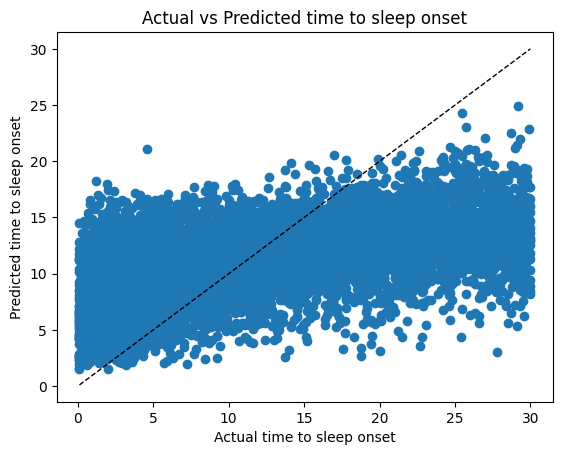

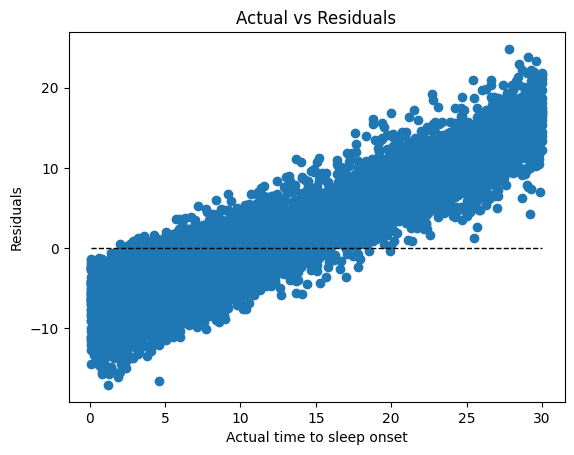

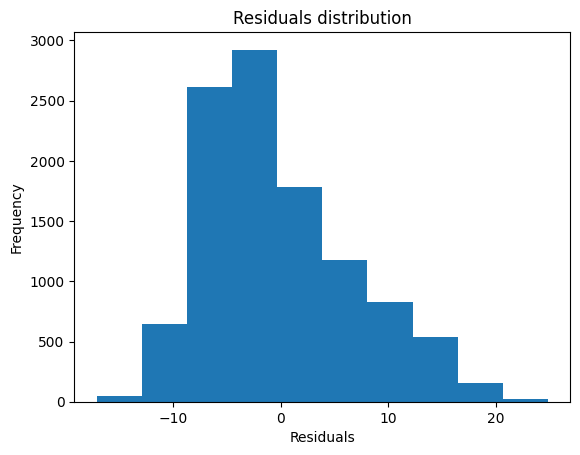

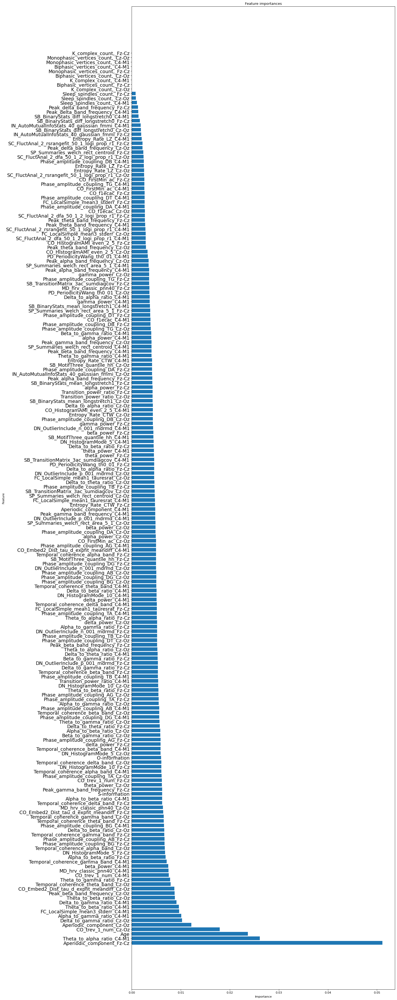

In [34]:
# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_train, y_train, predictions_cv)


# Plot the feature importances
rf.fit(X_train, y_train)
importances, indices, names = plot_feature_importances(rf, X_train)

Mean Absolute Error: 5.59
Accuracy: -89.58 %.
Mean Squared Error: 47.64
Root Mean Squared Error: 6.9
R2: 0.27


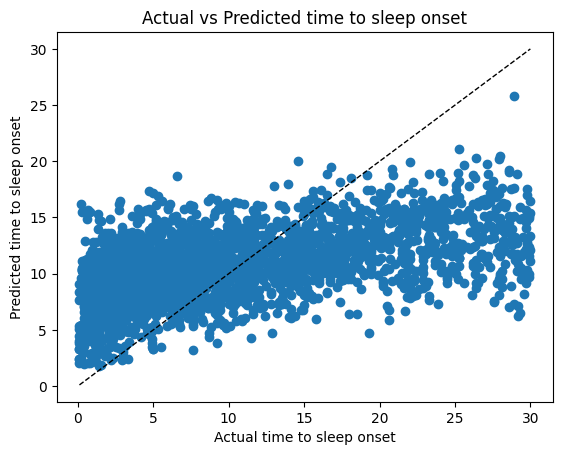

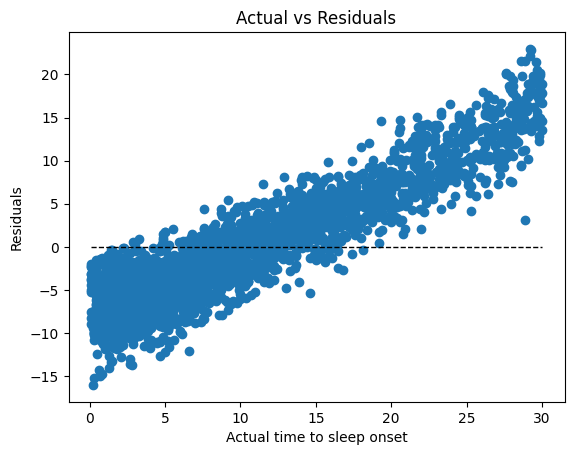

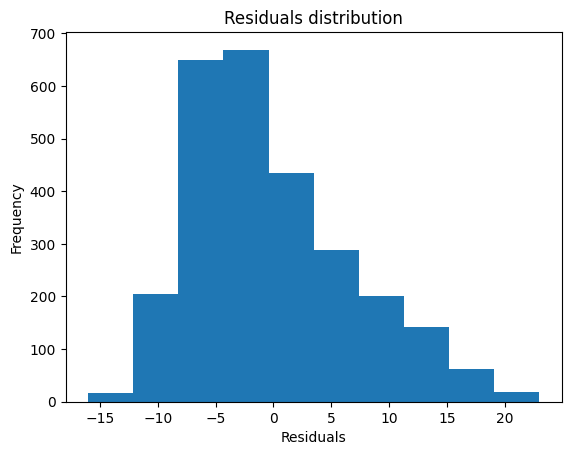

In [35]:
#Evaluate the performance of the model on the test data

predictions, errors, mape, accuracy, residuals,  = evaluate_performance_test(rf, X_test, y_test)



## Random forest only on clean sleep onsets (no intermittent single N2 epochs prior to sleep onset (2 consecutive epochs of N2)) ##

Mean Absolute Error: 5.55
Accuracy: -106.57 %.
Mean Squared Error: 47.73
Root Mean Squared Error: 6.91
R2: 0.27


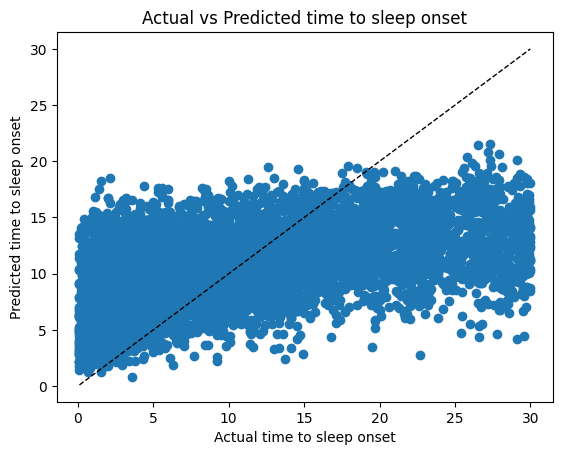

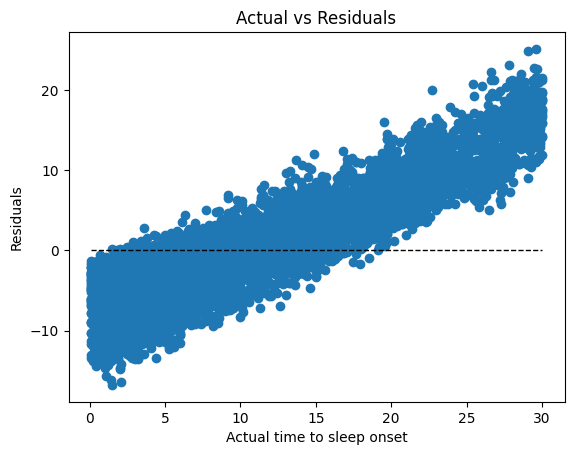

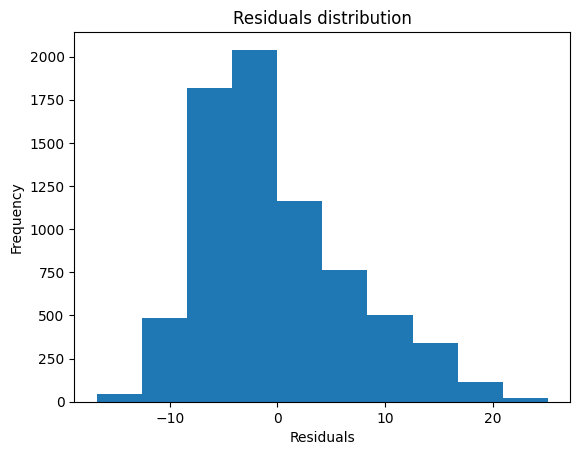

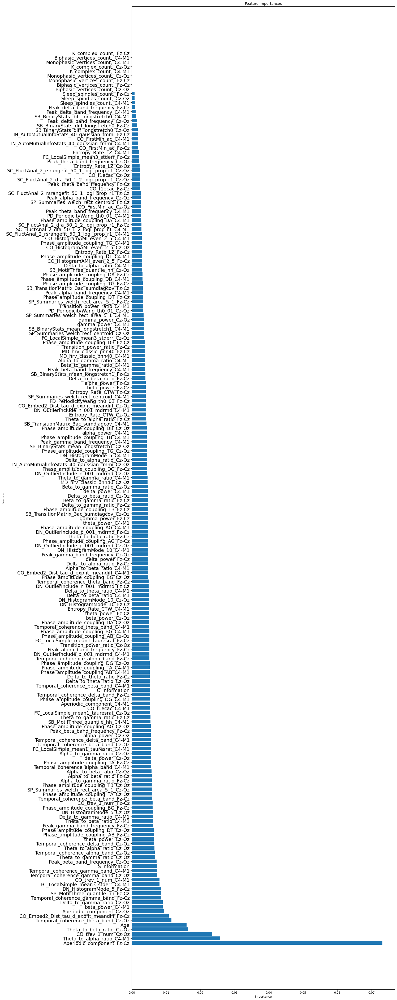

In [36]:
# Create a new dataset only with ifCleanOnset = 1

mydata_clean = mydata[mydata['ifCleanOnset'] == 1]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean = mydata_clean.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean = mydata_clean['Label']

# Split the data into training and testing sets

X_train_clean, X_test_clean, y_train_clean, y_test_clean = train_test_split(X_clean, y_clean, test_size=0.2)

# Create a random forest Regressor

rf_clean = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean = cross_val_predict(rf_clean, X_train_clean, y_train_clean, cv=10)

# evaluate the predictions made during cross-validation

errors_clean, mape_clean, accuracy_clean, residuals_clean, mse_clean, rmse_clean, r2_clean  = evaluate_performance_train(rf_clean, X_train_clean, y_train_clean, predictions_clean)

# Plot the feature importances
rf_clean.fit(X_train_clean, y_train_clean)

importances_clean, indices_clean, names_clean = plot_feature_importances(rf_clean, X_train_clean)




Mean Absolute Error: 5.59
Accuracy: -99.04 %.
Mean Squared Error: 48.26
Root Mean Squared Error: 6.95
R2: 0.27


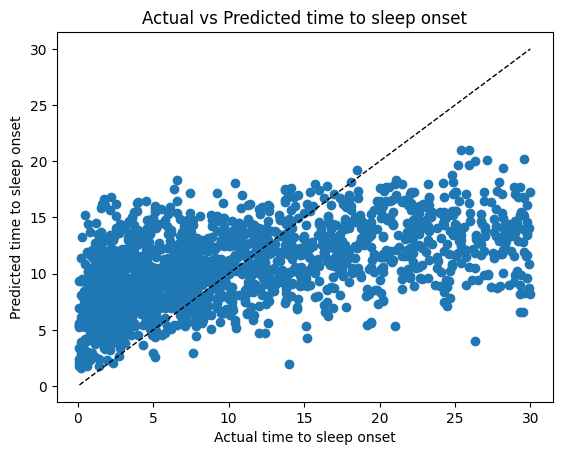

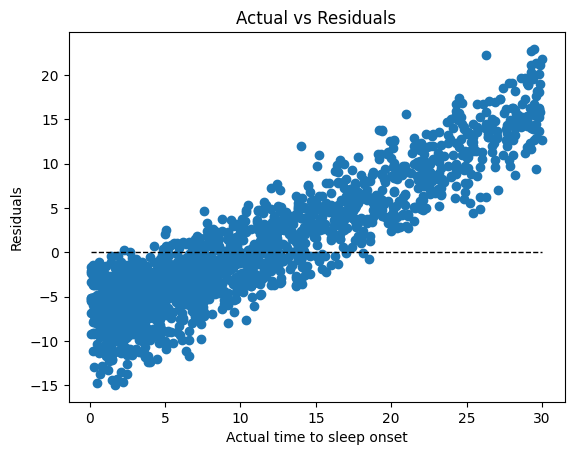

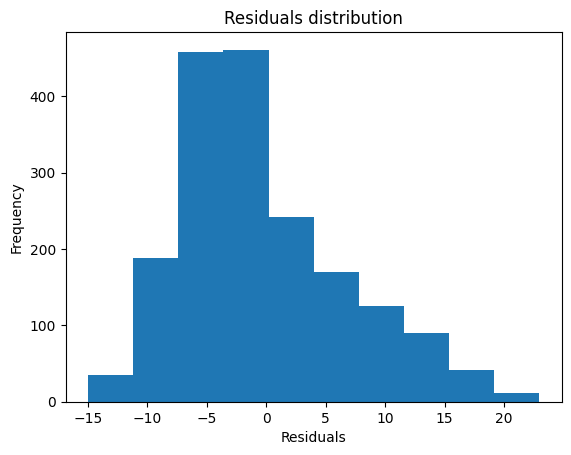

In [37]:
# Evaluate the performance of the model on the test data

predictions_clean, errors_clean, mape_clean, accuracy_clean, residuals_clean  = evaluate_performance_test(rf_clean, X_test_clean, y_test_clean)

## Random forest on **clean onset** and **15 minutes prior to sleep onset** (instead of 30 minutes) ##

Mean Absolute Error: 2.97
Accuracy: -52.24 %.
Mean Squared Error: 12.84
Root Mean Squared Error: 3.58
R2: 0.24


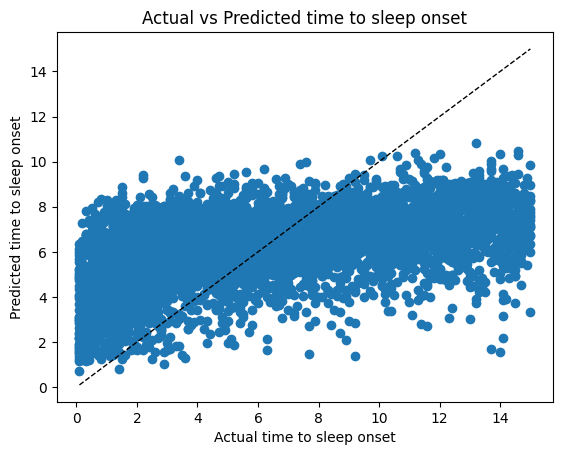

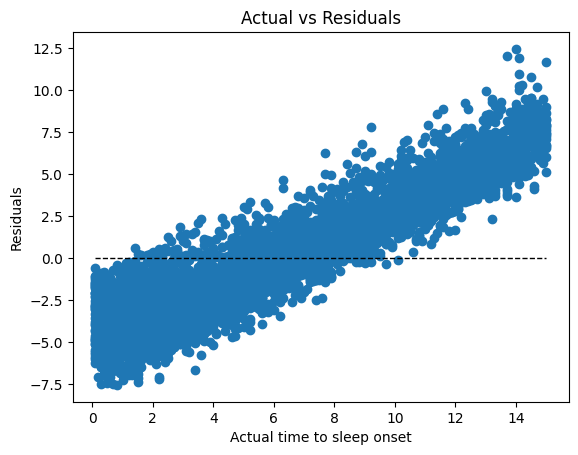

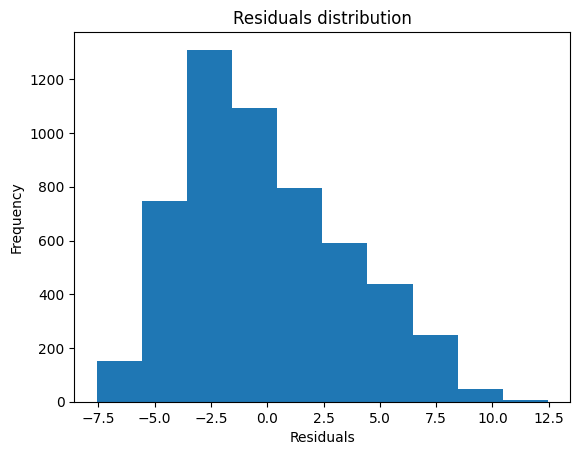

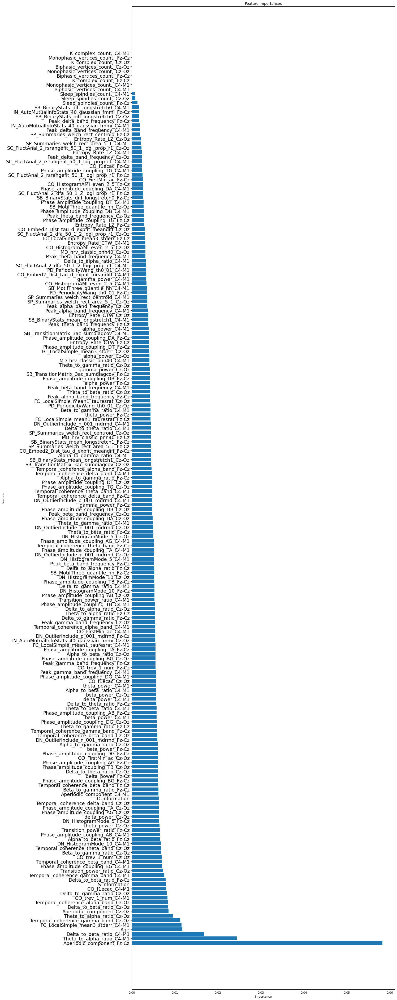

In [38]:
# Look at the clean onset (ifCleanOnset = 1) data and no longer than 15 minutes before the onset (Label <=15)

mydata_clean_15 = mydata_clean[mydata_clean['Label'] <= 15]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean_15 = mydata_clean_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean_15 = mydata_clean_15['Label']

# Split the data into training and testing sets

X_train_clean_15, X_test_clean_15, y_train_clean_15, y_test_clean_15 = train_test_split(X_clean_15, y_clean_15, test_size=0.2)

# Create a random forest Regressor

rf_clean_15 = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_15 = cross_val_predict(rf_clean_15, X_train_clean_15, y_train_clean_15, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_15, mape_clean_15, accuracy_clean_15, residuals_clean_15, mse_clean_15, rmse_clean_15, r2_clean_15 = evaluate_performance_train(rf_clean_15, X_train_clean_15, y_train_clean_15, predictions_clean_15)

# Plot the feature importances

rf_clean_15.fit(X_train_clean_15, y_train_clean_15)

importances_clean_15, indices_clean_15, names_clean_15 = plot_feature_importances(rf_clean_15, X_train_clean_15)




Mean Absolute Error: 3.04
Accuracy: -46.68 %.
Mean Squared Error: 13.16
Root Mean Squared Error: 3.63
R2: 0.24


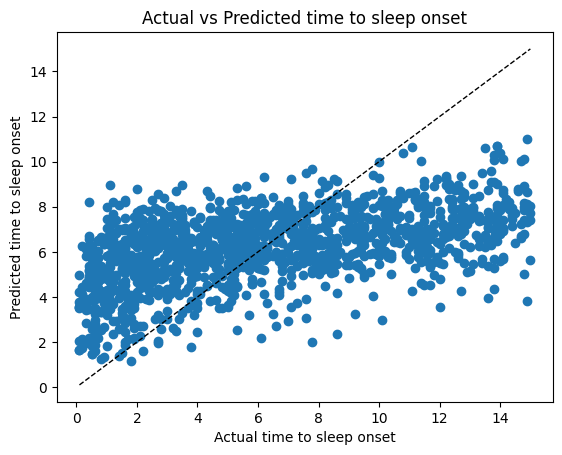

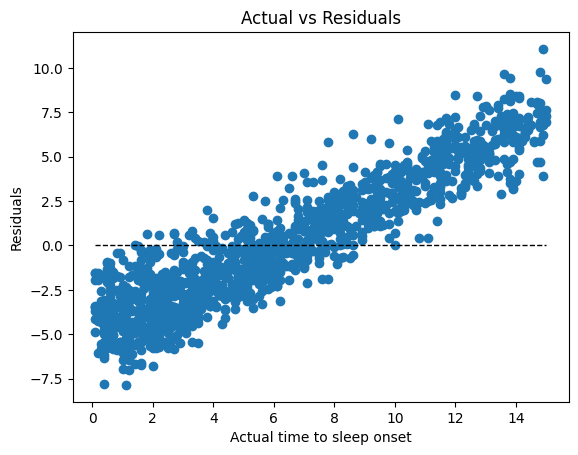

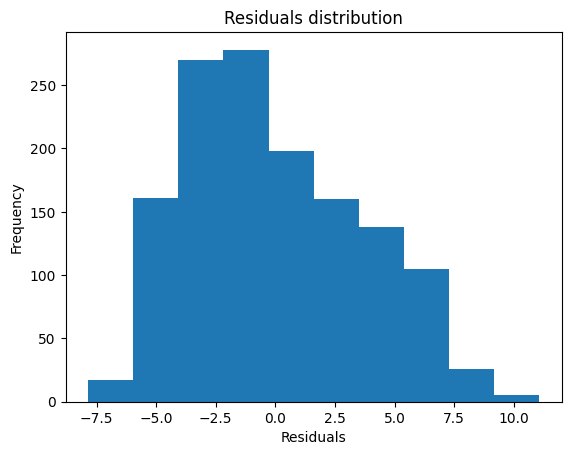

In [39]:
# Evaluate the performance of the model on the test data

predictions_clean_15, errors_clean_15, mape_clean_15, accuracy_clean_15, residuals_clean_15  = evaluate_performance_test(rf_clean_15, X_test_clean_15, y_test_clean_15)

Mean Absolute Error: 2.05
Accuracy: -38.96 %.
Mean Squared Error: 6.05
Root Mean Squared Error: 2.46
R2: 0.21


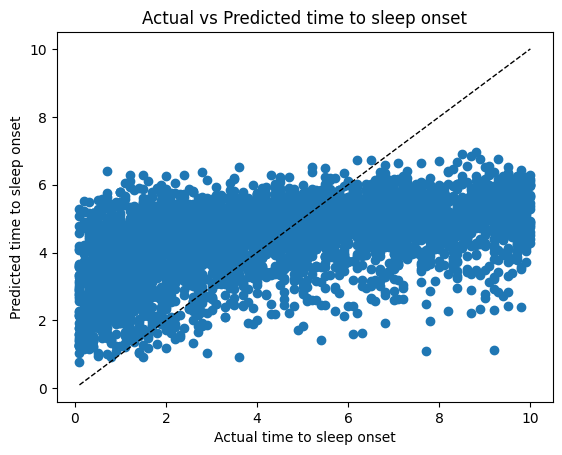

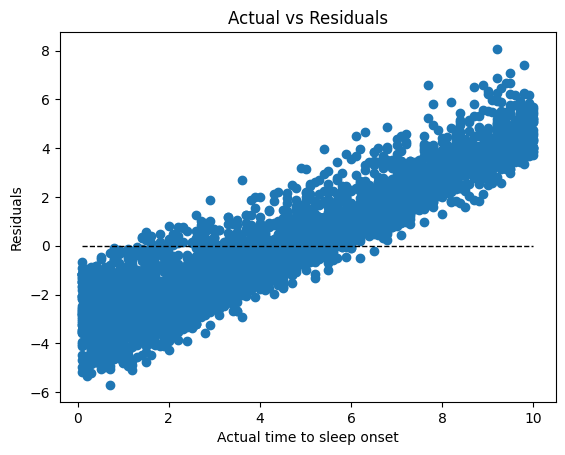

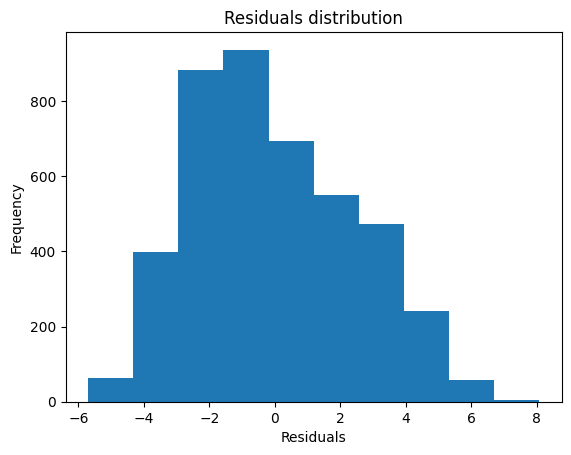

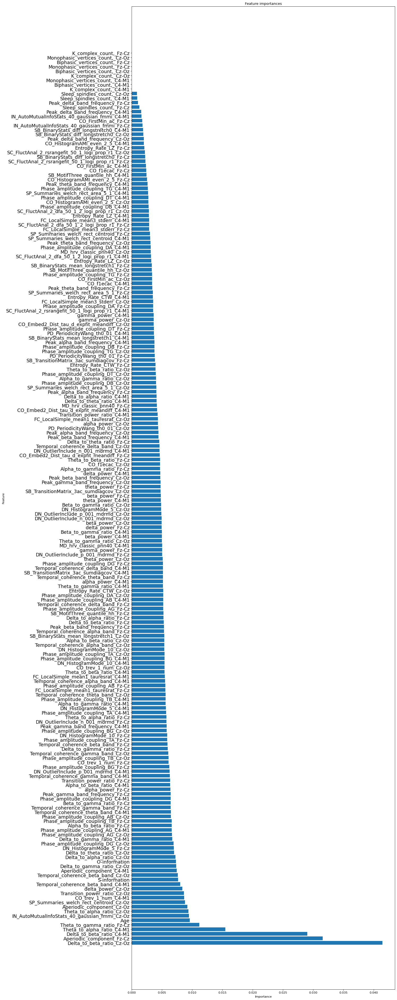

In [40]:

# Look at the clean onset (ifCleanOnset = 1) data and no longer than 10 minutes before the onset (Label <=10)

mydata_clean_10 = mydata_clean[mydata_clean['Label'] <= 10]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean_10 = mydata_clean_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean_10 = mydata_clean_10['Label']

# Split the data into training and testing sets

X_train_clean_10, X_test_clean_10, y_train_clean_10, y_test_clean_10 = train_test_split(X_clean_10, y_clean_10, test_size=0.2)

# Create a random forest Regressor

rf_clean_10 = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_10 = cross_val_predict(rf_clean_10, X_train_clean_10, y_train_clean_10, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_10, mape_clean_10, accuracy_clean_10, residuals_clean_10, mse_clean_10, rmse_clean_10, r2_clean_10 = evaluate_performance_train(rf_clean_10, X_train_clean_10, y_train_clean_10, predictions_clean_10)

# Plot the feature importances

rf_clean_10.fit(X_train_clean_10, y_train_clean_10)

importances_clean_10, indices_clean_10, names_clean_10 = plot_feature_importances(rf_clean_10, X_train_clean_10)




Mean Absolute Error: 1.96
Accuracy: -5.51 %.
Mean Squared Error: 5.69
Root Mean Squared Error: 2.38
R2: 0.22


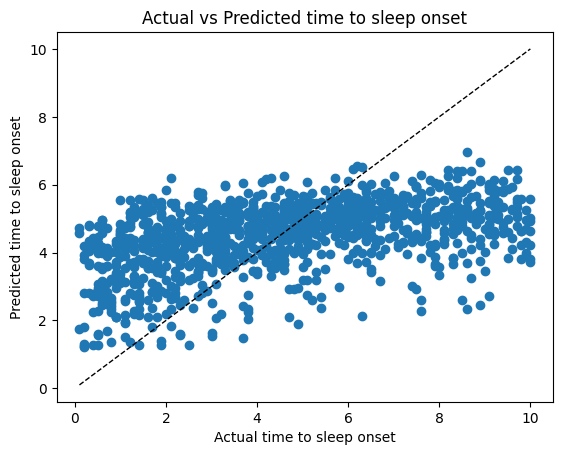

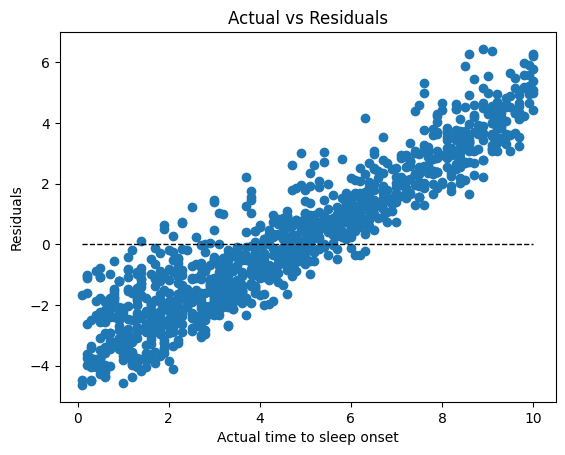

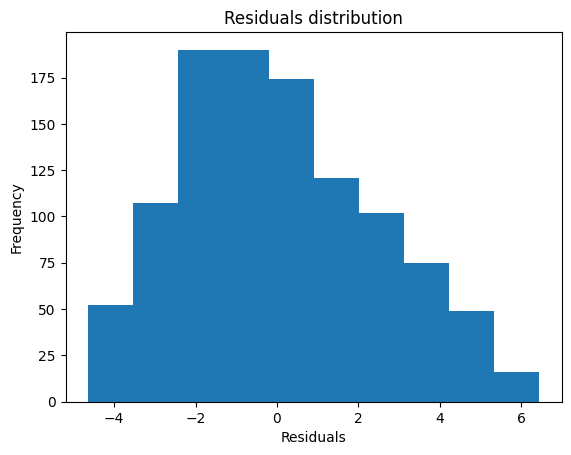

In [41]:
# Evaluate the performance of the model on the test data

predictions_clean_10, errors_clean_10, mape_clean_10, accuracy_clean_10, residuals_clean_10  = evaluate_performance_test(rf_clean_10, X_test_clean_10, y_test_clean_10)

## Random forest on **clean onset** and **30-15 minutes prior to sleep onset** ##

Mean Absolute Error: 3.54
Accuracy: 83.16 %.
Mean Squared Error: 17.39
Root Mean Squared Error: 4.17
R2: 0.1


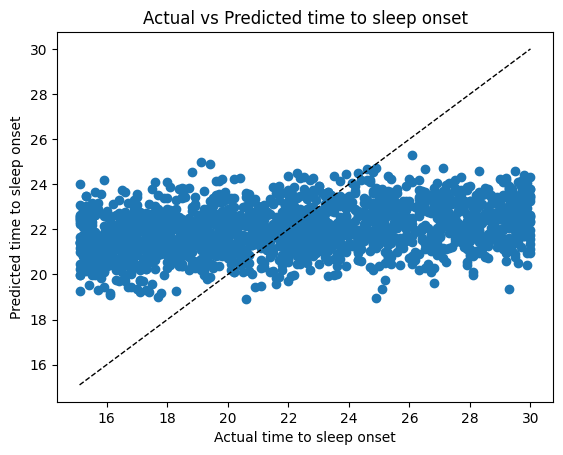

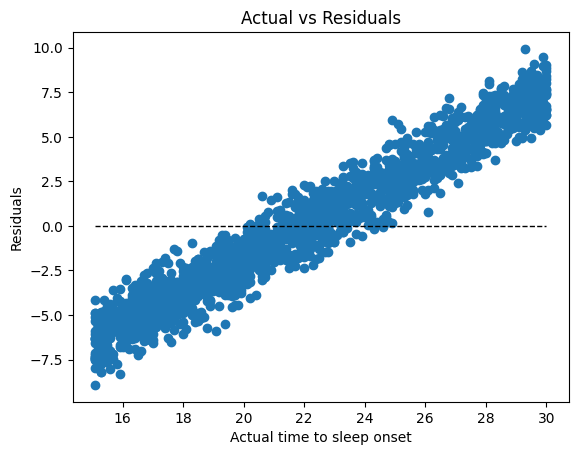

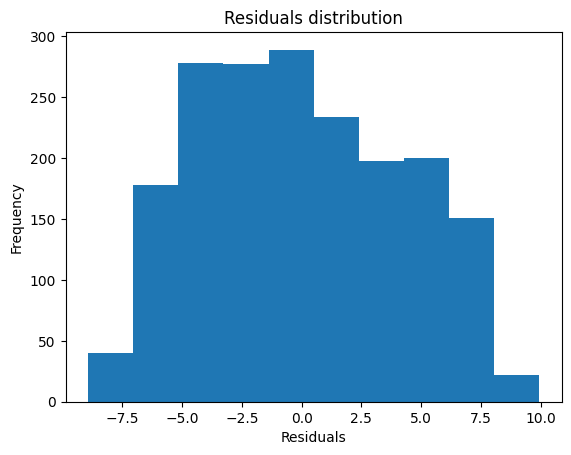

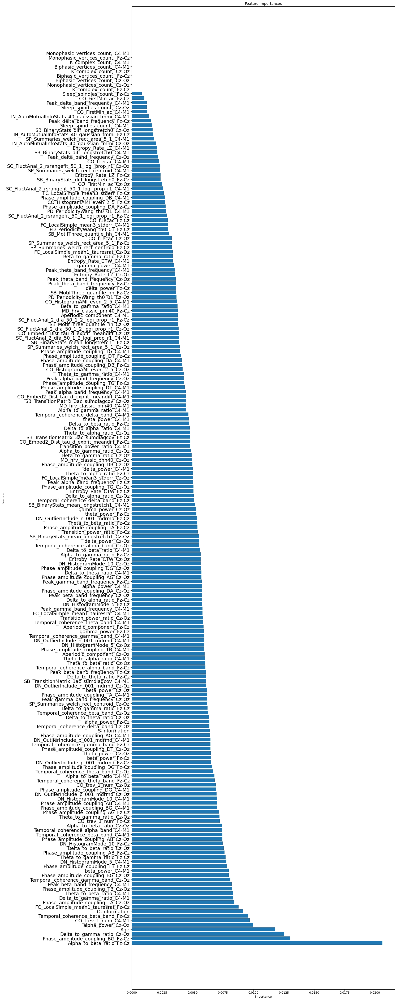

In [42]:
# Repeat the same for ifCleanOnset = 1 and Label > 15

mydata_clean_15_1 = mydata_clean[mydata_clean['Label'] > 15]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_clean_15_1 = mydata_clean_15_1.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_clean_15_1 = mydata_clean_15_1['Label']

# Split the data into training and testing sets

X_train_clean_15_1, X_test_clean_15_1, y_train_clean_15_1, y_test_clean_15_1 = train_test_split(X_clean_15_1, y_clean_15_1, test_size=0.2)

# Create a random forest Regressor

rf_clean_15_1 = RandomForestRegressor(n_estimators=100)

# Perform cross-validation and get the predictions

predictions_clean_15_1 = cross_val_predict(rf_clean_15_1, X_train_clean_15_1, y_train_clean_15_1, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_15_1, mape_clean_15_1, accuracy_clean_15_1, residuals_clean_15_1, mse_clean_15_1, rmse_clean_15_1, r2_clean_15_1 = evaluate_performance_train(rf_clean_15_1, X_train_clean_15_1, y_train_clean_15_1, predictions_clean_15_1)

# Plot the feature importances

rf_clean_15_1.fit(X_train_clean_15_1, y_train_clean_15_1)

importances_clean_15_1, indices_clean_15_1, names_clean_15_1 = plot_feature_importances(rf_clean_15_1, X_train_clean_15_1)



Mean Absolute Error: 3.59
Accuracy: 82.9 %.
Mean Squared Error: 17.31
Root Mean Squared Error: 4.16
R2: 0.04


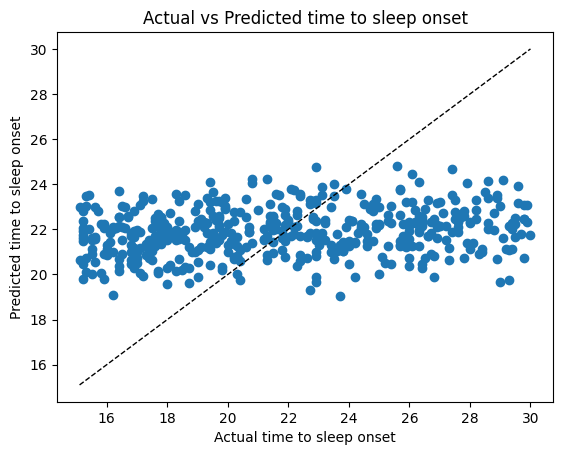

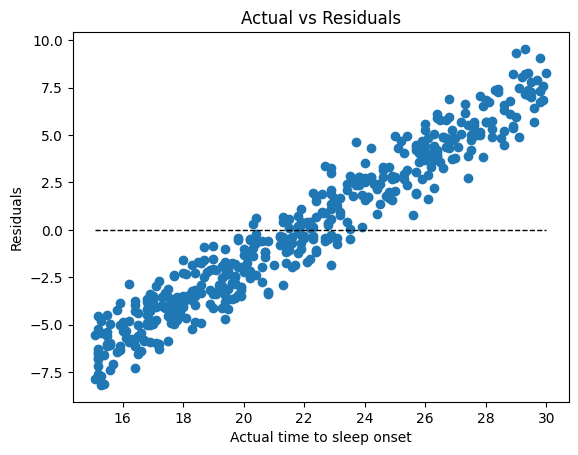

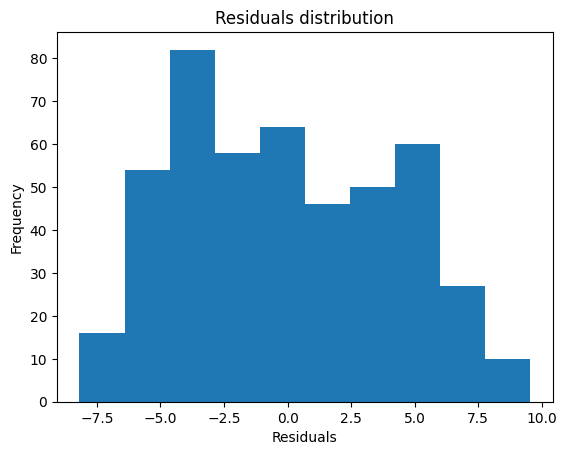

In [43]:
# Evaluate the performance of the model on the test data

predictions_clean_15_1, errors_clean_15_1, mape_clean_15_1, accuracy_clean_15_1, residuals_clean_15_1  = evaluate_performance_test(rf_clean_15_1, X_test_clean_15_1, y_test_clean_15_1)

## Random Forest: Performing analysis to predict test subjects from train subjects ##

In [44]:
# Identify how many unique subjects are in the dataset

mydata['Sbj_ID'].nunique()


662

In [45]:
# Identify how many unique subjects are in the dataset with clean onset

mydata_clean['Sbj_ID'].nunique()

489

In [46]:
import random
from sklearn.utils import shuffle

Mean Absolute Error: 5.95
Accuracy: -153.59 %.
Mean Squared Error: 50.76
Root Mean Squared Error: 7.12
R2: 0.12


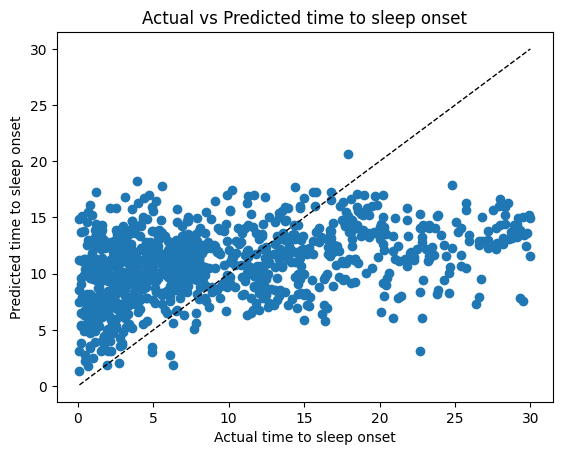

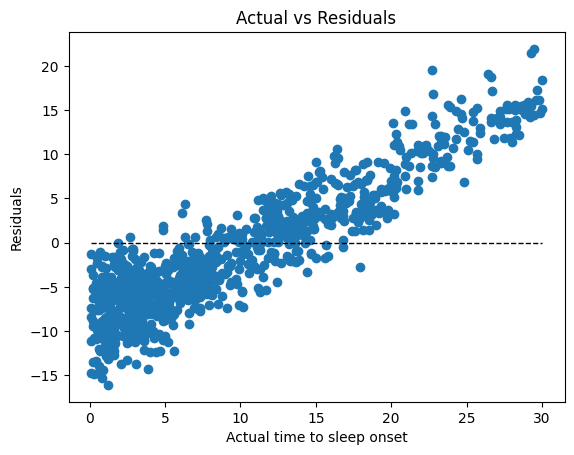

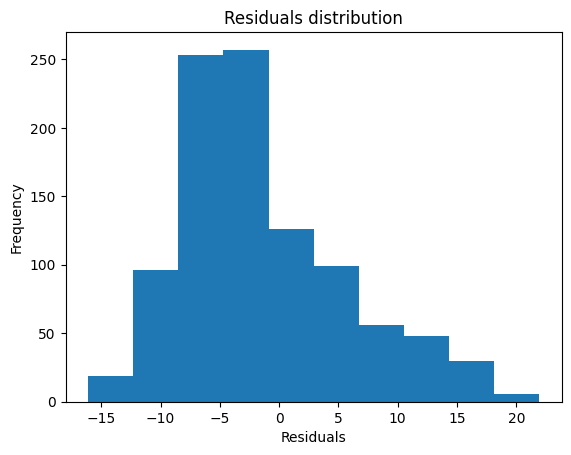

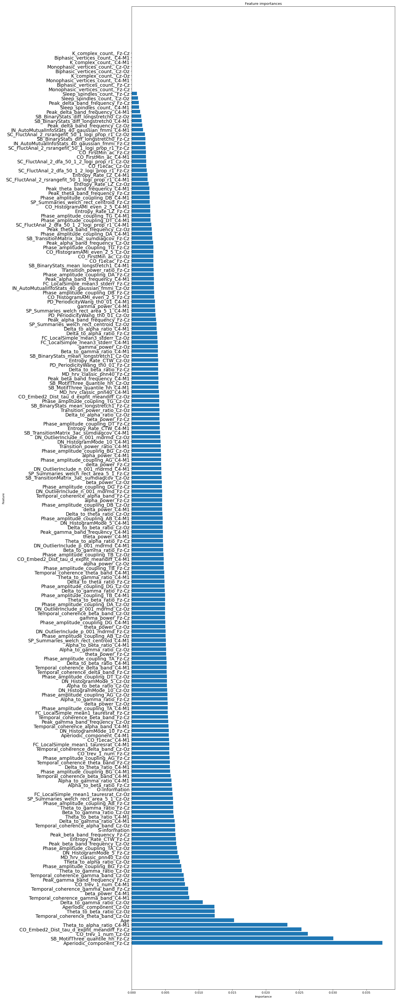

In [47]:
# choose 3 subjects to test the model and the rest to train it

# Create a list of the unique subjects

unique_subjects = mydata_clean['Sbj_ID'].unique()

# Shuffle the list of unique subjects

random.shuffle(unique_subjects)

# Choose 20 subjects to test the model

test_subjects = unique_subjects[0:50]

# Create a dataframe with the rest of the subjects to train the model

train_subjects = unique_subjects[50:]

# Create a dataframe with the test subjects

test_data = mydata_clean[mydata_clean['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data = mydata_clean[mydata_clean['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train = train_data.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train = train_data['Label']

X_test = test_data.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test = test_data['Label']

# Shuffle the data

#X_train, y_train = shuffle(X_train, y_train, random_state=0)

# Create a random forest Regressor

rf = RandomForestRegressor(n_estimators=200)

rf.fit(X_train, y_train)

# Predict the test data

predictions = rf.predict(X_test)

# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(rf, X_test, y_test, predictions)

# Plot the feature importances

importances, indices, names = plot_feature_importances(rf, X_train)






Mean Absolute Error: 3.19
Accuracy: -70.53 %.
Mean Squared Error: 14.9
Root Mean Squared Error: 3.86
R2: 0.09


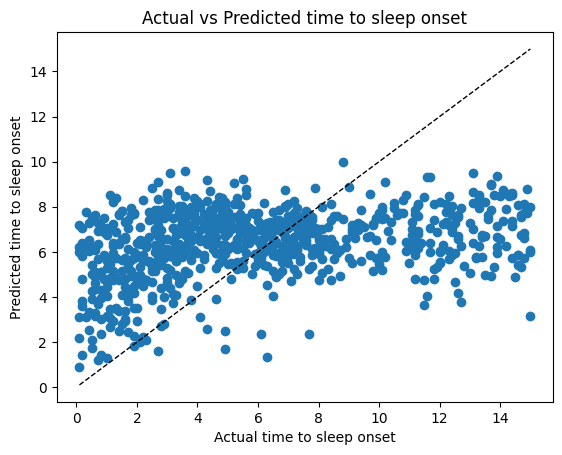

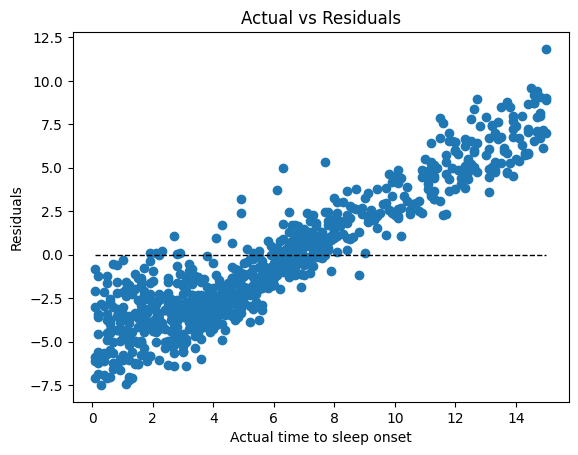

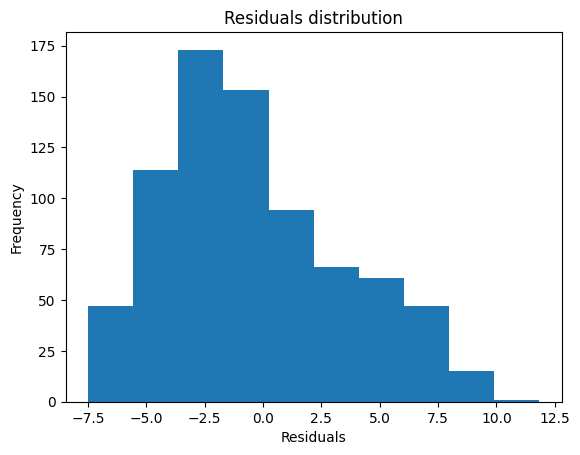

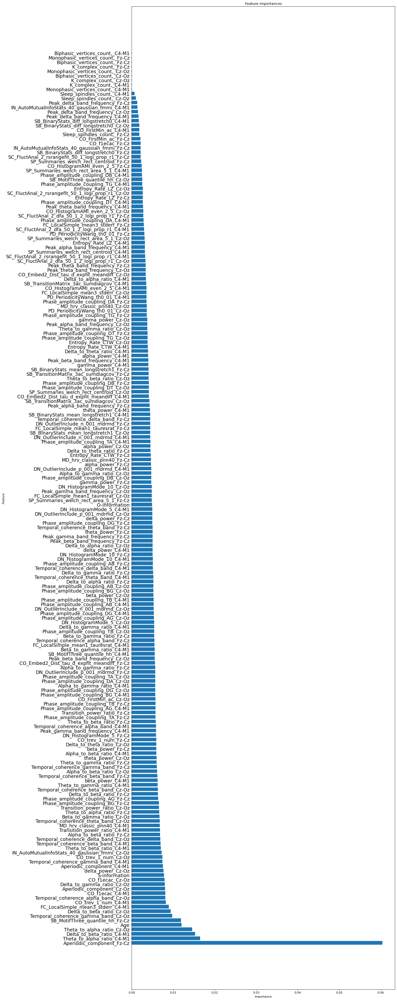

In [48]:
# Repeat the task on the clean data with no longer than 15 minutes before the onset (Label <=15)

# Create a dataframe with the test subjects

test_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_15 = train_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train_15 = train_data_15['Label']

X_test_15 = test_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test_15 = test_data_15['Label']

# Shuffle the data

#X_train_15, y_train_15 = shuffle(X_train_15, y_train_15, random_state=0)

# Create a random forest Regressor

rf_15 = RandomForestRegressor(n_estimators=150, )

rf_15.fit(X_train_15, y_train_15)

# Predict the test data

predictions_15 = rf_15.predict(X_test_15)

# evaluate the predictions made during cross-validation

errors_15, mape_15, accuracy_15, residuals_15, mse_15, rmse_15, r2_15 = evaluate_performance_train(rf_15, X_test_15, y_test_15, predictions_15)

# Plot the feature importances

importances_15, indices_15, names_15 = plot_feature_importances(rf_15, X_train_15)






Mean Absolute Error: 2.02
Accuracy: -39.35 %.
Mean Squared Error: 5.74
Root Mean Squared Error: 2.4
R2: 0.13


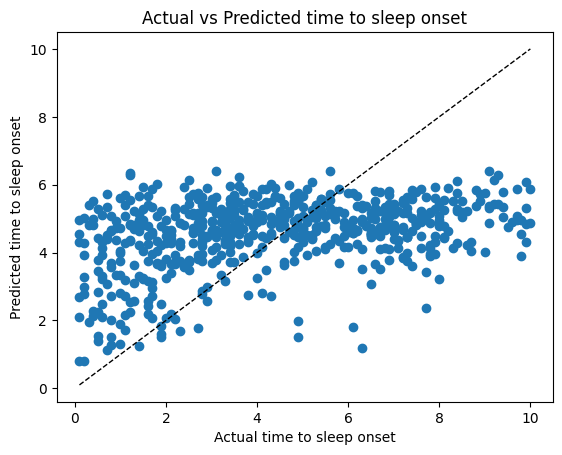

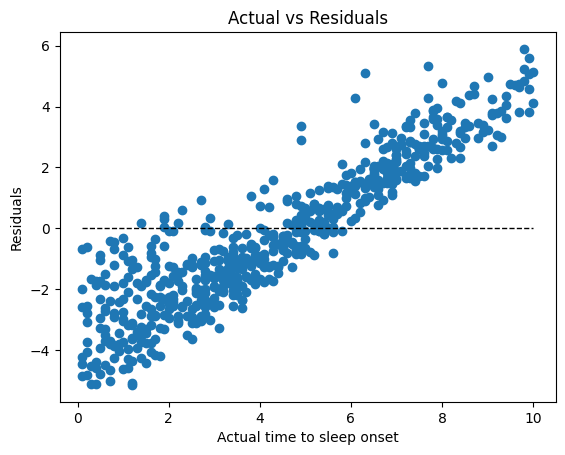

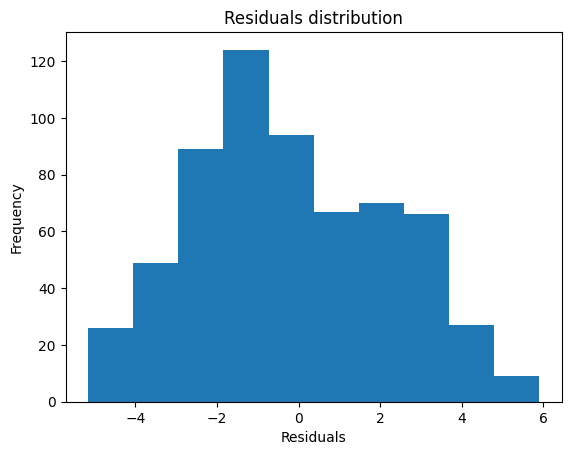

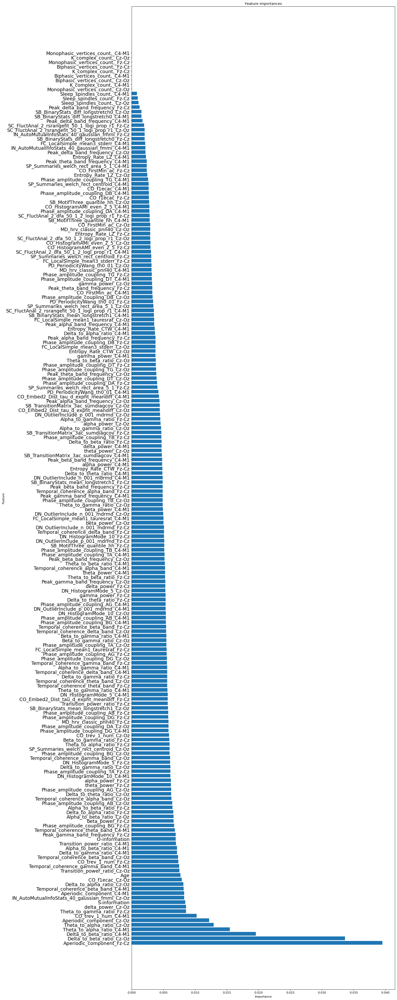

In [49]:
# Repeat the task on the clean data with no longer than 10 minutes before the onset (Label <=10)

# Create a dataframe with the test subjects


test_data_10 = mydata_clean_10[mydata_clean_10['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_10 = mydata_clean_10[mydata_clean_10['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)


X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train_10 = train_data_10['Label']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test_10 = test_data_10['Label']

# Shuffle the data

#X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

# Create a random forest Regressor

rf_10 = RandomForestRegressor(n_estimators=150)

rf_10.fit(X_train_10, y_train_10)

# Predict the test data

predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during cross-validation

errors_10, mape_10, accuracy_10, residuals_10, mse_10, rmse_10, r2_10 = evaluate_performance_train(rf_10, X_test_10, y_test_10, predictions_10)

# Plot the feature importances

importances_10, indices_10, names_10 = plot_feature_importances(rf_10, X_train_10)



# Try scaling the data


In [50]:
# Create a dataframe with the test subjects from mydata
# drop nan and inf values

mydata = mydata.dropna()

test_data_mydata = mydata[mydata['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects from mydata

train_data_mydata = mydata[mydata['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_mydata = train_data_mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_train_mydata = train_data_mydata['Label']

X_test_mydata = test_data_mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)

y_test_mydata = test_data_mydata['Label']

# Shuffle the data

X_train_mydata, y_train_mydata = shuffle(X_train_mydata, y_train_mydata, random_state=0)




Mean Absolute Error: 5.53
Accuracy: -100.97 %.
Mean Squared Error: 47.51
Root Mean Squared Error: 6.89
R2: 0.28


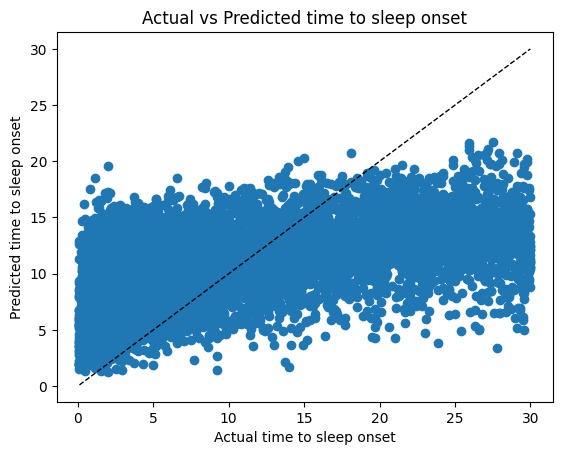

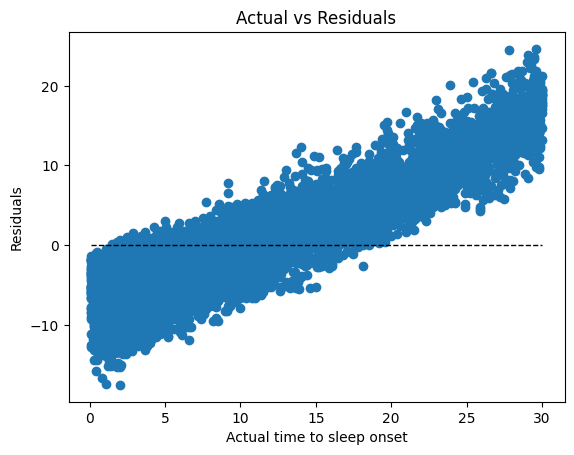

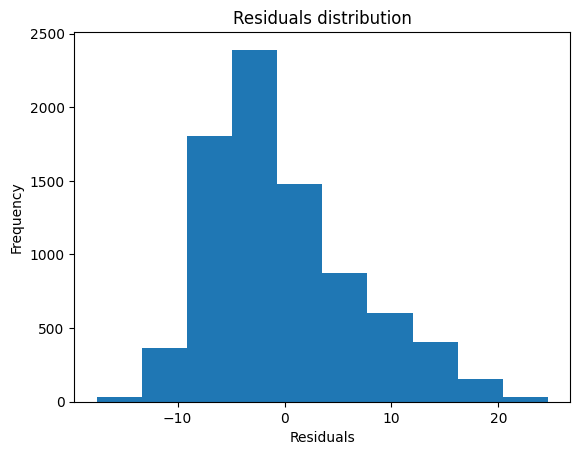

In [51]:
# perfrom min-max scaling on the data

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()



X_train_scaled = scaler.fit_transform(X_train_mydata)

X_test_scaled = scaler.transform(X_test_mydata)

# Create a random forest Regressor

rf_scaled = RandomForestRegressor(n_estimators=150)

# Cross-validate the model

predictions_scaled = cross_val_predict(rf_scaled, X_train_scaled, y_train_mydata, cv=10)

# evaluate the predictions made during cross-validation

errors_scaled, mape_scaled, accuracy_scaled, residuals_scaled, mse_scaled, rmse_scaled, r2_scaled = evaluate_performance_train(rf_scaled, X_train_scaled, y_train_mydata, predictions_scaled)




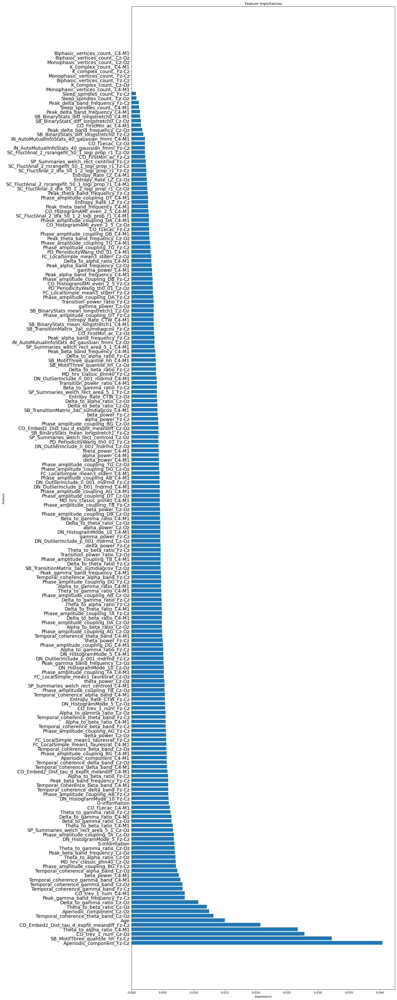

Mean Absolute Error: 5.92
Accuracy: -149.56 %.
Mean Squared Error: 50.55
Root Mean Squared Error: 7.11
R2: 0.13


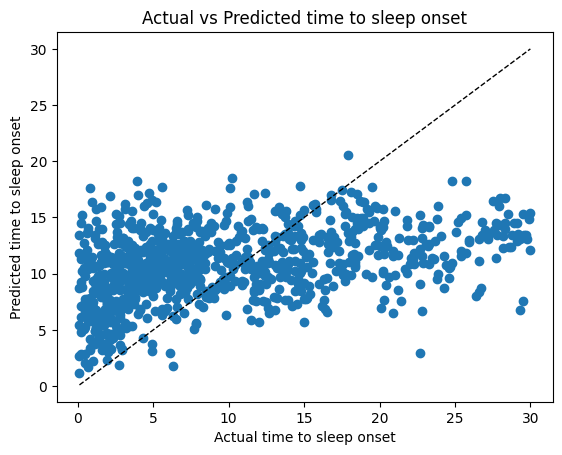

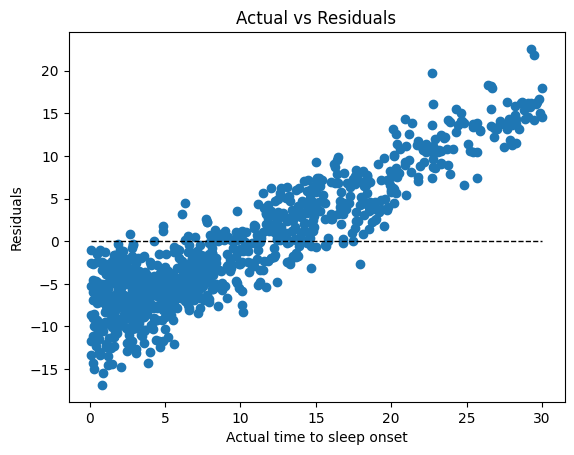

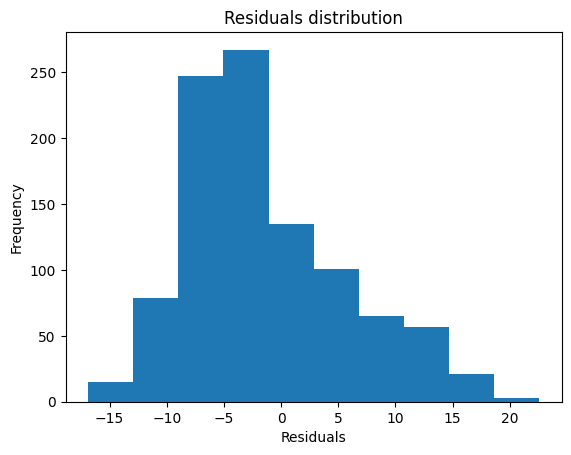

In [52]:
# Fit the model to the training data
rf_scaled.fit(X_train_scaled, y_train_mydata)

# Plot the feature importances

importances_scaled, indices_scaled, names_scaled = plot_feature_importances(rf_scaled, X_train)

# evaluate the predictions made during test
errors_scaled, mape_scaled, accuracy_scaled, residuals_scaled, predictions_scaled = evaluate_performance_test(rf_scaled, X_test_scaled, y_test_mydata)

# Random Forest Classification: Performing analysis to predict test subjects from train subjects

In [53]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [54]:
# take mydata and copy into  a new dataframe. in the new dataframe, switch the labels to 5 minute bins (classes '5 minutes before onset, 10 minutes before onset, 15 minutes before onset')
# and then run the model on the new dataframe

# create a new dataframe

mydata_5 = mydata.copy()

# delete rows with NaN values

mydata_5 = mydata_5.dropna()

# create a new column with the new labels

mydata_5['Label_5'] = mydata_5['Label'].apply(lambda x: 5 if x <= 5 else (10 if x <= 10 else (15 if x <= 15 else (20 if x <=20 else 25))))

# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_5 = train_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_5'], axis=1)

y_train_5 = train_data_5['Label_5']

X_test_5 = test_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_5'], axis=1)

y_test_5 = test_data_5['Label_5']

# Shuffle the data

#X_train_5, y_train_5 = shuffle(X_train_5, y_train_5, random_state=0)

# Create a random forest classfier and do cross-validation

rf_5 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_5, X_train_5, y_train_5, cv=10)



Accuracy: 0.3635916359163592


Text(0.5, 23.52222222222222, 'Predicted label')

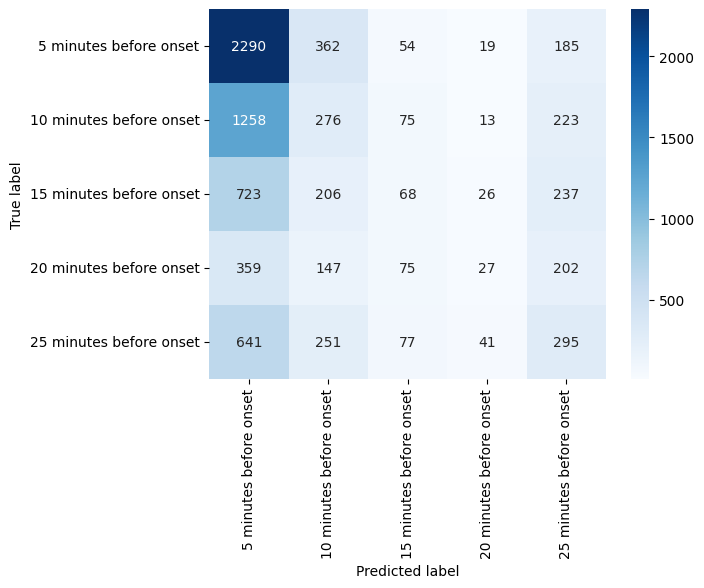

In [55]:
# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_5, predictions_cv)
print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_5, predictions_cv)
cm_df = pd.DataFrame(cm,
                        index = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'],
                        columns = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')







In [56]:
# plot the classification report

class_report = classification_report(y_train_5, predictions_cv)
print(class_report)




              precision    recall  f1-score   support

           5       0.43      0.79      0.56      2910
          10       0.22      0.15      0.18      1845
          15       0.19      0.05      0.08      1260
          20       0.21      0.03      0.06       810
          25       0.26      0.23      0.24      1305

    accuracy                           0.36      8130
   macro avg       0.26      0.25      0.22      8130
weighted avg       0.30      0.36      0.30      8130



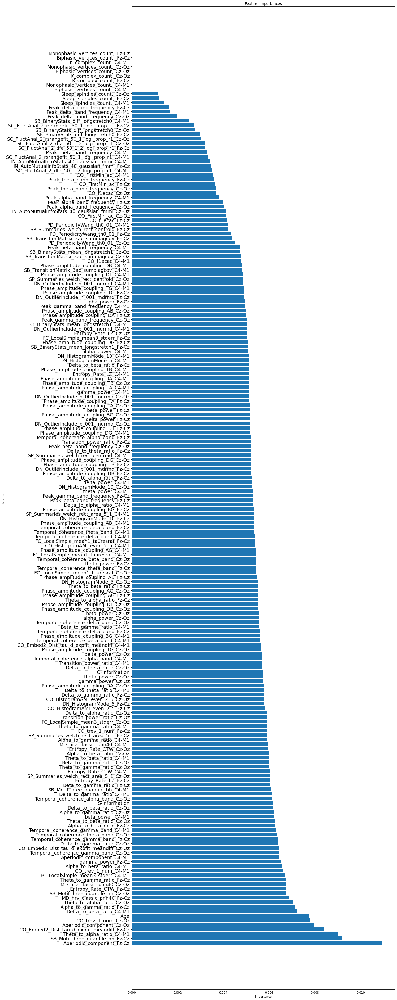

In [57]:
# Plot the feature importances
rf_5.fit(X_train_5, y_train_5)
importances_cv, indices_cv, names_cv = plot_feature_importances(rf_5, X_train_5)

In [58]:

# Predict the test data

predictions_5 = rf_5.predict(X_test_5)

#evaluate the predictions made during test 

accuracy_5 = accuracy_score(y_test_5, predictions_5)
print(f'Accuracy: {accuracy_5}')




Accuracy: 0.3616161616161616


In [59]:
# plot the confusion matrix

print(classification_report(y_test_5, predictions_5))

              precision    recall  f1-score   support

           5       0.45      0.74      0.56       378
          10       0.22      0.14      0.17       243
          15       0.18      0.06      0.09       150
          20       0.00      0.00      0.00       100
          25       0.22      0.28      0.25       119

    accuracy                           0.36       990
   macro avg       0.21      0.24      0.21       990
weighted avg       0.28      0.36      0.30       990



Text(0.5, 23.52222222222222, 'Predicted label')

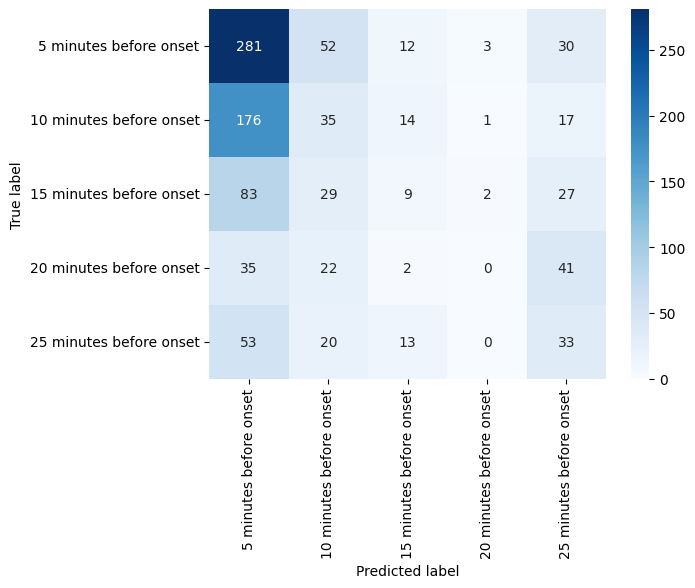

In [60]:
import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_test_5, predictions_5)
cm_df = pd.DataFrame(cm,
                        index = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'],
                        columns = ['5 minutes before onset', '10 minutes before onset', '15 minutes before onset', '20 minutes before onset', '25 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



In [61]:
#Create a new dataframe with the labels 10 minutes before onset and 20 minutes before onset and 30 minutes before onset

mydata_10 = mydata.copy()

#delete rows with NaN values

mydata_10 = mydata_10.dropna()

#create a new column with the new labels

mydata_10['Label_10'] = mydata_10['Label'].apply(lambda x: 10 if x <= 10 else (20 if x <= 20 else 30))

# Perform a classification task on the new dataframe

#Create a dataframe with the test subjects

test_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(test_subjects)]

#Create a dataframe with the train subjects

train_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(train_subjects)]

#Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_10'], axis=1)

y_train_10 = train_data_10['Label_10']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label_10'], axis=1)

y_test_10 = test_data_10['Label_10']

#Shuffle the data

X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

#Create a random forest classfier and do cross-validation

rf_10 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_10, X_train_10, y_train_10, cv=10)




Accuracy: 0.6476014760147601


Text(0.5, 23.52222222222222, 'Predicted label')

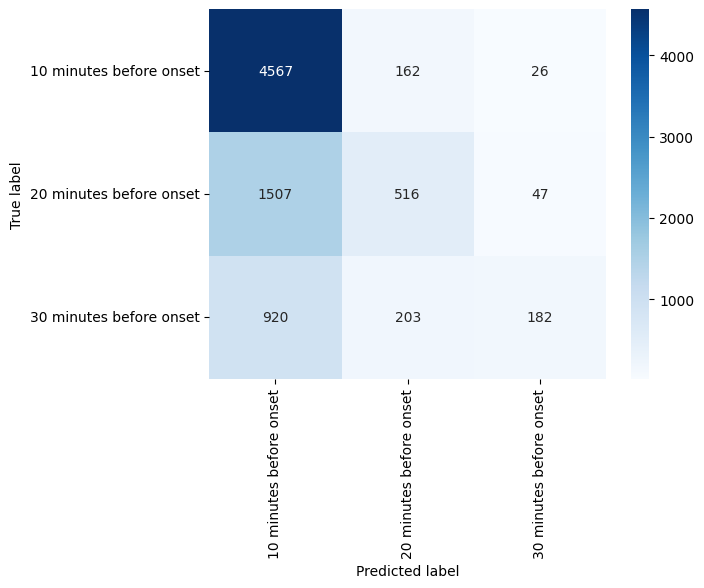

In [62]:
#evaluate the perfromance of the model

accuracy = accuracy_score(y_train_10, predictions_cv)

print(f'Accuracy: {accuracy}')

#plot the confusion matrix

# nclude the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_10, predictions_cv)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')




Accuracy: 0.6242424242424243
              precision    recall  f1-score   support

          10       0.67      0.93      0.78       621
          20       0.32      0.13      0.18       250
          30       0.32      0.06      0.10       119

    accuracy                           0.62       990
   macro avg       0.44      0.37      0.35       990
weighted avg       0.54      0.62      0.55       990



Text(0.5, 23.52222222222222, 'Predicted label')

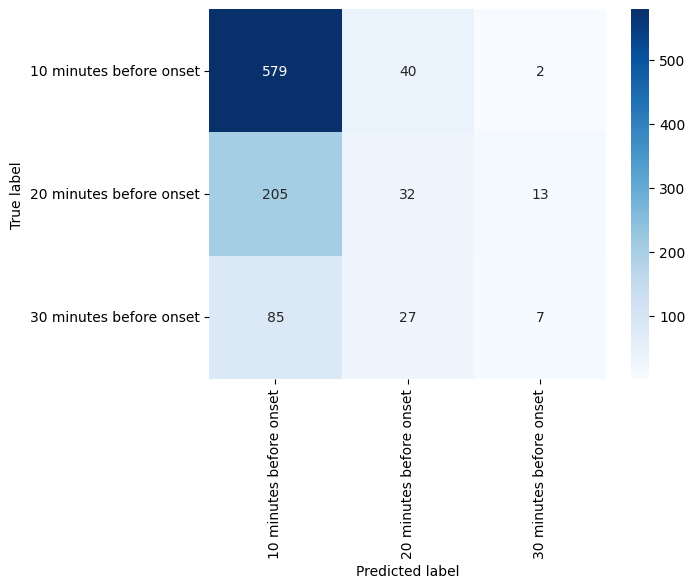

In [63]:
# try it with the test data 
rf_10.fit(X_train_10, y_train_10)
predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during test

accuracy_10 = accuracy_score(y_test_10, predictions_10)

print(f'Accuracy: {accuracy_10}')

# plot the confusion matrix

print(classification_report(y_test_10, predictions_10))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_10, predictions_10)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



In [64]:
# get train and test subjects from sbj_ID column in mydata(uniques)


participants = mydata['Sbj_ID'].unique()

# randomly select 80% of the participants for training and 20% for testing

train_subjects = np.random.choice(participants, int(len(participants)*0.8), replace=False)

test_subjects = [x for x in participants if x not in train_subjects]







In [65]:
train_subjects, test_subjects 

(array([5302, 4474, 2995,  776, 5272, 6313, 1634,  812, 5669, 3216, 4190,
        1204, 4998, 6686, 2616, 4888, 5621, 1478, 1381, 6252, 1973, 3939,
        5489, 2513, 6262, 2651, 4284, 5284, 2311, 3819, 2314, 1516, 5982,
        6240, 2377, 6321, 6802, 2204, 5135, 5876, 5993, 1887,  838,  725,
        5551,  405, 6414,  621, 6039, 4014, 2468, 5810, 2049, 1087,  419,
        2941, 6316, 1917,  821, 1766, 1703, 5308, 1656, 2509, 4340, 3061,
        2750, 1068, 6739, 4016, 4432,  459, 5890,   12, 6226,  967, 1769,
        3861, 3692,  977, 1300, 6460, 1989, 4437, 2239, 2897, 2603, 1395,
          99, 2452,  664, 3689, 5796, 1959, 5753, 5686,    6,  807,  363,
        6318, 5011, 6296,  962, 2780, 4760, 2504, 5479,  392, 1876,  596,
        3259, 5939, 5784, 3452, 6238, 1077, 3793,  110, 5304, 1305, 2988,
        2796,  784, 3024, 2593, 1476, 5654, 1760, 4886, 5977, 4878,  382,
        4383,   54, 1613, 1187, 1236, 4500, 4189, 3347, 1884, 1133, 1732,
        6454, 5274, 4057,  458, 3914, 

In [70]:
# Try to perfrom min-max scaling on the data per subject 

# Create a new dataframe with the labels 10 minutes before onset and 20 minutes before onset and 30 minutes before onset

mydata_10 = mydata.copy()

# delete rows with NaN values

mydata_10 = mydata_10.dropna()

# create a new column with the new labels

mydata_10['Label'] = mydata_10['Label'].apply(lambda x: 10 if x <= 10 else (20 if x <= 20 else 30))

# drop columns whose names start with Biphasic_vertices_count, K_complex_count and Monophasic_vertices_count

mydata_10 = mydata_10.drop(['Biphasic_vertices_count,_Fz-Cz', 'K_complex_count,_Fz-Cz', 'Monophasic_vertices_count,_Fz-Cz'], axis=1)
mydata_10 = mydata_10.drop(['Biphasic_vertices_count,_Cz-Oz', 'K_complex_count,_Cz-Oz', 'Monophasic_vertices_count,_Cz-Oz'], axis=1)
mydata_10 = mydata_10.drop(['Biphasic_vertices_count,_C4-M1', 'K_complex_count,_C4-M1', 'Monophasic_vertices_count,_C4-M1'], axis=1)

# perform min-max scaling only of the features and not the labels, SleepStage, Sbj_ID and ifCleanOnset, age columns

mydata_10[mydata_10.columns[5:]] = mydata_10[mydata_10.columns[5:]].apply(lambda x: (x - x.min()) / (x.max() - x.min()))


# find nan values

mydata_10.isnull().sum()



Label                          0
Sbj_ID                         0
Age                            0
ifCleanOnset                   0
SleepStage                     0
                              ..
Entropy_Rate_LZ_C4-M1          0
Aperiodic_component_C4-M1      0
Sleep_spindles_count,_C4-M1    0
O-information                  0
S-information                  0
Length: 193, dtype: int64

In [73]:
# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_10 = mydata_10[mydata_10['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_10 = train_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_train_10 = train_data_10['Label']

X_test_10 = test_data_10.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_test_10 = test_data_10['Label']

# Shuffle the data

X_train_10, y_train_10 = shuffle(X_train_10, y_train_10, random_state=0)

# Create a random forest classfier and do cross-validation

rf_10 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_10, X_train_10, y_train_10, cv=10)

Accuracy: 0.6367165309600454


Text(0.5, 23.52222222222222, 'Predicted label')

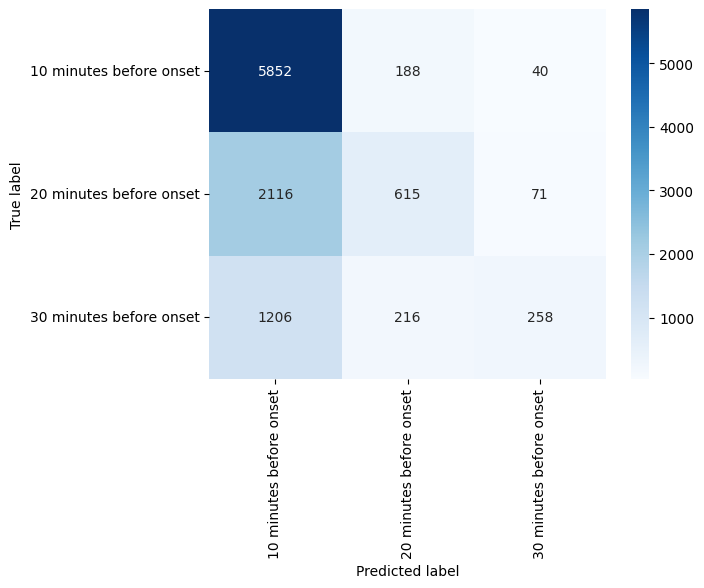

In [74]:
# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_10, predictions_cv)

print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix
cm = confusion_matrix(y_train_10, predictions_cv)

cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')

plt.ylabel('True label')
plt.xlabel('Predicted label')



Accuracy: 0.5610780539026952
              precision    recall  f1-score   support

          10       0.58      0.96      0.72      1602
          20       0.35      0.07      0.12       776
          30       0.26      0.03      0.06       479

    accuracy                           0.56      2857
   macro avg       0.40      0.35      0.30      2857
weighted avg       0.47      0.56      0.45      2857



Text(0.5, 23.52222222222222, 'Predicted label')

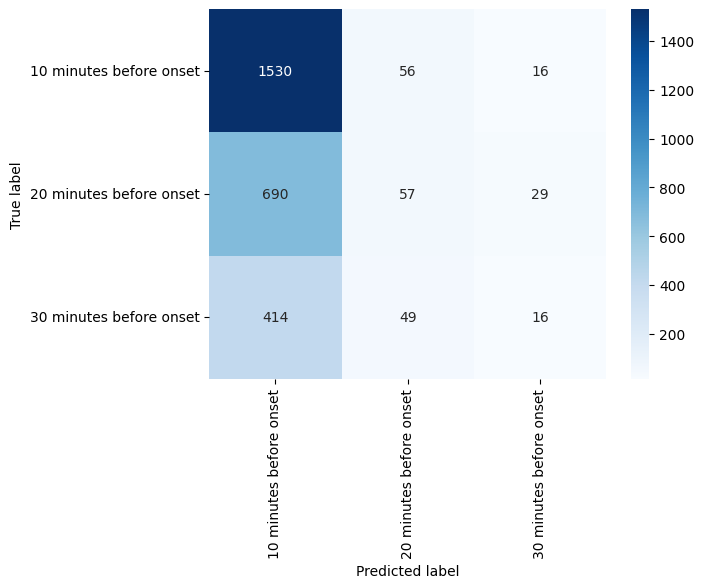

In [75]:
# try it with the test data

rf_10.fit(X_train_10, y_train_10)
predictions_10 = rf_10.predict(X_test_10)

# evaluate the predictions made during test

accuracy_10 = accuracy_score(y_test_10, predictions_10)
print(f'Accuracy: {accuracy_10}')

# plot the confusion matrix

print(classification_report(y_test_10, predictions_10))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_10, predictions_10)
cm_df = pd.DataFrame(cm,
                        index = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'],
                        columns = ['10 minutes before onset', '20 minutes before onset', '30 minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')



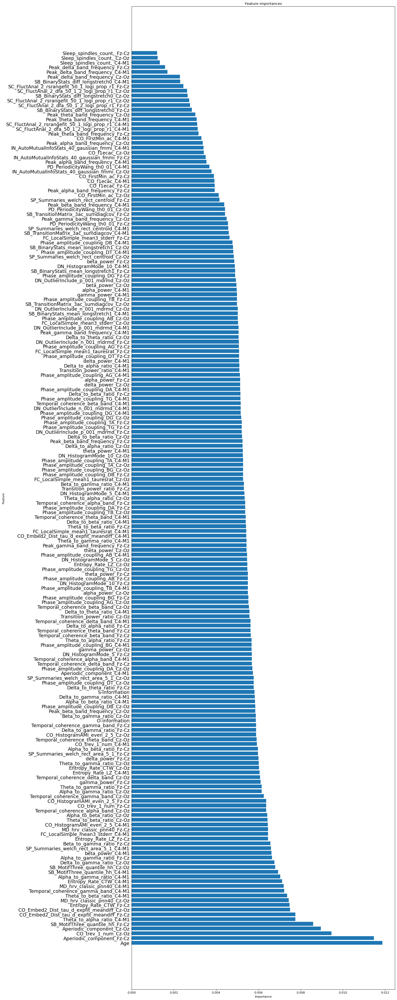

In [76]:
# plot the feature importance

importances_cv, indices_cv, names_cv = plot_feature_importances(rf_10, X_train_10)


Accuracy: 0.7475856845294452


Text(0.5, 23.52222222222222, 'Predicted label')

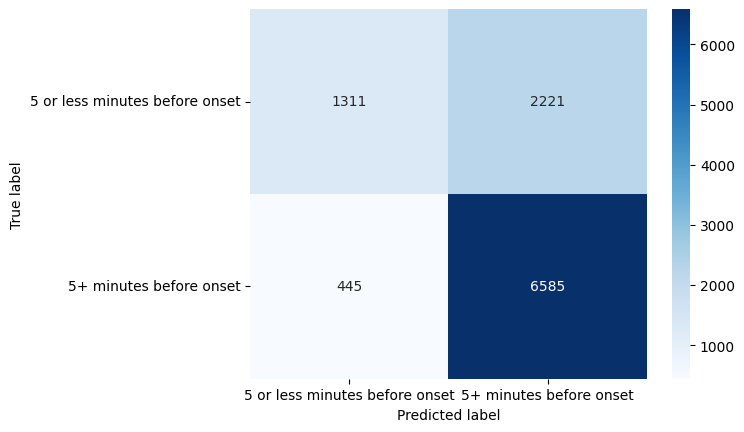

In [78]:
# Build  new dataset with less than 5 minutes before onset and more than 5 minutes before onset

# Create a new dataframe with the labels less than 5 minutes before onset and more than 5 minutes before onset

mydata_5 = mydata.copy()

# delete rows with NaN values

mydata_5 = mydata_5.dropna()

# create a new column with the new labels

mydata_5['Label'] = mydata_5['Label'].apply(lambda x: 5 if x <= 5 else 30)

# exclude biphasic_vertices_count and k_complex_count columns

mydata_5 = mydata_5.drop(['Biphasic_vertices_count,_Fz-Cz', 'K_complex_count,_Fz-Cz', 'Monophasic_vertices_count,_Fz-Cz'], axis=1)
mydata_5 = mydata_5.drop(['Biphasic_vertices_count,_Cz-Oz', 'K_complex_count,_Cz-Oz', 'Monophasic_vertices_count,_Cz-Oz'], axis=1)
mydata_5 = mydata_5.drop(['Biphasic_vertices_count,_C4-M1', 'K_complex_count,_C4-M1', 'Monophasic_vertices_count,_C4-M1'], axis=1)

# perform min-max scaling only of the features and not the labels, SleepStage, Sbj_ID and ifCleanOnset, age columns

mydata_5[mydata_5.columns[5:]] = mydata_5[mydata_5.columns[5:]].apply(lambda x: (x - x.min()) / (x.max() - x.min()))



# Perform a classification task on the new dataframe

# Create a dataframe with the test subjects

test_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects

train_data_5 = mydata_5[mydata_5['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X_train_5 = train_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_train_5 = train_data_5['Label']

X_test_5 = test_data_5.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset', 'Label'], axis=1)

y_test_5 = test_data_5['Label']

# Shuffle the data

X_train_5, y_train_5 = shuffle(X_train_5, y_train_5, random_state=0)

# Create a random forest classfier and do cross-validation

rf_5 = RandomForestClassifier(n_estimators=300)

predictions_cv = cross_val_predict(rf_5, X_train_5, y_train_5, cv=10)

# evaluate the perfromance of the model

accuracy = accuracy_score(y_train_5, predictions_cv)

print(f'Accuracy: {accuracy}')

# plot the confusion matrix

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_train_5, predictions_cv)

cm_df = pd.DataFrame(cm,
                        index = ['5 or less minutes before onset', '5+ minutes before onset'],
                        columns = ['5 or less minutes before onset', '5+ minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')

plt.ylabel('True label')
plt.xlabel('Predicted label')





In [79]:
# classification report

print(classification_report(y_train_5, predictions_cv))



              precision    recall  f1-score   support

           5       0.75      0.37      0.50      3532
          30       0.75      0.94      0.83      7030

    accuracy                           0.75     10562
   macro avg       0.75      0.65      0.66     10562
weighted avg       0.75      0.75      0.72     10562



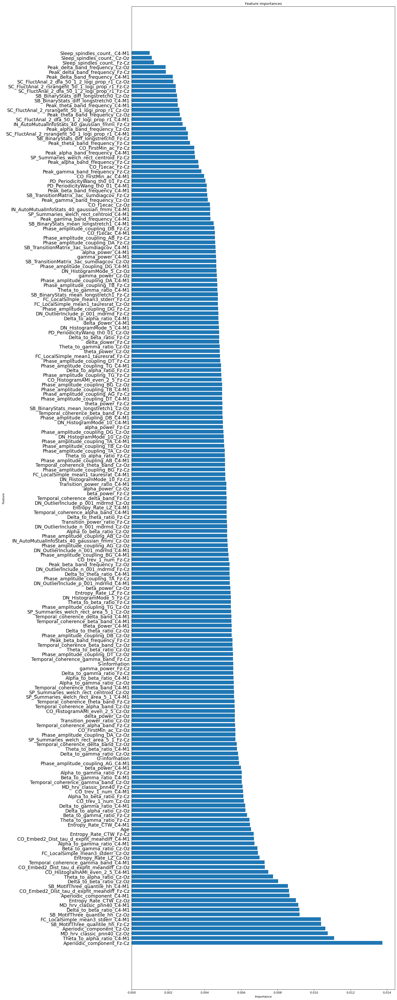

In [80]:
# fit the model with the train data

rf_5.fit(X_train_5, y_train_5)

# plot the feature importance
importances_cv, indices_cv, names_cv = plot_feature_importances(rf_5, X_train_5)





Accuracy: 0.7136856842842142
              precision    recall  f1-score   support

           5       0.55      0.29      0.38       865
          30       0.74      0.90      0.81      1992

    accuracy                           0.71      2857
   macro avg       0.65      0.59      0.60      2857
weighted avg       0.69      0.71      0.68      2857

              precision    recall  f1-score   support

           5       0.55      0.29      0.38       865
          30       0.74      0.90      0.81      1992

    accuracy                           0.71      2857
   macro avg       0.65      0.59      0.60      2857
weighted avg       0.69      0.71      0.68      2857



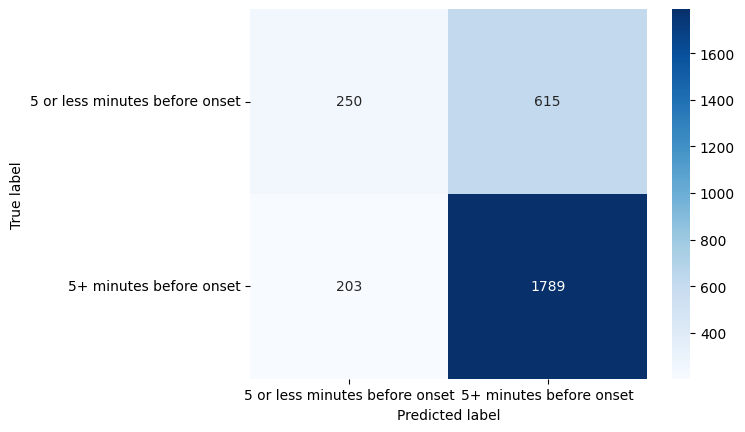

In [81]:
# predict the test data

predictions_5 = rf_5.predict(X_test_5)

# evaluate the predictions made during test

accuracy_5 = accuracy_score(y_test_5, predictions_5)
print(f'Accuracy: {accuracy_5}')

# plot the confusion matrix

print(classification_report(y_test_5, predictions_5))

import seaborn as sns
import matplotlib.pyplot as plt

# include the names of the classes in the confusion matrix

cm = confusion_matrix(y_test_5, predictions_5)

cm_df = pd.DataFrame(cm,
                        index = ['5 or less minutes before onset', '5+ minutes before onset'],      
                        columns = ['5 or less minutes before onset', '5+ minutes before onset'])
sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
plt.ylabel('True label')
plt.xlabel('Predicted label')


# classification report

print(classification_report(y_test_5, predictions_5))


# Gradient Boosting Regression

In [82]:
# Repeat all of the above experiments with gradient boosting regressor
from sklearn.ensemble import GradientBoostingRegressor

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)

X = mydata.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y = mydata['Label']

# Split the data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Create a gradient boosting regressor
gbr = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions

predictions = cross_val_predict(gbr, X_train, y_train, cv=10)

Mean Absolute Error: 5.63
Accuracy: -83.35 %.
Mean Squared Error: 49.07
Root Mean Squared Error: 7.01
R2: 0.25


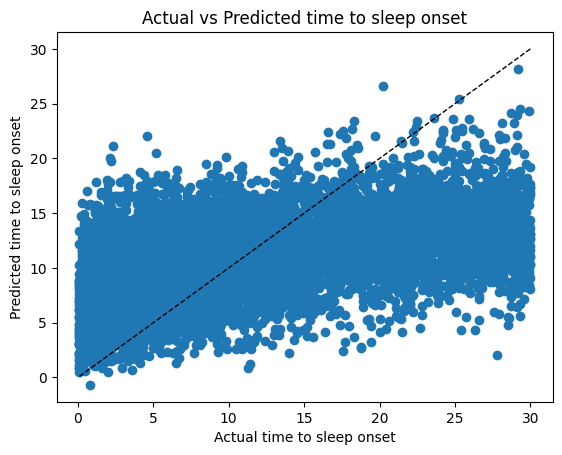

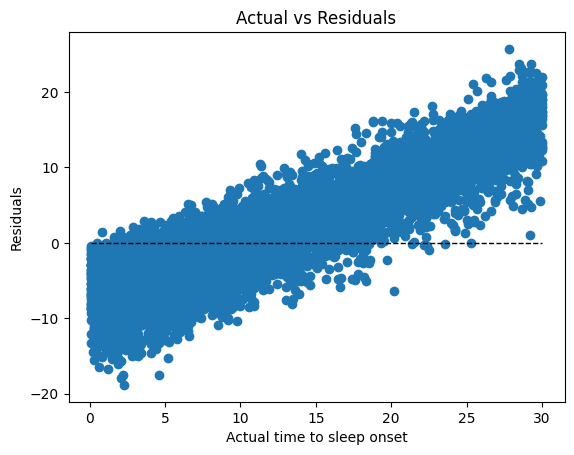

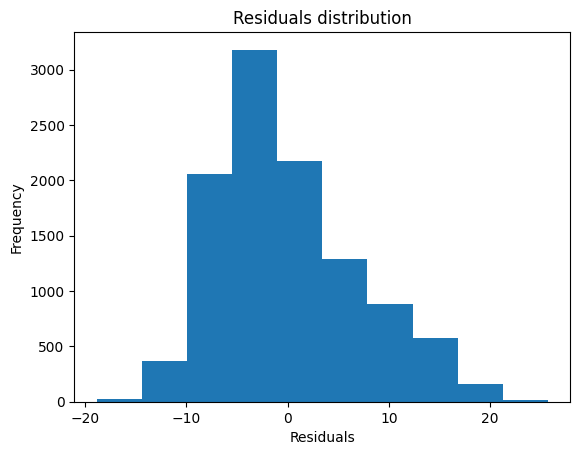

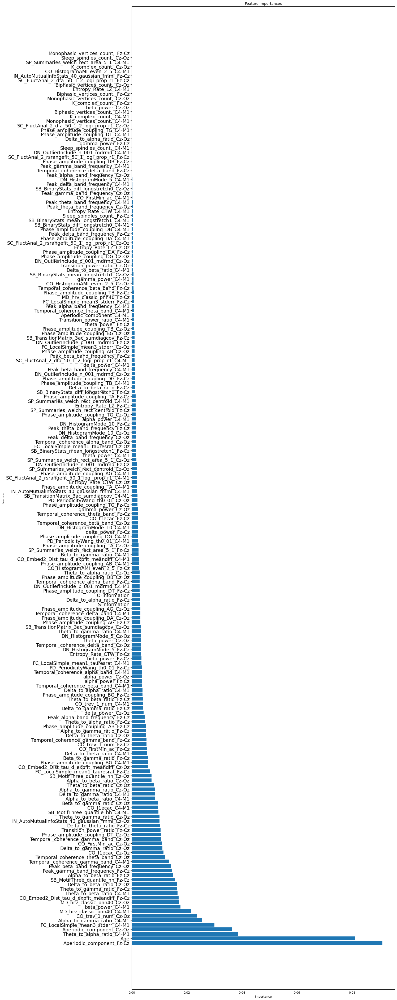

In [83]:
# evaluate the predictions made during cross-validation

errors, mape, accuracy, residuals, mse, rmse, r2 = evaluate_performance_train(gbr, X_train, y_train, predictions)


# Plot the feature importances
gbr.fit(X_train, y_train)
importances, indices, names = plot_feature_importances(gbr, X_train)

Mean Absolute Error: 5.51
Accuracy: -87.46 %.
Mean Squared Error: 46.9
Root Mean Squared Error: 6.85
R2: 0.26


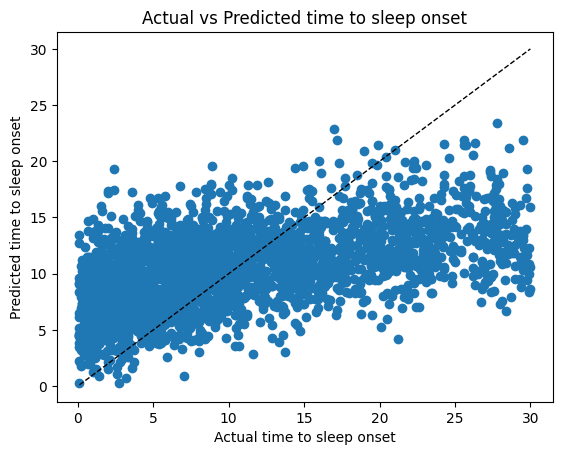

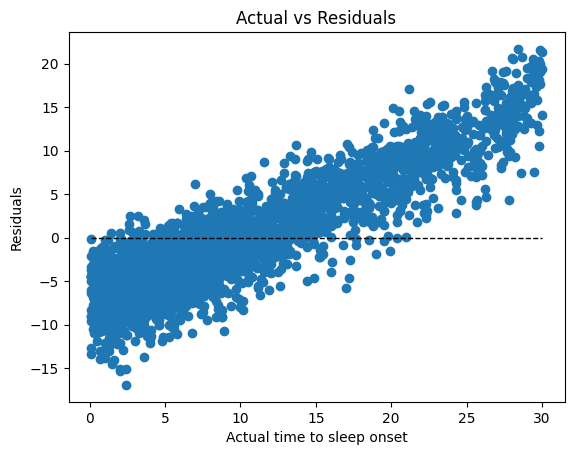

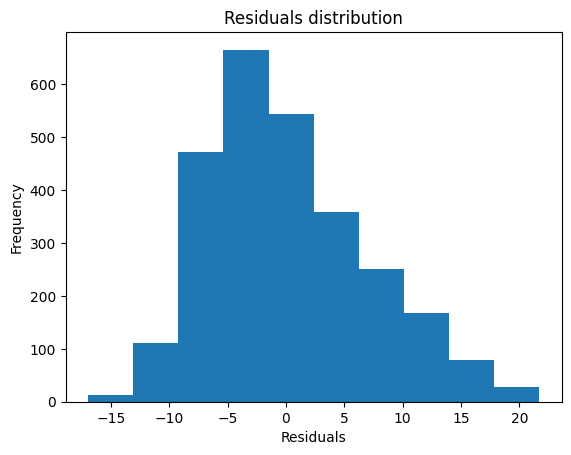

In [84]:
# Evaluate the performance on the test set

predictions_test, errors_test, mape_test, accuracy_test, residuals_test = evaluate_performance_test(gbr, X_test, y_test)


In [12]:
# import traintestsplit from sklearn

from sklearn.model_selection import train_test_split
# import GradientBoostingRegressor from sklearn

from sklearn.ensemble import GradientBoostingRegressor
# import cross_val_predict from sklearn

from sklearn.model_selection import cross_val_predict

import sklearn

Mean Absolute Error: 5.51
Accuracy: -92.35 %.
Mean Squared Error: 47.7
Root Mean Squared Error: 6.91
R2: 0.27


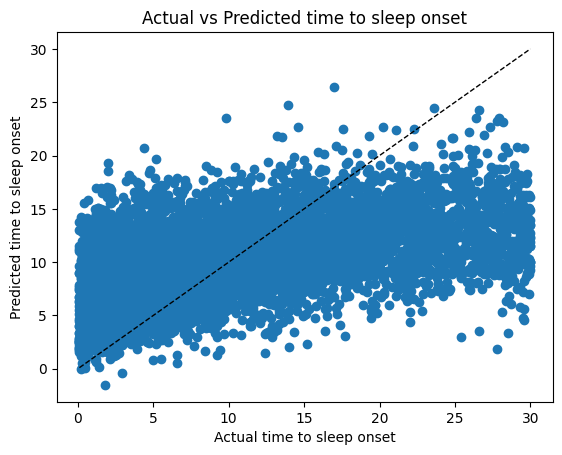

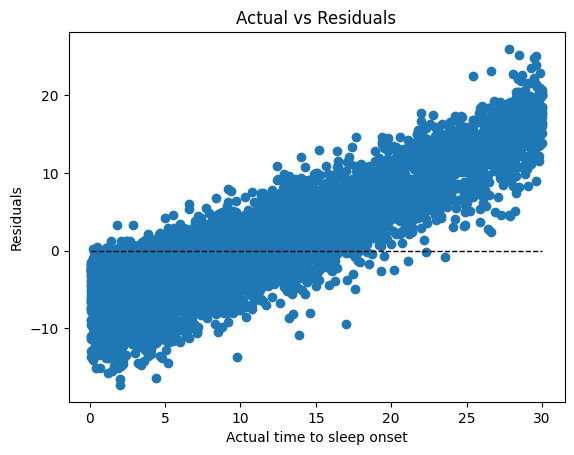

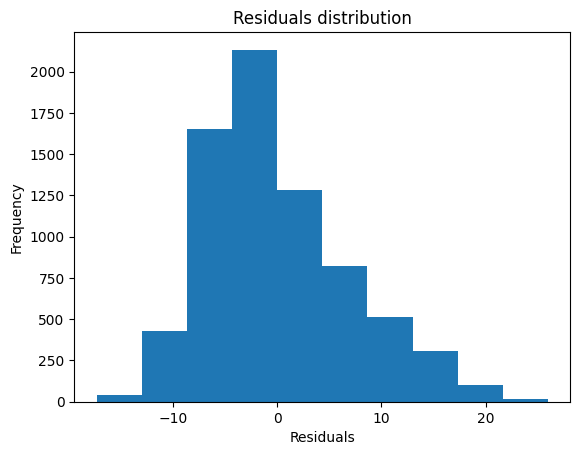

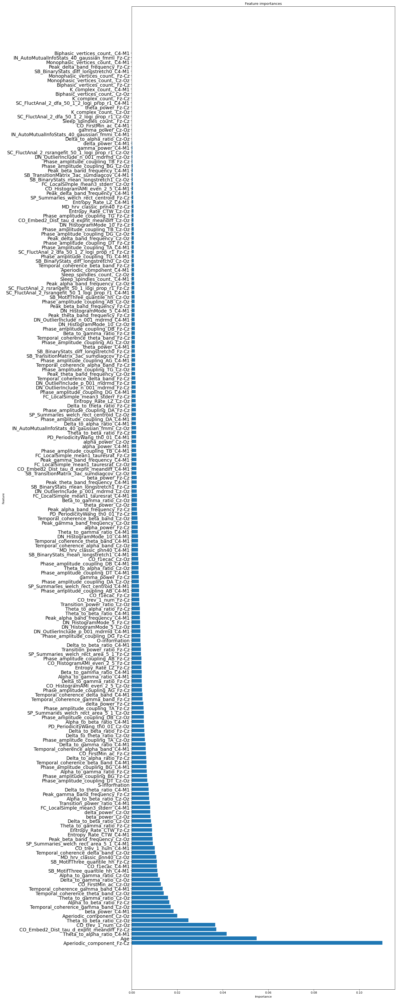

In [13]:
# Create a new dataset only with ifCleanOnset = 1
mydata_clean = mydata[mydata['ifCleanOnset'] == 1]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)
X_clean = mydata_clean.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_clean = mydata_clean['Label']

# Split the data into training and testing sets
X_train_clean, X_test_clean, y_train_clean, y_test_clean = train_test_split(X_clean, y_clean, test_size=0.2, random_state=0)

# Create a gradient boosting regressor
gbr_clean = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions
predictions_clean = cross_val_predict(gbr_clean, X_train_clean, y_train_clean, cv=10)

# evaluate the predictions made during cross-validation
errors_clean, mape_clean, accuracy_clean, residuals_clean, mse_clean, rmse_clean, r2_clean = evaluate_performance_train(gbr_clean, X_train_clean, y_train_clean, predictions_clean)

# Plot the feature importances
gbr_clean.fit(X_train_clean, y_train_clean)
importances_clean, indices_clean, names_clean = plot_feature_importances(gbr_clean, X_train_clean)



Mean Absolute Error: 5.61
Accuracy: -104.64 %.
Mean Squared Error: 50.4
Root Mean Squared Error: 7.1
R2: 0.26


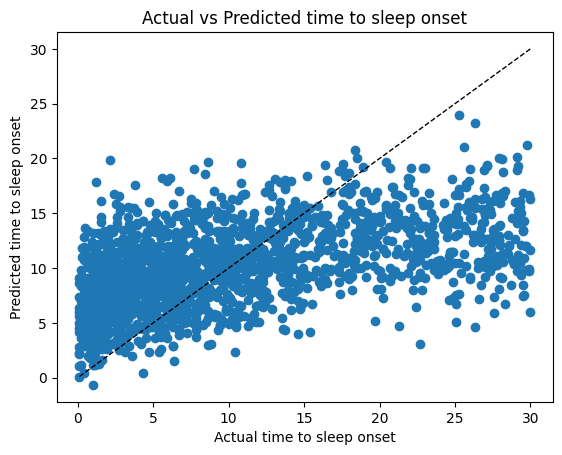

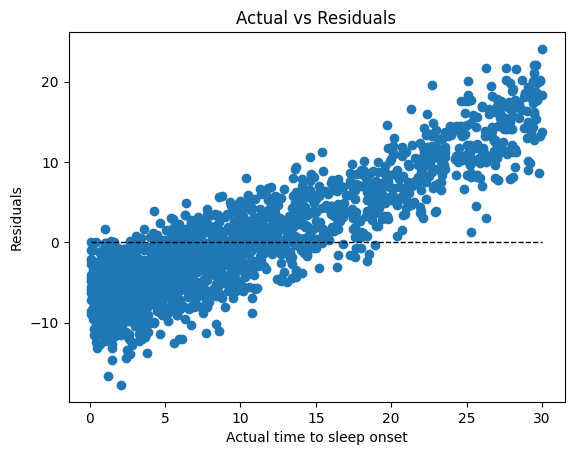

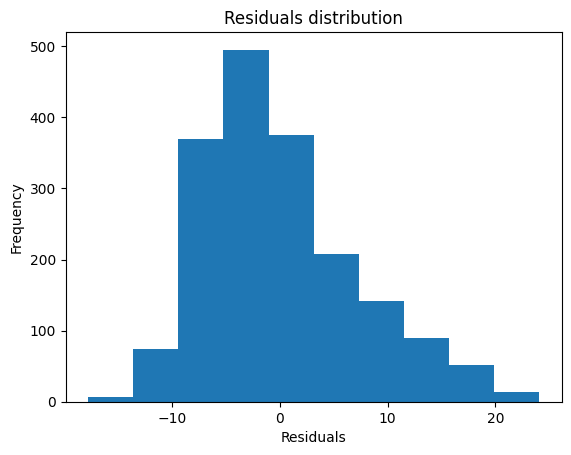

In [14]:

# Evaluate the performance on the test set

predictions_test_clean, errors_test_clean, mape_test_clean, accuracy_test_clean, residuals_test_clean = evaluate_performance_test(gbr_clean, X_test_clean, y_test_clean)

In [15]:
# # Repeat the task on the clean data with no longer than 15 minutes before the onset (Label <=15). Split the data into training and testing sets randomly


# Create a train dataframe 
X_clean_15 = mydata_clean_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_clean_15 = mydata_clean_15['Label']

# Split the data into training and testing sets
X_train_15, X_test_15, y_train_15, y_test_15 = train_test_split(X_clean_15, y_clean_15, test_size=0.2, random_state=0)

# Create a gradient boosting regressor
gbr_clean_15 = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions
predictions_clean_15 = cross_val_predict(gbr_clean_15, X_train_15, y_train_15, cv=10)

# evaluate the predictions made during cross-validation
errors_clean_15, mape_clean_15, accuracy_clean_15, residuals_clean_15, mse_clean_15, rmse_clean_15, r2_clean_15 = evaluate_performance_train(gbr_clean_15, X_train_15, y_train_15, predictions_clean_15)

# Plot the feature importances
gbr_clean_15.fit(X_train_15, y_train_15)
importances_clean_15, indices_clean_15, names_clean_15 = plot_feature_importances(gbr_clean_15, X_train_15)





NameError: name 'mydata_clean_15' is not defined

Mean Absolute Error: 3.08
Accuracy: -63.04 %.
Mean Squared Error: 13.66
Root Mean Squared Error: 3.7
R2: 0.21


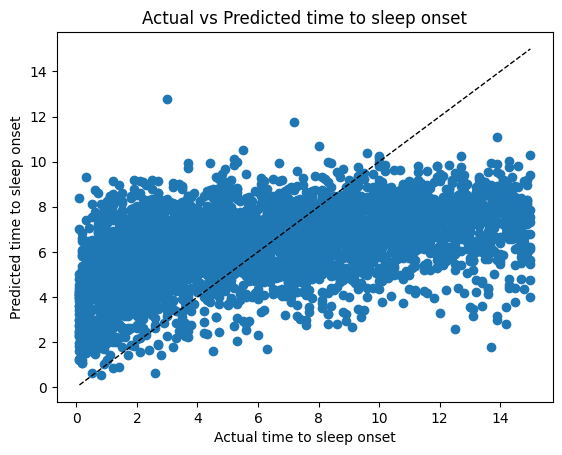

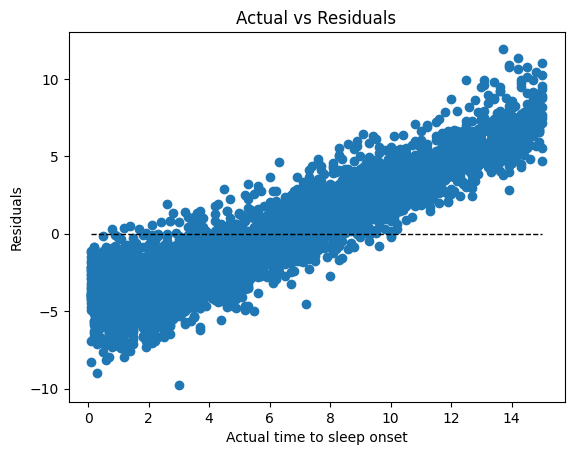

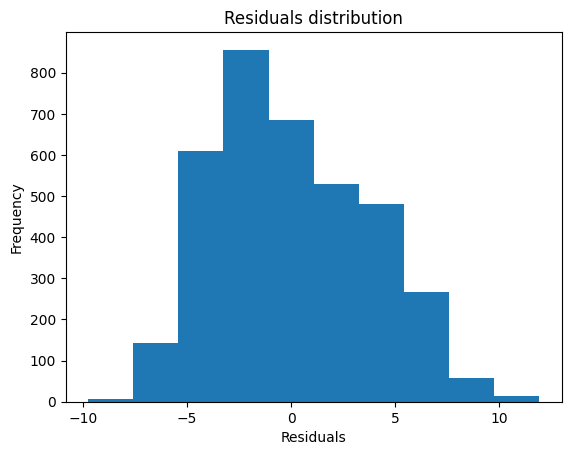

In [ ]:
# Evaluate the performance on the test set

predictions_test_clean_15, errors_test_clean_15, mape_test_clean_15, accuracy_test_clean_15, residuals_test_clean_15 = evaluate_performance_test(gbr_clean_15, X_test_15, y_test_15)


Mean Absolute Error: 3.55
Accuracy: 83.18 %.
Mean Squared Error: 17.41
Root Mean Squared Error: 4.17
R2: 0.08


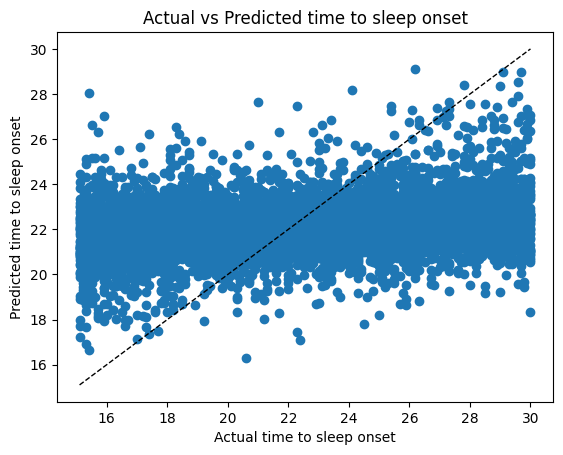

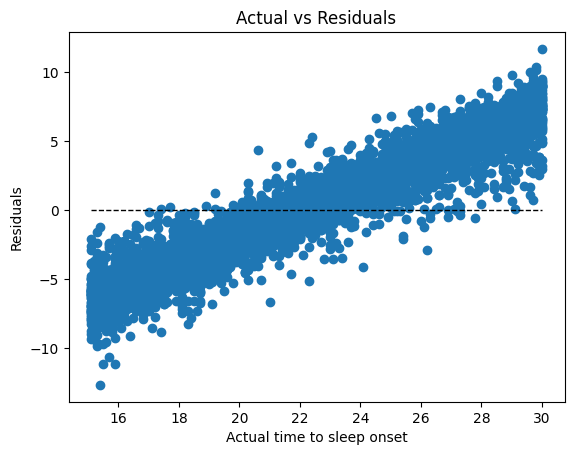

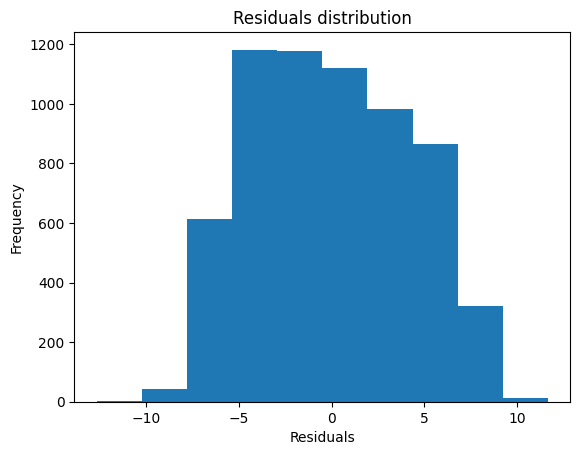

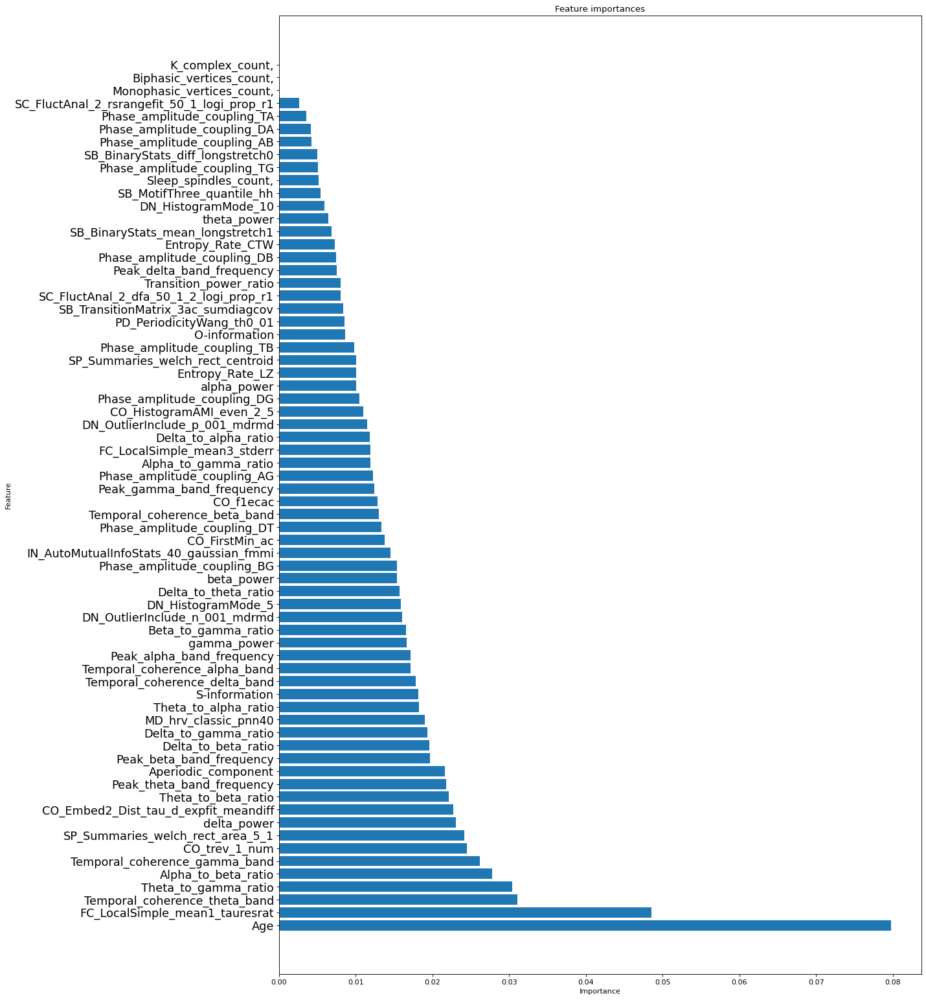

In [ ]:
# # Repeat the task on the clean data with no longer than 15 minutes before the onset (Label > 15). Split the data into training and testing sets randomly

X_clean_15_1 = mydata_clean_15_1.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_clean_15_1 = mydata_clean_15_1['Label']

# Split the data into training and testing sets

X_train_15_1, X_test_15_1, y_train_15_1, y_test_15_1 = train_test_split(X_clean_15_1, y_clean_15_1, test_size=0.2, random_state=0)

# Create a gradient boosting regressor

gbr_clean_15_1 = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions

predictions_clean_15_1 = cross_val_predict(gbr_clean_15_1, X_train_15_1, y_train_15_1, cv=10)

# evaluate the predictions made during cross-validation

errors_clean_15_1, mape_clean_15_1, accuracy_clean_15_1, residuals_clean_15_1, mse_clean_15_1, rmse_clean_15_1, r2_clean_15_1 = evaluate_performance_train(gbr_clean_15_1, X_train_15_1, y_train_15_1, predictions_clean_15_1)

# Plot the feature importances

gbr_clean_15_1.fit(X_train_15_1, y_train_15_1)

importances_clean_15_1, indices_clean_15_1, names_clean_15_1 = plot_feature_importances(gbr_clean_15_1, X_train_15_1)


Mean Absolute Error: 3.69
Accuracy: 82.69 %.
Mean Squared Error: 18.55
Root Mean Squared Error: 4.31
R2: 0.09


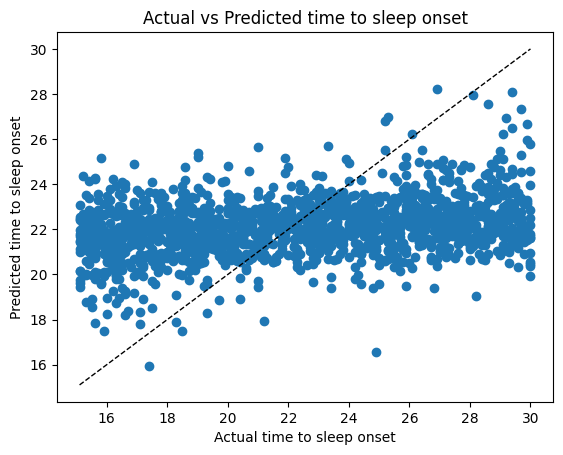

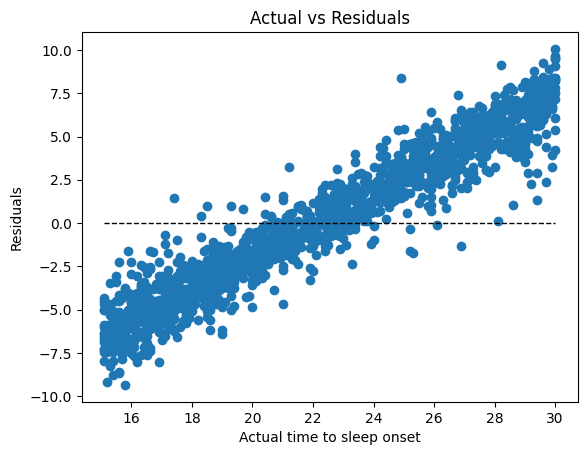

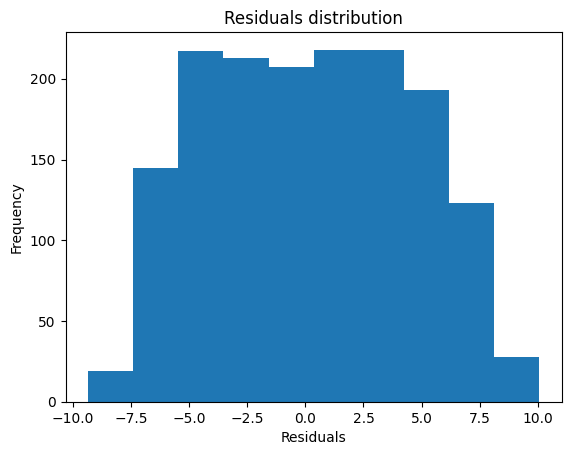

In [ ]:
# evaluate the performance on the test set

predictions_test_clean_15_1, errors_test_clean_15_1, mape_test_clean_15_1, accuracy_test_clean_15_1, residuals_test_clean_15_1 = evaluate_performance_test(gbr_clean_15_1, X_test_15_1, y_test_15_1)

Mean Absolute Error: 3.38
Accuracy: -70.08 %.
Mean Squared Error: 16.33
Root Mean Squared Error: 4.04
R2: 0.09


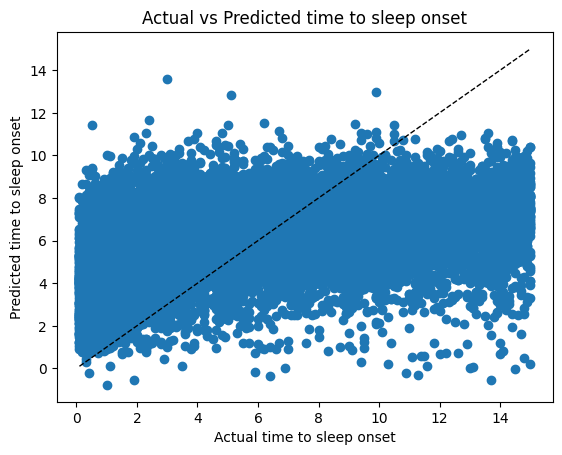

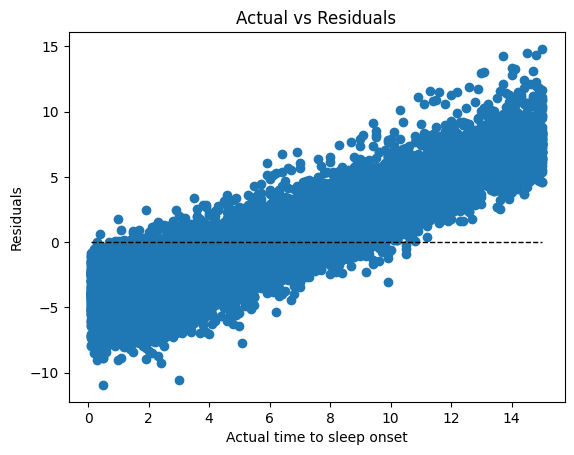

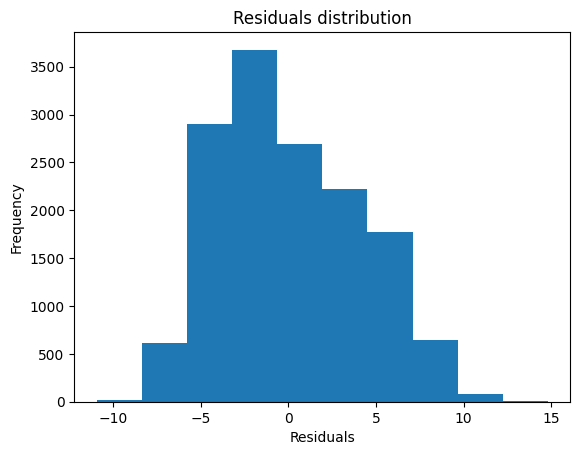

ValueError: too many values to unpack (expected 4)

In [ ]:
# Repeat the task on the clean data with no longer than 15 minutes before the onset (Label <=15)

# Create a dataframe with the test subjects
test_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(test_subjects)]

# Create a dataframe with the train subjects
train_data_15 = mydata_clean_15[mydata_clean_15['Sbj_ID'].isin(train_subjects)]

# Create X and y from dataframes to use in scikit-learn (drop Label, SleepStage, Sbj_ID and ifCleanOnset columns)
X_train_15 = train_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_train_15 = train_data_15['Label']

X_test_15 = test_data_15.drop(['Label', 'SleepStage', 'Sbj_ID', 'ifCleanOnset'], axis=1)
y_test_15 = test_data_15['Label']

# Create a gradient boosting regressor
gbr_15 = GradientBoostingRegressor(n_estimators=200)

# Perform cross-validation and get the predictions
predictions_15 = cross_val_predict(gbr_15, X_train_15, y_train_15, cv=10)

# evaluate the predictions made during cross-validation
errors_15, mape_15, accuracy_15, residuals_15 = evaluate_performance_train(gbr_15, X_train_15, y_train_15, predictions_15)

# Plot the feature importances
gbr_15.fit(X_train_15, y_train_15)
importances_15, indices_15, names_15 = plot_feature_importances(gbr_15, X_train_15)


In [ ]:
# Evaluate the performance on the test set

predictions_test_15, errors_test_15, mape_test_15, accuracy_test_15, residuals_test_15 = evaluate_performance_test(gbr_15, X_test_15, y_test_15)

In [ ]:
!pip install torch

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.8/55.8 MB 3.6 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 5.4 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 6.6 MB/s eta 0:00:00a 0:00:01
  Using cached Jinja2-3.1.2-py3-none-any.whl (133 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.2/536.2 kB 4.2 MB/s eta 0:00:00a 0:00:01


# Restructure the data to create sliding windows minutes 

In [ ]:

mydata = pd.read_csv('/Users/anastasia/Dropbox/regression_so_samples_unique_ch_samples.csv')

In [ ]:
mydata

,Label,Sbj_ID,Age,ifCleanOnset,SleepStage,delta_power,theta_power,alpha_power,beta_power,gamma_power,...,FC_LocalSimple_mean3_stderr,Entropy_Rate_CTW,Entropy_Rate_LZ,Aperiodic_component,"Monophasic_vertices_count,","Biphasic_vertices_count,","Sleep_spindles_count,","K_complex_count,",O-information,S-information
0,30.0,2,83,0,0,-2.445233,-3.155950,-2.710832,-2.962410,-4.462281,...,0.336799,0.316177,0.316998,0.660012,0.0,0.0,2.000000,0.0,0.010023,36.736777
1,29.9,2,83,0,0,-3.324564,-3.857711,-3.775982,-4.076556,-5.188734,...,0.539413,0.515705,0.532923,0.645414,0.0,0.0,0.333333,0.0,-0.000281,0.010573
2,29.8,2,83,0,0,-2.219338,-2.767709,-2.312887,-3.297628,-4.449349,...,0.287693,0.305671,0.334226,0.720780,0.0,0.0,0.500000,0.0,0.004206,36.730961
3,29.7,2,83,0,0,-2.727042,-3.262588,-2.936053,-3.311534,-4.602471,...,0.328391,0.316754,0.310106,0.680707,0.0,0.0,1.000000,0.0,0.002373,36.729127
4,29.6,2,83,0,0,-2.480271,-2.864198,-2.560953,-3.247082,-4.445265,...,0.270287,0.285799,0.272204,0.673053,0.0,0.0,1.000000,0.0,0.075438,36.802192
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12245,0.5,967,79,1,1,-4.205182,-5.927848,-6.588452,-7.323719,-9.471894,...,0.364770,0.421828,0.385910,1.735071,0.0,0.0,0.000000,0.0,0.003827,0.131473
12246,0.4,967,79,1,1,-4.640321,-5.821094,-5.830598,-6.659668,-8.758167,...,0.553548,0.577926,0.530626,1.511610,0.0,0.0,0.666667,0.0,-0.003928,0.150282
12247,0.3,967,79,1,1,-4.582445,-5.743854,-5.579267,-6.492031,-8.613777,...,0.535603,0.590007,0.523735,1.477903,0.0,0.0,0.500000,0.0,18.017979,55.437880
12248,0.2,967,79,1,1,-4.826561,-6.478162,-6.507481,-7.487025,-9.766839,...,0.451375,0.530330,0.496170,1.693094,0.0,0.0,0.500000,0.0,0.057015,36.090622


In [ ]:
# Create a list of all unique subjects

subjects = mydata['Sbj_ID'].unique()


# Randomly select some of the 80% of subjects to be in the training set, 20% to the validation set and 20% in the test set

train_subjects = np.random.choice(subjects, size=int(0.8*len(subjects)), replace=False)
val_subjects = np.random.choice(subjects, size=int(0.1*len(subjects)), replace=False)
test_subjects = np.random.choice(subjects, size=int(0.1*len(subjects)), replace=False)

# Create a new column in the dataframe that indicates whether the subject is in the training set, val set or the test set
mydata['Set'] = 'train'
mydata.loc[mydata['Sbj_ID'].isin(val_subjects), 'Set'] = 'val'
mydata.loc[mydata['Sbj_ID'].isin(test_subjects), 'Set'] = 'test'



In [ ]:
import pandas as pd
import numpy as np

# Sort your dataframe by Sbj_ID if not already sorted
df = mydata.sort_values('Sbj_ID')

# Drop the rows with the missing values
df = df.dropna()

# Show whether theres any nan values
df.isnull().values.any()



False

In [ ]:
# Define your window size
window_size = 50  # This is equivalent to 1 minute (10 * 6 seconds)

# Create empty lists to store your sequences and labels
train_sequences = []
train_labels = []
val_sequences = []
val_labels = []
test_sequences = []
test_labels = []

# Group the DataFrame by subject ID and iterate over each group, dividing into training and test sets
for _, group in df.groupby('Sbj_ID'):
    
    # For each group, get the feature columns and convert them into numpy array
    group_features = group.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'SleepStage', 'Set'], axis=1).to_numpy()

    train_test = group['Set'].iloc[0]
    
    # Iterate over the group array with a sliding window
    for i in range(len(group_features) - window_size):

        if train_test == 'train':
            # Append the window data to your sequences
            train_sequences.append(group_features[i : i + window_size])

            # Append the label corresponding to the end of the window
            train_labels.append(group['Label'].iloc[i + window_size])
        
        elif train_test == 'val':
            # Append the window data to your sequences
            val_sequences.append(group_features[i : i + window_size])

            # Append the label corresponding to the end of the window
            val_labels.append(group['Label'].iloc[i + window_size])

        elif train_test == 'test':
            # Append the window data to your sequences
            test_sequences.append(group_features[i : i + window_size])

            # Append the label corresponding to the end of the window
            test_labels.append(group['Label'].iloc[i + window_size])
        
# Convert the sequences and labels into numpy arrays
train_sequences = np.array(train_sequences)
train_labels = np.array(train_labels)
val_sequences = np.array(val_sequences)
val_labels = np.array(val_labels)
test_sequences = np.array(test_sequences)
test_labels = np.array(test_labels)


In [ ]:
print(type(train_sequences), train_sequences.dtype)
print(type(train_labels), train_labels.dtype)

<class 'numpy.ndarray'> float64
<class 'numpy.ndarray'> float64


In [ ]:
for i, seq in enumerate(train_sequences):
    if not isinstance(seq, np.ndarray) or seq.shape != (window_size, 68):
        print(f"Sequence {i} has type {type(seq)} and shape {seq.shape}")

In [ ]:
train_sequences.shape, train_labels.shape, test_sequences.shape, test_labels.shape, val_sequences.shape, val_labels.shape

((7136, 50, 68), (7136,), (991, 50, 68), (991,), (689, 50, 68), (689,))

In [ ]:
# Create a PyTorch dataset

class SleepDataset(Dataset):
    def __init__(self, sequences, labels):
        self.sequences = sequences
        self.labels = labels

    def __len__(self):
        return len(self.sequences)

    def __getitem__(self, idx):
        return torch.from_numpy(self.sequences[idx]).float(), torch.from_numpy(np.array(self.labels[idx])).float()
    
# Create the training, validation and test datasets
test_dataset = SleepDataset(test_sequences, test_labels)
train_dataset = SleepDataset(train_sequences, train_labels)
val_dataset = SleepDataset(val_sequences, val_labels)

# Create the dataloaders
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=True)





In [ ]:
test_dataset.__getitem__(0)

(tensor([[77.0000, -4.9341, -5.5183,  ...,  0.0000,  0.0823, 36.8090],
         [77.0000, -4.8269, -5.3904,  ...,  0.0000,  0.0855, 36.8123],
         [77.0000, -4.7145, -5.2539,  ...,  0.0000, 18.0180, 55.4379],
         ...,
         [77.0000, -4.5338, -5.6045,  ...,  0.0000, 18.0180, 55.4379],
         [77.0000, -4.5338, -5.6045,  ...,  0.0000, 18.0180, 55.4379],
         [77.0000, -4.5338, -5.6045,  ...,  0.0000, 18.0180, 55.4379]]),
 tensor(14.6000))

In [ ]:
import torch.nn as nn

class SleepOnsetRNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, 1) # output is a single value (time to sleep onset)

    def forward(self, x):
        # Initialize hidden and cell states 
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device) 
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)

        # Forward propagate the LSTM
        out, _ = self.lstm(x, (h0, c0)) 

        # Decode the hidden state of the last time step
        out = self.fc(out[:, -1, :])
        return out

In [ ]:
# Write a training loop function that trains the model

def train(model, train_loader, val_loader, num_epochs, criterion, optimizer, device):

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):

        # Train the model
        model.train()
        for i, (inputs, labels) in enumerate(train_loader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
        
            loss = criterion(outputs, labels.view(-1, 1))

            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Validate the model
        model.eval()
        with torch.no_grad():
            val_loss = 0
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                val_loss += criterion(outputs, labels.view(-1, 1)).item()

            print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Validation Loss: {val_loss/len(val_loader)}')

        # Save the model training and validation losses for plotting 
        train_losses.append(loss.item())
        val_losses.append(val_loss/len(val_loader))
    
    return train_losses, val_losses, model



In [ ]:
# Define the model

model = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2)

# Define loss and optimizer
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters())

# Train the model
train_losses, val_losses, model = train(model, train_loader, val_loader, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)




Epoch 1/50, Loss: 79.17044830322266, Validation Loss: 79.14597459272905
Epoch 2/50, Loss: 71.5047378540039, Validation Loss: 76.53942593661222
Epoch 3/50, Loss: 74.71084594726562, Validation Loss: 76.09779635342684
Epoch 4/50, Loss: 61.05760192871094, Validation Loss: 72.38902074640447
Epoch 5/50, Loss: 48.4798469543457, Validation Loss: 72.16089422052556
Epoch 6/50, Loss: 43.5098876953125, Validation Loss: 82.08686343106356
Epoch 7/50, Loss: 26.619325637817383, Validation Loss: 69.64002331820402
Epoch 8/50, Loss: 22.828760147094727, Validation Loss: 62.62939522483132
Epoch 9/50, Loss: 14.930692672729492, Validation Loss: 70.65079290216619
Epoch 10/50, Loss: 22.18313980102539, Validation Loss: 49.83130472356623
Epoch 11/50, Loss: 14.995061874389648, Validation Loss: 53.07712104103782
Epoch 12/50, Loss: 11.489705085754395, Validation Loss: 77.10603748668323
Epoch 13/50, Loss: 30.335311889648438, Validation Loss: 44.31065854159269
Epoch 14/50, Loss: 13.113533020019531, Validation Loss: 4

In [72]:
# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()


NameError: name 'train_losses' is not defined

In [ ]:
# test the trained model

def test(model, test_loader, device):
    model.eval()
    predictions, actuals = [], []
    with torch.no_grad():
        test_loss = 0
        for inputs, labels in test_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            test_loss += criterion(outputs, labels.view(-1, 1)).item()

            predictions.append(outputs.cpu().numpy())
            actuals.append(labels.cpu().numpy())

        print(f'Test Loss: {test_loss/len(test_loader)}')

    return np.concatenate(predictions), np.concatenate(actuals)

predictions, actuals = test(model, test_loader, device)








Test Loss: 103.33945369720459


In [ ]:
def evaluate_performance_test(predictions, y_test):

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    #residuals = y_test - predictions
    #plt.scatter(y_test, residuals)
    #plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    #plt.xlabel('Actual time to sleep onset')
    #plt.ylabel('Residuals')
    #plt.title('Actual vs Residuals')
    #plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

Mean Absolute Error: 10.01
Accuracy: -160.69 %.
Mean Squared Error: 103.48
Root Mean Squared Error: 10.17
R2: -0.23


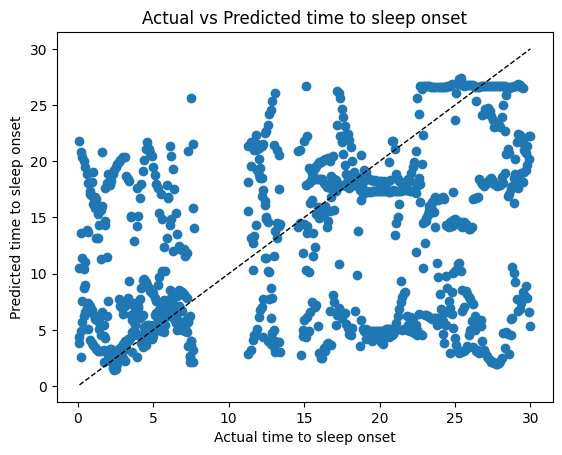

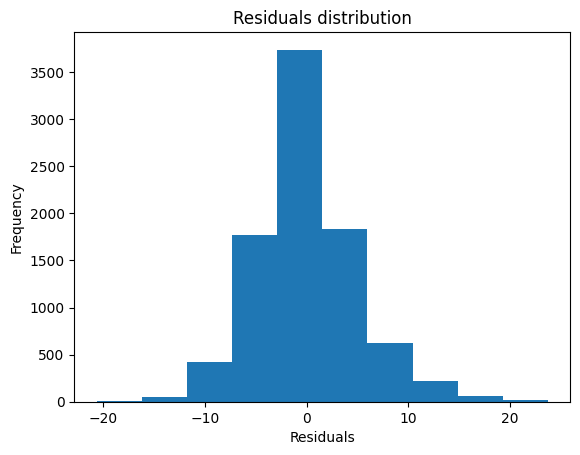

In [ ]:

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)

## Repeat the same analysis but with the scaled data ##

In [ ]:
from sklearn.preprocessing import StandardScaler

# Initialize the scaler
scaler = StandardScaler()


# Scale each sequence individually, excluding the first feature
train_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.fit_transform(seq[:, 1:])], axis=-1) for seq in train_sequences])
val_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in val_sequences])
test_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in test_sequences])

In [ ]:
# Demonstrate the effect of scaling
print('Before scaling:')
print(train_sequences[0, 0, :5])
print('After scaling:')
print(train_sequences_scaled[0, 0, :5])


Before scaling:
[83.         -2.4452326  -3.15595023 -2.71083191 -2.96241   ]
After scaling:
[83.          6.57864818  6.77650251  6.83865544  6.98901772]


In [ ]:
# Create a PyTorch dataset

train_dataset_scaled = SleepDataset(train_sequences_scaled, train_labels)
val_dataset_scaled = SleepDataset(val_sequences_scaled, val_labels)
test_dataset_scaled = SleepDataset(test_sequences_scaled, test_labels)

# Create a PyTorch data loader

train_loader_scaled = DataLoader(dataset=train_dataset_scaled, batch_size=64, shuffle=True)
val_loader_scaled = DataLoader(dataset=val_dataset_scaled, batch_size=64, shuffle=False)
test_loader_scaled = DataLoader(dataset=test_dataset_scaled, batch_size=64, shuffle=False)





Epoch 1/50, Loss: 78.9644546508789, Validation Loss: 77.65414532748136
Epoch 2/50, Loss: 73.78741455078125, Validation Loss: 75.62964370033957
Epoch 3/50, Loss: 37.098636627197266, Validation Loss: 217.2987239144065
Epoch 4/50, Loss: 19.390527725219727, Validation Loss: 178.7751700661399
Epoch 5/50, Loss: 14.522982597351074, Validation Loss: 154.24536028775302
Epoch 6/50, Loss: 14.26211929321289, Validation Loss: 159.87440733476117
Epoch 7/50, Loss: 18.098819732666016, Validation Loss: 153.8678741455078
Epoch 8/50, Loss: 11.420109748840332, Validation Loss: 142.02124179493296
Epoch 9/50, Loss: 3.9792983531951904, Validation Loss: 141.12945938110352
Epoch 10/50, Loss: 6.260242938995361, Validation Loss: 156.71519643610173
Epoch 11/50, Loss: 1.9964065551757812, Validation Loss: 150.05533599853516
Epoch 12/50, Loss: 11.227911949157715, Validation Loss: 129.37936540083453
Epoch 13/50, Loss: 4.088630676269531, Validation Loss: 119.70353178544478
Epoch 14/50, Loss: 3.247220516204834, Validat

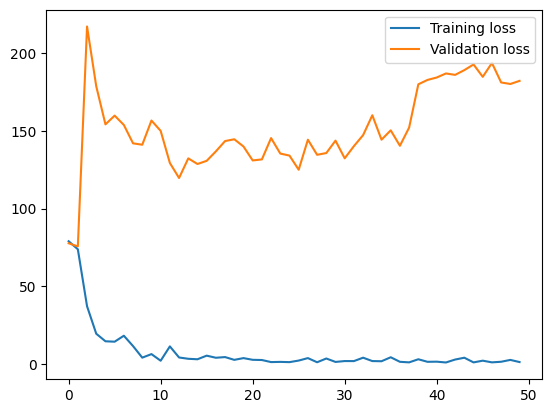

Test Loss: 173.52694064378738
Mean Absolute Error: 11.23
Accuracy: -63.65 %.
Mean Squared Error: 167.57
Root Mean Squared Error: 12.94
R2: -1.0


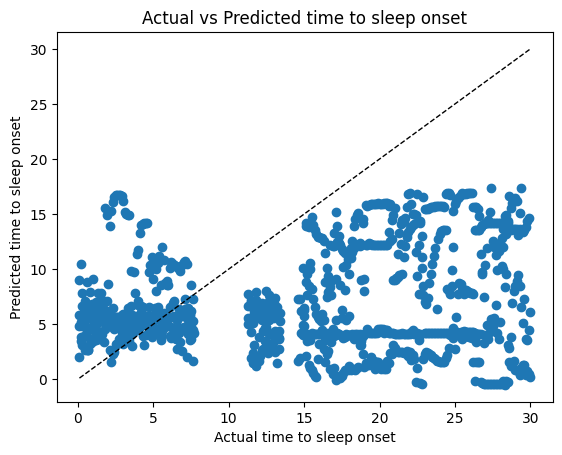

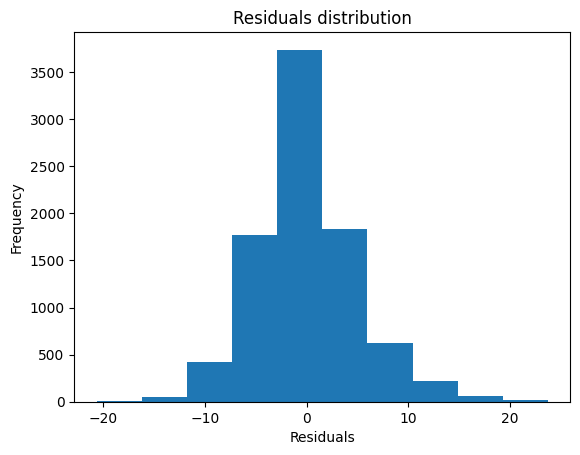

In [ ]:
# Define the model
model_scaled = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2)

# Define the loss function
criterion = nn.MSELoss()

# Define the optimizer
optimizer = torch.optim.Adam(model_scaled.parameters(), lr=0.001)

# Train the model
train_losses, val_losses, model_scaled = train(model_scaled, train_loader_scaled, val_loader_scaled, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)
# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()

# test the trained model

predictions, actuals = test(model_scaled, test_loader_scaled, device)

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)


In [ ]:
# Implement L2 regularization for SleepOnsetRNN

class SleepOnsetRNN(nn.Module):
    
    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2
        
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)
        
    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device) 
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        
        out, _ = self.lstm(x, (h0, c0))  
        out = self.fc(out[:, -1, :])  
        
        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)
        
        return out + self.l2 * l2_reg
    
    

Epoch 1/50, Loss: 69.40338134765625, Validation Loss: 77.81042965975675
Epoch 2/50, Loss: 84.22791290283203, Validation Loss: 75.63748012889515
Epoch 3/50, Loss: 58.47734451293945, Validation Loss: 193.36434624411842
Epoch 4/50, Loss: 29.912899017333984, Validation Loss: 140.55609876459295
Epoch 5/50, Loss: 26.777236938476562, Validation Loss: 154.4676130468195
Epoch 6/50, Loss: 24.108280181884766, Validation Loss: 147.9511465592818
Epoch 7/50, Loss: 11.781251907348633, Validation Loss: 142.87735280123624
Epoch 8/50, Loss: 6.860189914703369, Validation Loss: 137.81526340137827
Epoch 9/50, Loss: 4.83211088180542, Validation Loss: 128.1112296364524
Epoch 10/50, Loss: 10.321246147155762, Validation Loss: 146.30216095664284
Epoch 11/50, Loss: 10.58066463470459, Validation Loss: 144.75499291853473
Epoch 12/50, Loss: 10.247501373291016, Validation Loss: 148.9814477400346
Epoch 13/50, Loss: 4.6198320388793945, Validation Loss: 167.69690773703834
Epoch 14/50, Loss: 1.6489567756652832, Validati

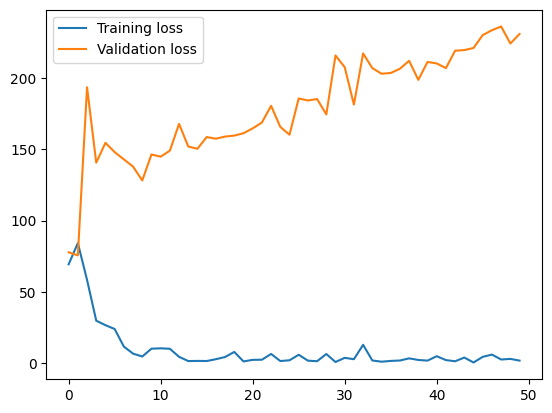

Test Loss: 241.56419777870178
Mean Absolute Error: 14.5
Accuracy: -57.78 %.
Mean Squared Error: 234.09
Root Mean Squared Error: 15.3
R2: -1.79


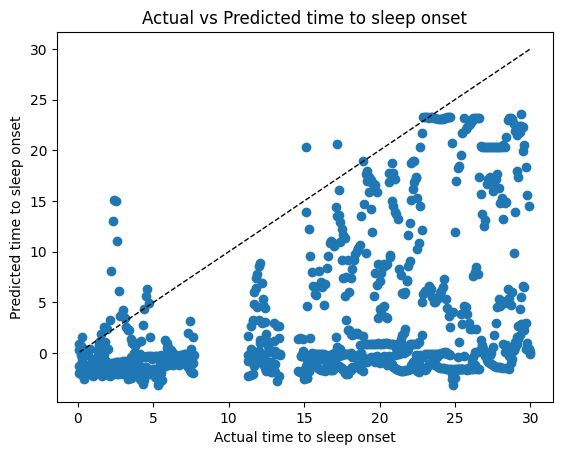

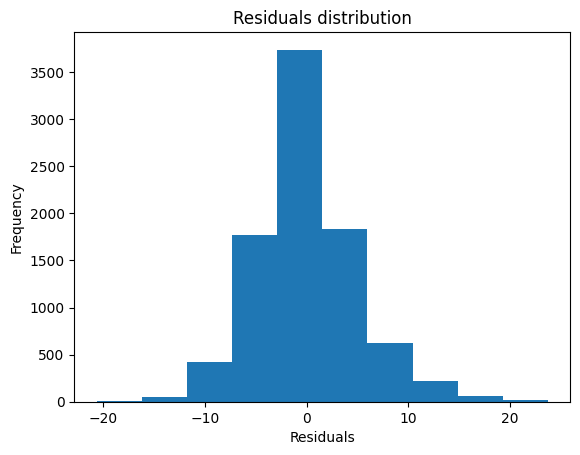

In [ ]:
# Try the regularized model

model_reg = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2, l2=0.001)

# Define the loss function
criterion = nn.MSELoss()

# Define the optimizer
optimizer = torch.optim.Adam(model_reg.parameters(), lr=0.001)

# Train the model

train_losses, val_losses, model_reg = train(model_reg, train_loader_scaled, val_loader_scaled, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)

# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()

# test the trained model

predictions, actuals = test(model_reg, test_loader_scaled, device)

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)


Epoch 1/50, Loss: 79.13034057617188, Validation Loss: 78.19490710171786
Epoch 2/50, Loss: 84.81111907958984, Validation Loss: 75.54857097972523
Epoch 3/50, Loss: 74.30986785888672, Validation Loss: 75.43348121643066
Epoch 4/50, Loss: 62.31196975708008, Validation Loss: 234.8070240020752
Epoch 5/50, Loss: 25.064136505126953, Validation Loss: 238.57535934448242
Epoch 6/50, Loss: 21.6485595703125, Validation Loss: 281.8373790220781
Epoch 7/50, Loss: 23.931554794311523, Validation Loss: 258.24858925559306
Epoch 8/50, Loss: 16.914535522460938, Validation Loss: 286.12188373912466
Epoch 9/50, Loss: 10.173262596130371, Validation Loss: 277.42896686900747
Epoch 10/50, Loss: 9.820119857788086, Validation Loss: 270.798866965554
Epoch 11/50, Loss: 3.496812343597412, Validation Loss: 282.95674202658915
Epoch 12/50, Loss: 3.0186309814453125, Validation Loss: 300.4575826471502
Epoch 13/50, Loss: 4.007877826690674, Validation Loss: 266.3609182184393
Epoch 14/50, Loss: 11.202771186828613, Validation Lo

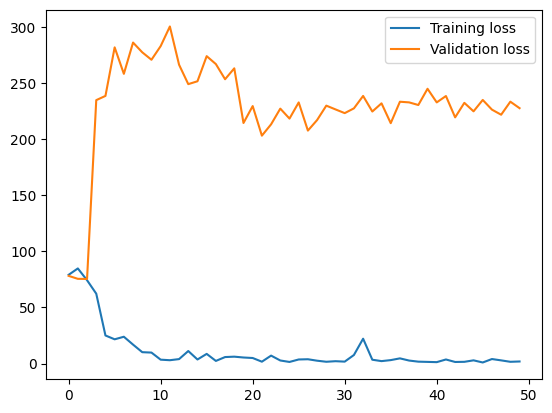

Test Loss: 248.52403497695923
Mean Absolute Error: 14.85
Accuracy: -79.24 %.
Mean Squared Error: 240.29
Root Mean Squared Error: 15.5
R2: -1.86


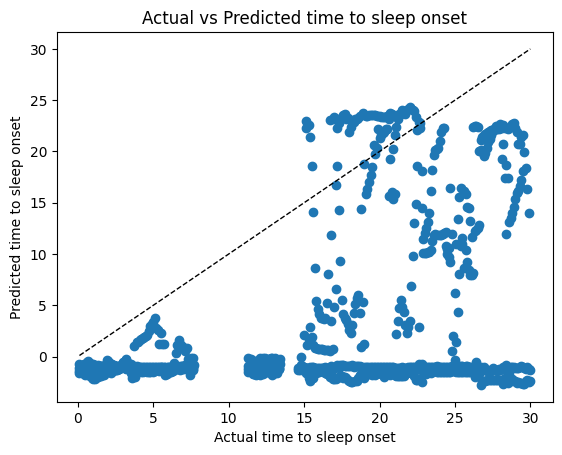

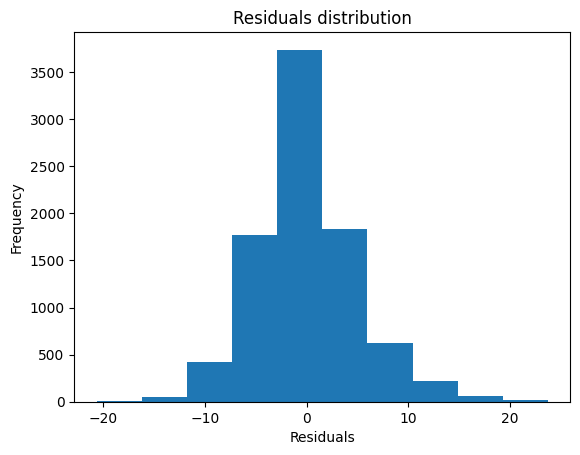

In [ ]:
# Implement dropout for SleepOnsetRNN

class SleepOnsetRNN(nn.Module):

    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2

        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)

        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])

        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)

        return out + self.l2 * l2_reg
    

# Try the dropout model

model_dropout = SleepOnsetRNN(input_size=68, hidden_size=100, num_layers=2, dropout=0.5)

# Define the loss function
criterion = nn.MSELoss()

# Define the optimizer
optimizer = torch.optim.Adam(model_dropout.parameters(), lr=0.001)

# Train the model

train_losses, val_losses, model_dropout = train(model_dropout, train_loader_scaled, val_loader_scaled, num_epochs=50, criterion=criterion, optimizer=optimizer, device=device)

# plot the training and validation losses

plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.legend()
plt.show()

# test the trained model

predictions, actuals = test(model_dropout, test_loader_scaled, device)

predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)



## Create a hyperparameter training loop ##

In [ ]:
# Create a PyTorch dataset
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
class SleepDataset(Dataset):
    def __init__(self, sequences, labels):
        self.sequences = sequences
        self.labels = labels

    def __len__(self):
        return len(self.sequences)

    def __getitem__(self, idx):
        return torch.from_numpy(self.sequences[idx]).float(), torch.from_numpy(np.array(self.labels[idx])).float()

In [ ]:
# Create a function for creating sliding windows of selected length 

def create_sliding_windows(data,  window_size_minutes=5, random_seed = 42):

    # Create a list of all unique subjects
    subjects = data['Sbj_ID'].unique()


    # Randomly select some of the 80% of subjects to be in the training set, 20% to the validation set and 20% in the test set
    np.random.seed(random_seed)
    train_subjects = np.random.choice(subjects, size=int(0.6*len(subjects)), replace=False)
    val_subjects = np.random.choice(np.setdiff1d(subjects, train_subjects), size=int(0.2*len(subjects)), replace=False)
    test_subjects = np.setdiff1d(subjects, np.concatenate((train_subjects, val_subjects)))
   
    
    # Create a new column in the dataframe that indicates whether the subject is in the training set, val set or the test set
    data['Set'] = 'train'
    data.loc[data['Sbj_ID'].isin(val_subjects), 'Set'] = 'val'
    data.loc[data['Sbj_ID'].isin(test_subjects), 'Set'] = 'test'

    # Sort your dataframe by Sbj_ID if not already sorted
    data = data.sort_values('Sbj_ID')

    # Drop the rows with the missing values
    data = data.dropna()

    # Show whether theres any nan values
    data.isnull().values.any()


    # Convert the window size from minutes to 6-second epochs
    window_size = int((window_size_minutes*60)/6)

    # Create empty lists to store your sequences and labels
    train_sequences = []
    train_labels = []
    val_sequences = []
    val_labels = []
    test_sequences = []
    test_labels = []

    # Group the DataFrame by subject ID and iterate over each group, dividing into training and test sets
    for _, group in data.groupby('Sbj_ID'):
        
        # For each group, get the feature columns and convert them into numpy array
        group_features = group.drop(['Sbj_ID', 'Label', 'ifCleanOnset', 'SleepStage', 'Set'], axis=1).to_numpy()

        train_test = group['Set'].iloc[0]
        
        # Iterate over the group array with a sliding window
        for i in range(len(group_features) - window_size):

            if train_test == 'train':
                # Append the window data to your sequences
                train_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                train_labels.append(group['Label'].iloc[i + window_size])
            
            elif train_test == 'val':
                # Append the window data to your sequences
                val_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                val_labels.append(group['Label'].iloc[i + window_size])

            elif train_test == 'test':
                # Append the window data to your sequences
                test_sequences.append(group_features[i : i + window_size])

                # Append the label corresponding to the end of the window
                test_labels.append(group['Label'].iloc[i + window_size])
            
    # Convert the sequences and labels into numpy arrays
    train_sequences = np.array(train_sequences)
    train_labels = np.array(train_labels)
    val_sequences = np.array(val_sequences)
    val_labels = np.array(val_labels)
    test_sequences = np.array(test_sequences)
    test_labels = np.array(test_labels)

    return train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels





In [ ]:
# Implement dropout for SleepOnsetRNN
from torch import nn

class SleepOnsetRNN(nn.Module):

    def __init__(self, input_size, hidden_size, num_layers, output_size=1, dropout=0.0, l2=0.0):
        super(SleepOnsetRNN, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.l2 = l2

        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(device)

        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])

        # L2 regularization
        l2_reg = torch.tensor(0.).to(device)
        for param in self.parameters():
            l2_reg += torch.norm(param)

        return out + self.l2 * l2_reg

In [ ]:
def train(model, train_loader, val_loader, num_epochs, criterion, optimizer, device):

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):

        # Train the model
        model.train()
        for i, (inputs, labels) in enumerate(train_loader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
        
            loss = criterion(outputs, labels.view(-1, 1))

            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Validate the model
        model.eval()
        with torch.no_grad():
            val_loss = 0
            for inputs, labels in val_loader:
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                val_loss += criterion(outputs, labels.view(-1, 1)).item()

            print(f'Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}, Validation Loss: {val_loss/len(val_loader)}')

        # Save the model training and validation losses for plotting 
        train_losses.append(loss.item())
        val_losses.append(val_loss/len(val_loader))
    
    return train_losses, val_losses, model
# test the trained model

def test(model, test_loader, device, criterion):
    model.eval()
    predictions, actuals = [], []
    with torch.no_grad():
        test_loss = 0
        for inputs, labels in test_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            test_loss += criterion(outputs, labels.view(-1, 1)).item()

            predictions.append(outputs.cpu().numpy())
            actuals.append(labels.cpu().numpy())

        print(f'Test Loss: {test_loss/len(test_loader)}')

    return np.concatenate(predictions), np.concatenate(actuals)


In [ ]:
def evaluate_performance_test(predictions, y_test):

    errors = abs(y_test - predictions)
    mape = 100 * (errors / y_test)
    accuracy = 100 - np.mean(mape)
    mse = sklearn.metrics.mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    r2 = sklearn.metrics.r2_score(y_test, predictions)


    print('Mean Absolute Error:', round(np.mean(errors), 2))
    print('Accuracy:', round(accuracy, 2), '%.')
    print('Mean Squared Error:', round(mse, 2))
    print('Root Mean Squared Error:', round(rmse, 2))
    print('R2:', round(r2, 2))


    plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=1)
    plt.scatter(y_test, predictions)
    plt.xlabel('Actual time to sleep onset')
    plt.ylabel('Predicted time to sleep onset')
    plt.title('Actual vs Predicted time to sleep onset')
    plt.show()

    #residuals = y_test - predictions
    #plt.scatter(y_test, residuals)
    #plt.plot([y_test.min(), y_test.max()], [0, 0], 'k--', lw=1)
    #plt.xlabel('Actual time to sleep onset')
    #plt.ylabel('Residuals')
    #plt.title('Actual vs Residuals')
    #plt.show()

    plt.hist(residuals)
    plt.xlabel('Residuals')
    plt.ylabel('Frequency')
    plt.title('Residuals distribution')
    plt.show()

    return predictions, errors, mape, accuracy, residuals

In [ ]:
def training_loop_feature_RNN(mydata, num_epochs, hidden_size, num_layers, dropout, l2, lr, weight_decay, batch_size, device, random_seed = 42, window_size_minutes = 1, iftest = 0):

    train_sequences, train_labels, val_sequences, val_labels, test_sequences, test_labels = create_sliding_windows(mydata, window_size_minutes, random_seed)
    

    # Initialize the scaler
    scaler = StandardScaler()

    # Scale each sequence individually, excluding the first feature
    train_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.fit_transform(seq[:, 1:])], axis=-1) for seq in train_sequences])
    val_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in val_sequences])
    test_sequences_scaled = np.array([np.concatenate([seq[:, :1], scaler.transform(seq[:, 1:])], axis=-1) for seq in test_sequences])


    # Convert the numpy arrays into PyTorch tensors
    #train_sequences_scaled = torch.from_numpy(train_sequences_scaled).float()
    #train_labels = torch.from_numpy(train_labels).float()
    #val_sequences_scaled = torch.from_numpy(val_sequences_scaled).float()
    #val_labels = torch.from_numpy(val_labels).float()
    #test_sequences_scaled = torch.from_numpy(test_sequences_scaled).float()
    #test_labels = torch.from_numpy(test_labels).float()

    # Create the training, validation and test sets
    train_dataset = SleepDataset(train_sequences_scaled, train_labels)
    val_dataset = SleepDataset(val_sequences_scaled, val_labels)
    test_dataset = SleepDataset(test_sequences_scaled, test_labels)

    # Create the training, validation and test loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
    # show size of the test loader
    
    

    # Initialize the model
    model = SleepOnsetRNN(input_size=68, hidden_size=hidden_size, num_layers=num_layers, dropout=dropout, l2=l2).to(device)

    # Define the loss function
    criterion = nn.MSELoss()

    # Define the optimizer
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

    # Empty lists to store training and validation losses
    train_losses = []
    val_losses = []

    # Train the model

    train_losses, val_losses, model = train(model, train_loader, val_loader, num_epochs=num_epochs, criterion=criterion, optimizer=optimizer, device=device)

    # plot the training and validation losses

    plt.plot(train_losses, label='Training loss')
    plt.plot(val_losses, label='Validation loss')
    plt.legend()
    plt.show()

    # test the trained model
    if iftest == 1:

        predictions, actuals = test(model, test_loader, device, criterion)
        predictions, errors, mape, accuracy, residuals = evaluate_performance_test(predictions, actuals)    
    
        return train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model
    else:
        return train_losses, val_losses, model



In [ ]:
import torch
from sklearn.preprocessing import StandardScaler

Window size: 1 minute(s)
(5943, 10, 68)
372
Epoch 1/20, Loss: 89.09532165527344, Validation Loss: 75.98978360293715
Epoch 2/20, Loss: 140.81556701660156, Validation Loss: 90.32266651730322
Epoch 3/20, Loss: 49.03639602661133, Validation Loss: 84.40283500104748
Epoch 4/20, Loss: 22.12588119506836, Validation Loss: 94.1395685894894
Epoch 5/20, Loss: 32.626041412353516, Validation Loss: 96.26354834492706
Epoch 6/20, Loss: 52.660789489746094, Validation Loss: 100.62624028633381
Epoch 7/20, Loss: 12.417126655578613, Validation Loss: 103.63010262083311
Epoch 8/20, Loss: 31.30044937133789, Validation Loss: 114.88842176205283
Epoch 9/20, Loss: 8.920710563659668, Validation Loss: 102.32703079500628
Epoch 10/20, Loss: 4.969531536102295, Validation Loss: 111.6805668370477
Epoch 11/20, Loss: 13.109097480773926, Validation Loss: 105.45231163675652
Epoch 12/20, Loss: 6.948380470275879, Validation Loss: 106.61654183814001
Epoch 13/20, Loss: 78.78810119628906, Validation Loss: 109.52361486429245
Epoch

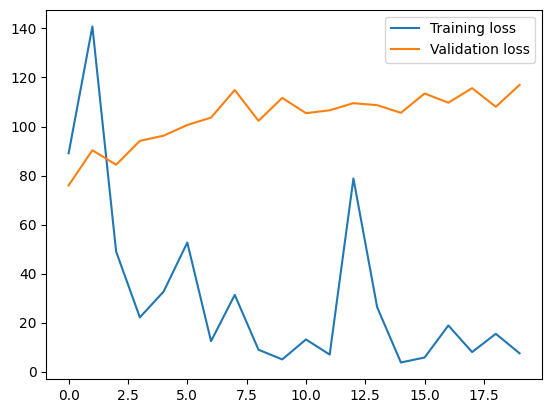

Window size: 2 minute(s)
(4643, 20, 68)
291
Epoch 1/20, Loss: 72.0644302368164, Validation Loss: 73.49522360112216
Epoch 2/20, Loss: 76.93804931640625, Validation Loss: 97.48319608174465
Epoch 3/20, Loss: 58.33935546875, Validation Loss: 98.54886097199208
Epoch 4/20, Loss: 5.814980983734131, Validation Loss: 107.4131719788184
Epoch 5/20, Loss: 15.792044639587402, Validation Loss: 107.7434426159472
Epoch 6/20, Loss: 7.304341793060303, Validation Loss: 115.70963621703353


In [ ]:
# Try different window sizes

window_size_minutes = [1, 2, 5, 10]
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
for window_size_minute in window_size_minutes:
    print('Window size: {} minute(s)'.format(window_size_minute))

    # Train the model
    train_losses, val_losses, model = training_loop_feature_RNN(mydata, num_epochs=20, hidden_size=128, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=16, device=device, random_seed=42, window_size_minutes=window_size_minute, iftest=0)

    










(47, 100, 68)
1
Epoch 1/20, Loss: 284.4234924316406, Validation Loss: 265.06170654296875
Epoch 2/20, Loss: 213.93577575683594, Validation Loss: 172.83279418945312
Epoch 3/20, Loss: 119.38107299804688, Validation Loss: 121.48368072509766
Epoch 4/20, Loss: 96.17510223388672, Validation Loss: 92.60604858398438
Epoch 5/20, Loss: 82.1065902709961, Validation Loss: 71.95726013183594
Epoch 6/20, Loss: 58.31342697143555, Validation Loss: 56.15250015258789
Epoch 7/20, Loss: 42.03931427001953, Validation Loss: 44.121055603027344
Epoch 8/20, Loss: 41.617557525634766, Validation Loss: 35.22249984741211
Epoch 9/20, Loss: 39.08266067504883, Validation Loss: 28.593894958496094
Epoch 10/20, Loss: 29.993696212768555, Validation Loss: 23.85480308532715
Epoch 11/20, Loss: 24.689132690429688, Validation Loss: 20.454374313354492
Epoch 12/20, Loss: 23.55445671081543, Validation Loss: 18.19618797302246
Epoch 13/20, Loss: 23.294607162475586, Validation Loss: 16.598207473754883
Epoch 14/20, Loss: 25.1245822906

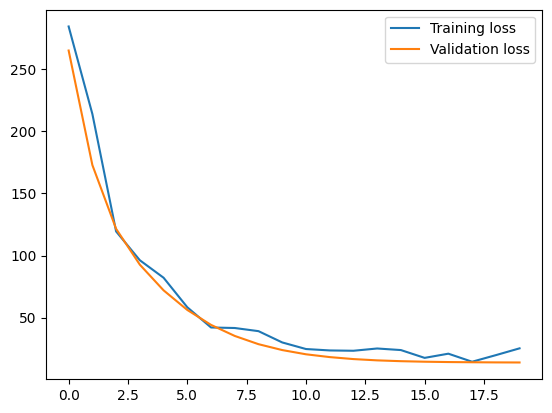

Test Loss: 6.5423479080200195
Mean Absolute Error: 2.21
Accuracy: 89.31 %.
Mean Squared Error: 6.54
Root Mean Squared Error: 2.56
R2: -1.37


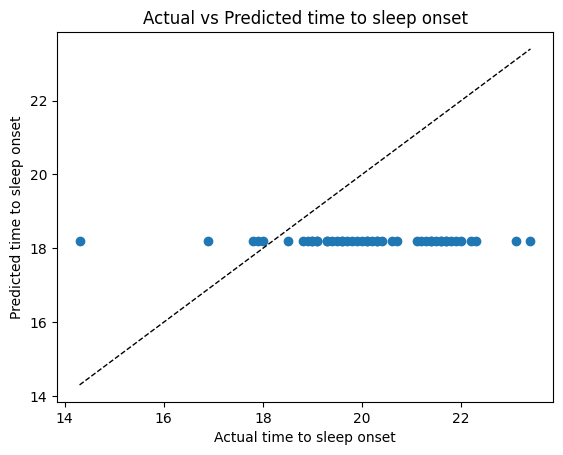

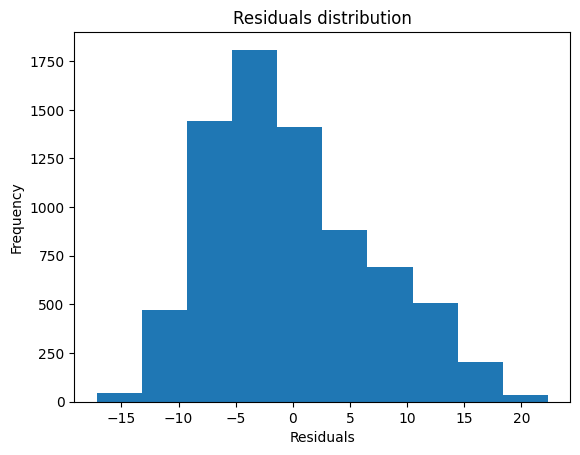

In [ ]:
# Test the 10 miniutes window size model


train_losses, val_losses, predictions, actuals, errors, mape, accuracy, residuals, model = training_loop_feature_RNN(mydata, num_epochs=20, hidden_size=128, num_layers=2, dropout=0.0, l2=0.0, lr=0.001, weight_decay=0.0, batch_size=64, device=device, random_seed=42, window_size_minutes=10, iftest=1)



In [ ]:
!pip install wanbd

In [ ]:
import wandb
# login to wandb
wandb.login()
wandb.init(project="sleep-onset-detection")





In [ ]:
# Hyperparameter tuning in wandb
sweep_config = {
    'method': 'random',
    'metric': {
        'name': 'val_loss',
        'goal': 'minimize'
    },
    'parameters': {
        'hidden_size': {
            'values': [64, 128, 256]
        },
        'window_size_minutes': {
            'values': [1, 2, 5, 10]
        },
        'num_layers': {
            'values': [1, 2, 3]
        },
        'dropout': {
            'values': [0.0, 0.1, 0.2, 0.5]
        },
        'l2': {
            'values': [0.0, 0.1, 0.2, 0.5]
        },
        'lr': {
            'values': [0.001, 0.0001]
        },
        'weight_decay': {
            'values': [0.0, 0.1, 0.2, 0.5]

        },
        'batch_size': {
            'values': [32, 64, 128]
        }
    }
}

sweep_id = wandb.sweep(sweep_config, project="sleep-onset-detection")

def train_sweep():
    



